# Import Modules

In [1]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import shap
#一日分のデータだけをピックアップして、予測を実施する
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, auc, confusion_matrix, roc_auc_score

import gc

In [2]:
from catboost import CatBoostClassifier as clf

In [3]:
train_df = pd.read_parquet('train.parquet')
train_label_df = pd.read_csv('train_labels.csv')
test_df = pd.read_parquet('test.parquet')

In [33]:
sample_submission_df = pd.read_csv('sample_submission.csv')

In [34]:
sample_submission_df

,customer_ID,prediction
0,00000469ba478561f23a92a868bd366de6f6527a684c9a...,0
1,00001bf2e77ff879fab36aa4fac689b9ba411dae63ae39...,0
2,0000210045da4f81e5f122c6bde5c2a617d03eef67f82c...,0
3,00003b41e58ede33b8daf61ab56d9952f17c9ad1c3976c...,0
4,00004b22eaeeeb0ec976890c1d9bfc14fd9427e98c4ee9...,0
...,...,...
924616,ffff952c631f2c911b8a2a8ca56ea6e656309a83d2f64c...,0
924617,ffffcf5df59e5e0bba2a5ac4578a34e2b5aa64a1546cd3...,0
924618,ffffd61f098cc056dbd7d2a21380c4804bbfe60856f475...,0
924619,ffffddef1fc3643ea179c93245b68dca0f36941cd83977...,0


# EDA

## Basic Information of each columns

In [4]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 574116 entries, 0 to 574115
Columns: 190 entries, customer_ID to D_145
dtypes: float64(186), object(4)
memory usage: 832.2+ MB


In [5]:
train_df.describe()

,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,D_43,...,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145
count,569323.000000,5.741160e+05,574116.000000,573908.000000,5.741160e+05,467373.000000,5.739080e+05,5.739080e+05,83712.000000,4.021890e+05,...,2.033700e+04,2.033700e+04,2.033700e+04,5.637850e+05,5.698970e+05,5.637850e+05,98758.000000,5.637850e+05,5.698770e+05,5.637850e+05
mean,0.654700,1.530398e-01,0.124596,0.620364,7.915295e-02,0.226125,6.065146e-02,1.329389e-01,0.183665,1.553467e-01,...,2.489271e-01,1.401077e-02,1.583557e-01,1.801712e-01,2.647286e-02,1.657659e-01,0.391167,1.800613e-01,5.409986e-02,6.096848e-02
std,0.245714,2.695985e-01,0.212407,0.401515,2.263584e-01,0.193577,2.029925e-01,2.354470e-01,0.226531,2.165768e-01,...,2.090466e-01,9.446953e-02,2.630587e-01,3.801230e-01,1.449654e-01,3.494915e-01,0.238671,3.800253e-01,1.872177e-01,1.886653e-01
min,-0.421082,2.358775e-08,-0.899396,0.000002,2.962930e-08,-0.347854,5.627163e-08,9.105321e-08,-0.000454,8.705647e-07,...,6.746572e-07,4.129697e-08,5.864321e-07,6.598718e-08,2.024763e-08,2.320579e-08,-0.014441,1.653580e-08,4.524265e-08,3.397747e-08
25%,0.478045,4.530126e-03,0.008839,0.104100,2.905647e-03,0.127211,2.890701e-03,5.242906e-03,0.036695,4.234181e-02,...,9.765161e-03,2.529872e-03,3.433479e-03,3.035791e-03,2.559618e-03,3.040986e-03,0.196856,3.036854e-03,2.750890e-03,3.030432e-03
50%,0.691944,9.058871e-03,0.031483,0.814286,5.793504e-03,0.163891,5.750757e-03,9.797476e-03,0.121082,8.834127e-02,...,2.542403e-01,5.086230e-03,6.912245e-03,6.060500e-03,5.119914e-03,6.066925e-03,0.381210,6.069340e-03,5.512363e-03,6.050816e-03
75%,0.864626,2.364105e-01,0.127613,1.002352,8.667296e-03,0.258816,8.633223e-03,1.560955e-01,0.251253,1.845469e-01,...,2.584572e-01,7.577813e-03,5.012168e-01,9.098162e-03,7.662250e-03,9.102015e-03,0.561455,9.092492e-03,8.266821e-03,9.092699e-03
max,1.010000,5.362196e+00,1.324053,1.010000,3.006102e+00,2.918675,6.798167e+00,1.625262e+00,4.191119,9.089694e+00,...,1.759910e+00,1.009983e+00,2.509801e+00,1.010000e+00,1.009998e+00,1.253571e+00,1.840632,1.010000e+00,1.343316e+00,4.554559e+00


In [6]:
# Count of columns that are related to each type
# D_* = Delinquency variables
# S_* = Spend variables
# P_* = Payment variables
# B_* = Balance variables
# R_* = Risk variables
col_prefixes = ['D_', 'S_', 'P_', 'B_', 'R_']
for col_prefix in col_prefixes:
    num_cols_with_prefix = len([col for col in train_df.columns if col_prefix in col])
    print(f'Column with prefix {col_prefix}: {num_cols_with_prefix}')

Column with prefix D_: 96
Column with prefix S_: 22
Column with prefix P_: 3
Column with prefix B_: 40
Column with prefix R_: 28


In [7]:
np.sort(train_df['S_2'].unique())

array(['2017-03-01', '2017-03-02', '2017-03-03', '2017-03-04',
       '2017-03-05', '2017-03-06', '2017-03-07', '2017-03-08',
       '2017-03-09', '2017-03-10', '2017-03-11', '2017-03-12',
       '2017-03-13', '2017-03-14', '2017-03-15', '2017-03-16',
       '2017-03-17', '2017-03-18', '2017-03-19', '2017-03-20',
       '2017-03-21', '2017-03-22', '2017-03-23', '2017-03-24',
       '2017-03-25', '2017-03-26', '2017-03-27', '2017-03-28',
       '2017-03-29', '2017-03-30', '2017-03-31', '2017-04-01',
       '2017-04-02', '2017-04-03', '2017-04-04', '2017-04-05',
       '2017-04-06', '2017-04-07', '2017-04-08', '2017-04-09',
       '2017-04-10', '2017-04-11', '2017-04-12', '2017-04-13',
       '2017-04-14', '2017-04-15', '2017-04-16', '2017-04-17',
       '2017-04-18', '2017-04-19', '2017-04-20', '2017-04-21',
       '2017-04-22', '2017-04-23', '2017-04-24', '2017-04-25',
       '2017-04-26', '2017-04-27', '2017-04-28', '2017-04-29',
       '2017-04-30', '2017-05-01', '2017-05-02', '2017-

In [8]:
np.sort(test_df['S_2'].unique())

array(['2018-04-01', '2018-04-02', '2018-04-03', '2018-04-04',
       '2018-04-05', '2018-04-06', '2018-04-07', '2018-04-08',
       '2018-04-09', '2018-04-10', '2018-04-11', '2018-04-12',
       '2018-04-13', '2018-04-14', '2018-04-15', '2018-04-16',
       '2018-04-17', '2018-04-18', '2018-04-19', '2018-04-20',
       '2018-04-21', '2018-04-22', '2018-04-23', '2018-04-24',
       '2018-04-25', '2018-04-26', '2018-04-27', '2018-04-28',
       '2018-04-29', '2018-04-30', '2018-05-01', '2018-05-02',
       '2018-05-03', '2018-05-04', '2018-05-05', '2018-05-06',
       '2018-05-07', '2018-05-08', '2018-05-09', '2018-05-10',
       '2018-05-11', '2018-05-12', '2018-05-13', '2018-05-14',
       '2018-05-15', '2018-05-16', '2018-05-17', '2018-05-18',
       '2018-05-19', '2018-05-20', '2018-05-21', '2018-05-22',
       '2018-05-23', '2018-05-24', '2018-05-25', '2018-05-26',
       '2018-05-27', '2018-05-28', '2018-05-29', '2018-05-30',
       '2018-05-31', '2018-06-01', '2018-06-02', '2018-

In [9]:
train_label_df['target'].value_counts()

0    340085
1    118828
Name: target, dtype: int64

In [6]:
#merge
train_merged_df = train_df.merge(train_label_df, on=['customer_ID'], how='inner')

In [8]:
del train_df
gc.collect()

1871

In [46]:
train_df['D_88'].value_counts()

0.116990    1
0.126458    1
0.017788    1
0.013339    1
0.013143    1
           ..
0.017941    1
0.012161    1
0.352231    1
0.282005    1
0.050623    1
Name: D_88, Length: 699, dtype: int64

In [19]:
train_merged_df.head()

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,...,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,target
0,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-03-09,0.938469,0.001733,0.008724,1.006838,0.009228,0.124035,0.008771,0.004709,...,NaN,NaN,0.002427,0.003706,0.003818,NaN,0.000569,0.000610,0.002674,0
1,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-04-07,0.936665,0.005775,0.004923,1.000653,0.006151,0.126750,0.000798,0.002714,...,NaN,NaN,0.003954,0.003167,0.005032,NaN,0.009576,0.005492,0.009217,0
2,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-05-28,0.954180,0.091505,0.021655,1.009672,0.006815,0.123977,0.007598,0.009423,...,NaN,NaN,0.003269,0.007329,0.000427,NaN,0.003429,0.006986,0.002603,0
3,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-06-13,0.960384,0.002455,0.013683,1.002700,0.001373,0.117169,0.000685,0.005531,...,NaN,NaN,0.006117,0.004516,0.003200,NaN,0.008419,0.006527,0.009600,0
4,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-07-16,0.947248,0.002483,0.015193,1.000727,0.007605,0.117325,0.004653,0.009312,...,NaN,NaN,0.003671,0.004946,0.008889,NaN,0.001670,0.008126,0.009827,0


In [10]:
train_merged_df['rank_per_user'] = \
train_merged_df.groupby('customer_ID')['S_2'].rank(ascending=False, method='first')

test_df['rank_per_user'] = \
test_df.groupby('customer_ID')['S_2'].rank(ascending=False, method='first')

In [12]:
train_merged_df.columns

Index(['customer_ID', 'S_2', 'P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41',
       'B_3',
       ...
       'D_138', 'D_139', 'D_140', 'D_141', 'D_142', 'D_143', 'D_144', 'D_145',
       'target', 'rank_per_user'],
      dtype='object', length=192)

customer_ID
S_2
P_2
D_39
B_1
B_2
R_1
S_3
D_41
B_3
D_42
D_43
D_44
B_4
D_45
B_5
R_2
D_46
D_47
D_48
D_49
B_6
B_7
B_8


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


D_50
D_51
B_9
R_3
D_52
P_3
B_10
D_53
S_5
B_11
S_6
D_54
R_4
S_7
B_12
S_8
D_55
D_56
B_13
R_5
D_58
S_9
B_14
D_59
D_60
D_61
B_15
S_11
D_62
D_63
D_64
D_65
B_16
B_17
B_18
B_19
D_66
B_20
D_68
S_12
R_6
S_13
B_21
D_69
B_22
D_70
D_71
D_72
S_15
B_23
D_73
P_4
D_74
D_75
D_76
B_24
R_7
D_77
B_25
B_26
D_78
D_79
R_8
R_9
S_16
D_80
R_10
R_11
B_27
D_81
D_82
S_17
R_12
B_28
R_13
D_83
R_14
R_15
D_84
R_16
B_29
B_30
S_18
D_86
D_87
R_17
R_18
D_88
B_31
S_19
R_19
B_32
S_20
R_20
R_21
B_33
D_89
R_22
R_23
D_91
D_92
D_93
D_94
R_24
R_25
D_96
S_22
S_23
S_24
S_25
S_26
D_102
D_103
D_104
D_105
D_106
D_107
B_36
B_37
R_26
R_27
B_38
D_108
D_109
D_110
D_111
B_39
D_112
B_40
S_27
D_113
D_114
D_115
D_116
D_117
D_118
D_119
D_120
D_121
D_122
D_123
D_124
D_125
D_126
D_127
D_128
D_129
B_41
B_42
D_130
D_131
D_132
D_133
R_28
D_134
D_135
D_136
D_137
D_138
D_139
D_140
D_141
D_142
D_143
D_144
D_145
target
rank_per_user


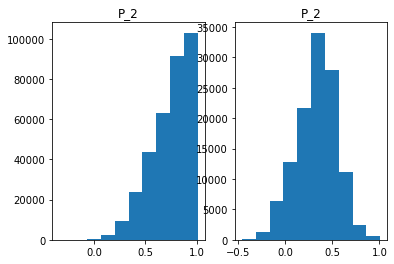

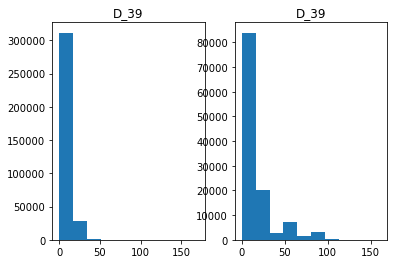

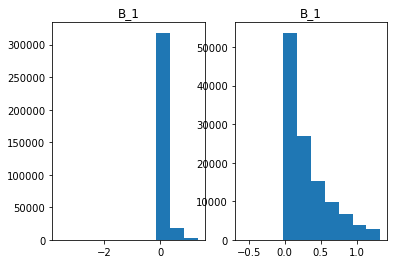

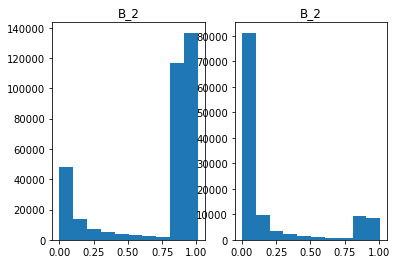

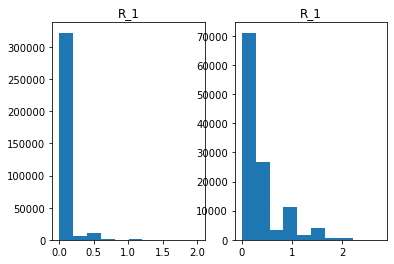

...

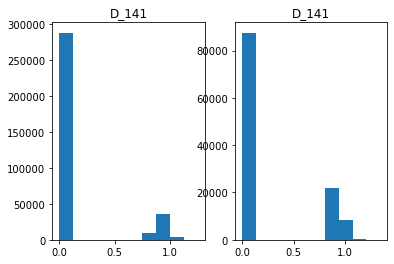

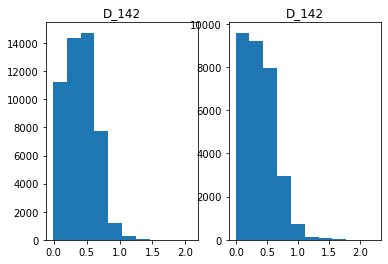

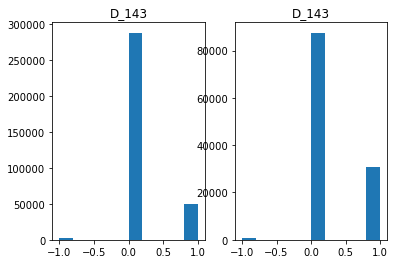

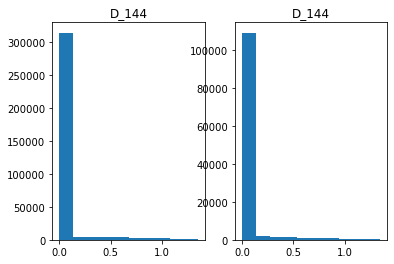

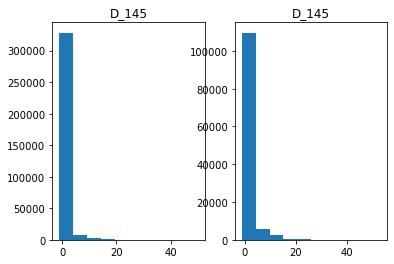

In [13]:
# See the distribution of each features for each class
cols = train_merged_df.columns
for col in cols:
    print(col)
    if col in ['customer_ID', 'S_2', 'D_63', 'D_64', 'D_88', 'target', 'rank_per_user']:
        continue
    
    fig, axes = plt.subplots(1, 2)
    axes[0].hist(train_merged_df.query('rank_per_user == 1 and target == 0')[col])
    axes[0].set_title(col)
    
    axes[1].hist(train_merged_df.query('rank_per_user == 1 and target == 1')[col])
    axes[1].set_title(col)

In [ ]:
# See the distribution of each str featrues for eacah class

## Plot line plots to see seasonal trend of each values per targete values

In [6]:
train_merged_df.head()

,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,...,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145,target,rank_per_user
0,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-03-09,0.938469,0.001733,0.008724,1.006838,0.009228,0.124035,0.008771,0.004709,...,NaN,0.002427,0.003706,0.003818,NaN,0.000569,0.000610,0.002674,0,13.0
1,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-04-07,0.936665,0.005775,0.004923,1.000653,0.006151,0.126750,0.000798,0.002714,...,NaN,0.003954,0.003167,0.005032,NaN,0.009576,0.005492,0.009217,0,12.0
2,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-05-28,0.954180,0.091505,0.021655,1.009672,0.006815,0.123977,0.007598,0.009423,...,NaN,0.003269,0.007329,0.000427,NaN,0.003429,0.006986,0.002603,0,11.0
3,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-06-13,0.960384,0.002455,0.013683,1.002700,0.001373,0.117169,0.000685,0.005531,...,NaN,0.006117,0.004516,0.003200,NaN,0.008419,0.006527,0.009600,0,10.0
4,0000099d6bd597052cdcda90ffabf56573fe9d7c79be5f...,2017-07-16,0.947248,0.002483,0.015193,1.000727,0.007605,0.117325,0.004653,0.009312,...,NaN,0.003671,0.004946,0.008889,NaN,0.001670,0.008126,0.009827,0,9.0


In [53]:
from scipy.stats import ks_2samp
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [57]:
dt

target,Negative,Positive
S_2,,
2017-03-01,0.155941,0.050723
2017-03-02,0.143160,0.052211
2017-03-03,0.088706,0.120133
2017-03-04,0.101077,0.049059
2017-03-05,0.163386,0.089874
...,...,...
2018-03-27,0.089154,0.034680
2018-03-28,0.085482,0.044844
2018-03-29,0.111756,0.074146


In [54]:
#日ごとのデータをまとめる
daily_values_mean = train_merged_df.groupby(['S_2', 'target']).mean().unstack()
daily_values_count = train_merged_df.groupby(['S_2', 'target']).count().unstack()
feature_names = list(set([col[0] for col in daily_values_mean.columns]))
#グラフ描画をする

R_16


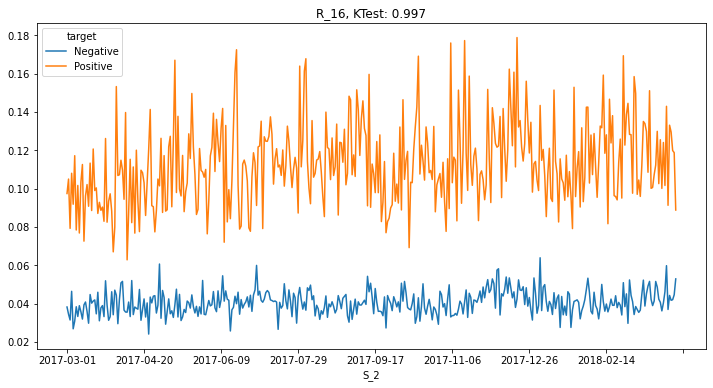

D_71


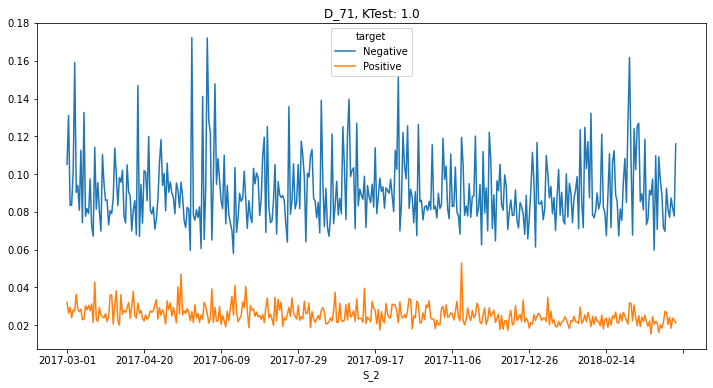

D_137


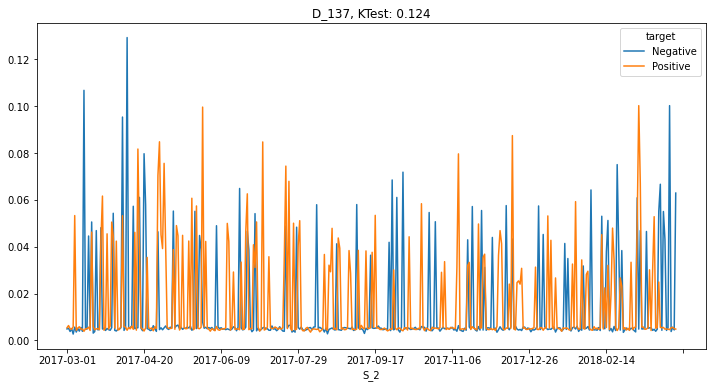

D_39


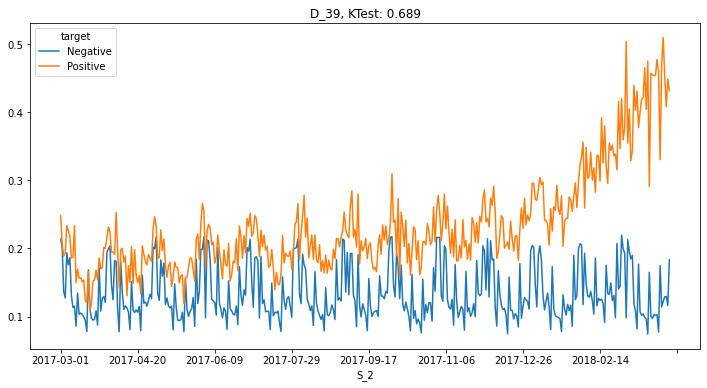

B_6


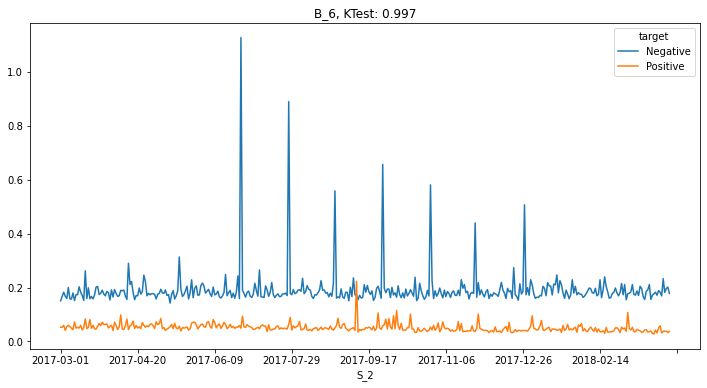

B_19


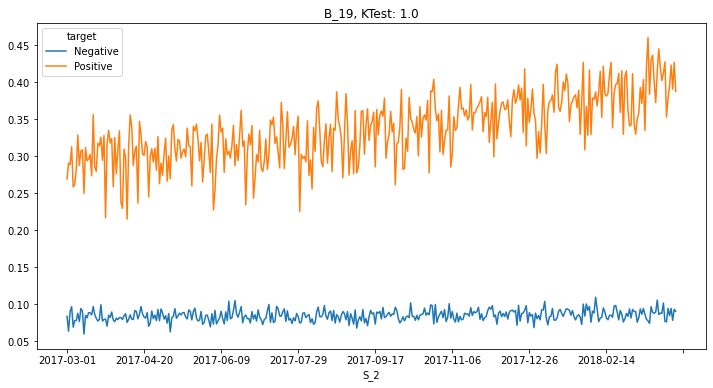

B_17


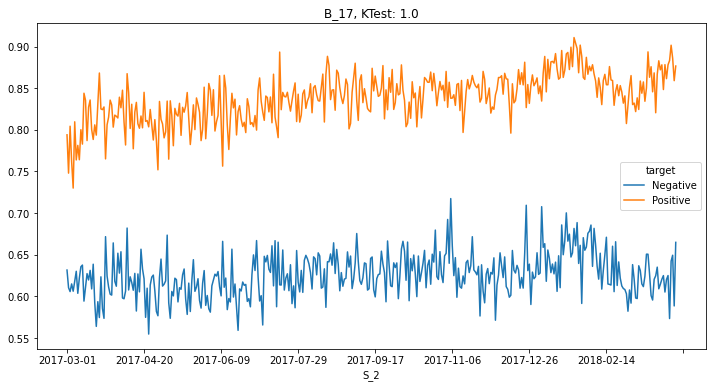

D_139


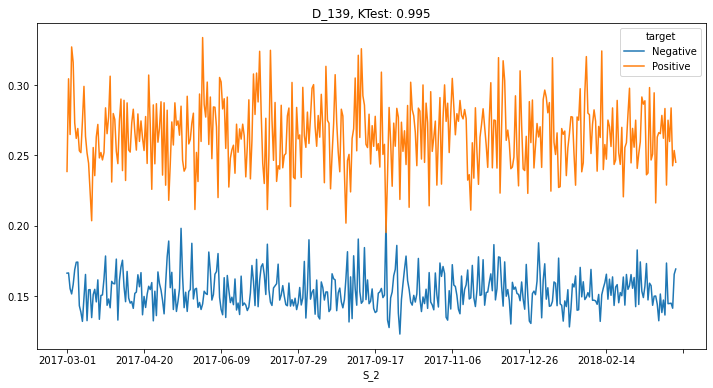

D_127


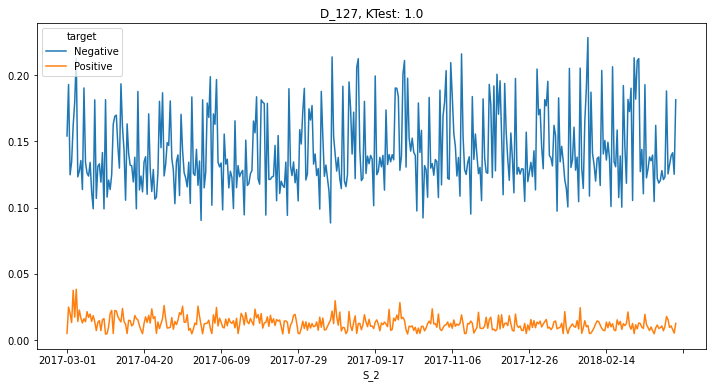

D_142


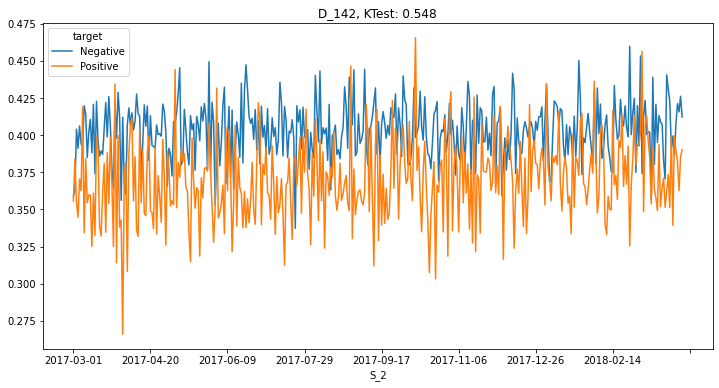

P_4


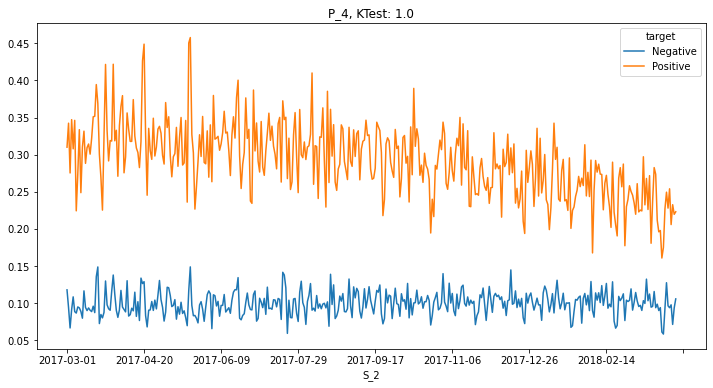

B_38


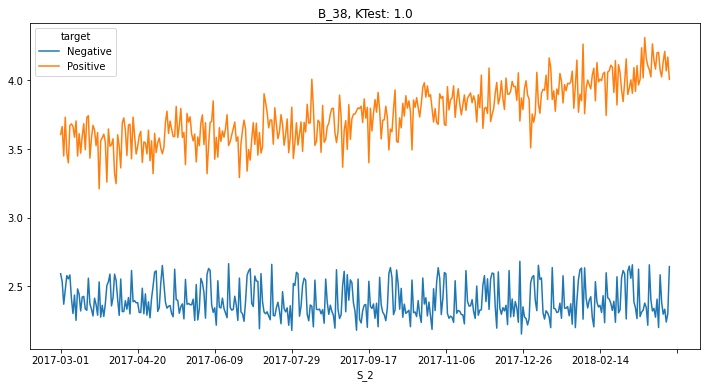

R_11


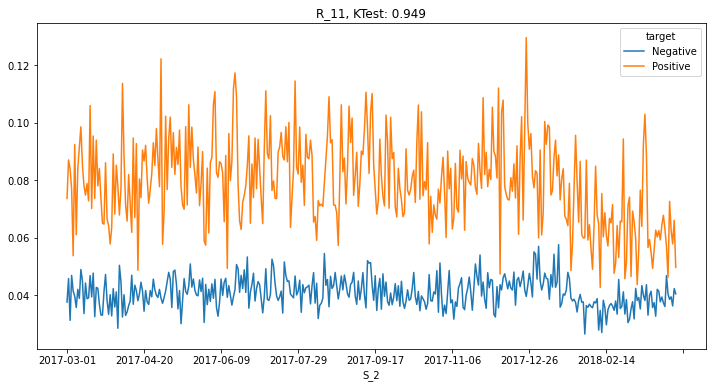

D_115


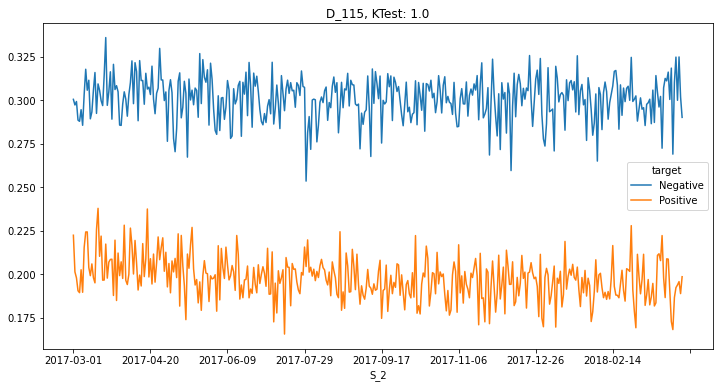

D_123


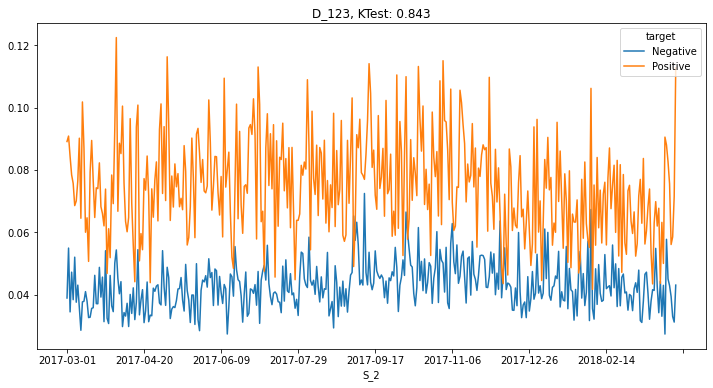

R_2


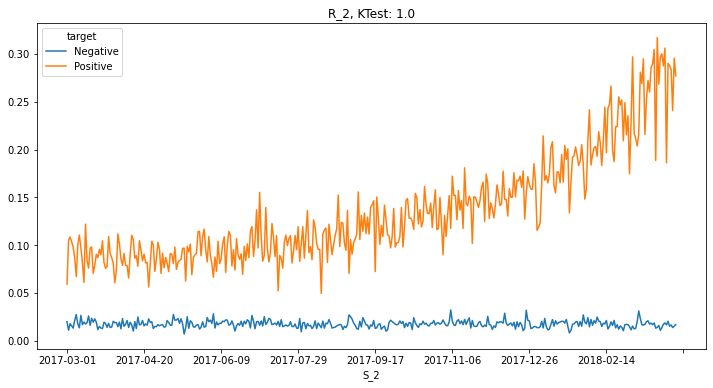

B_37


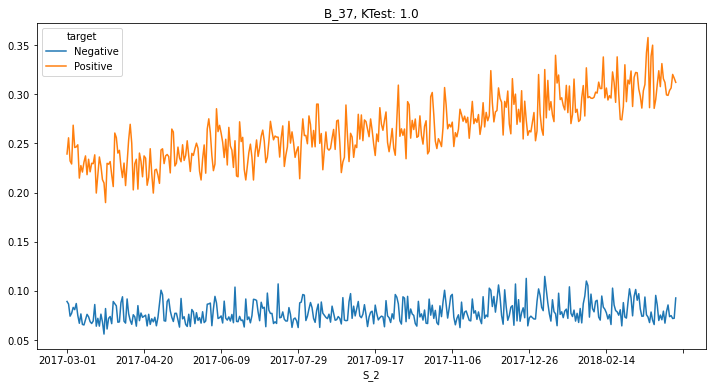

D_51


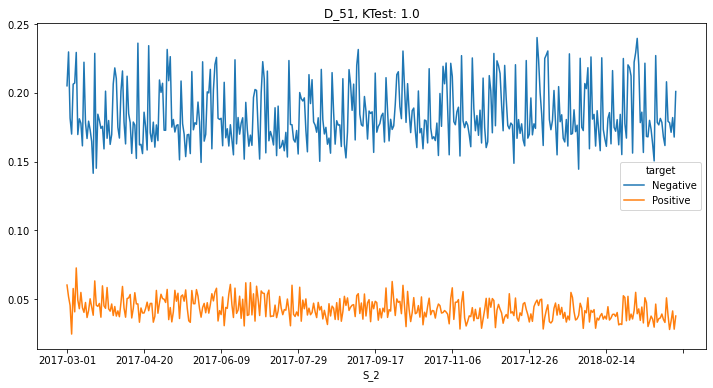

B_27


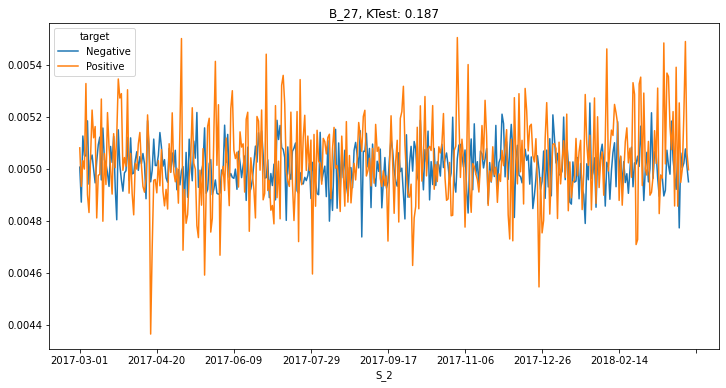

D_125


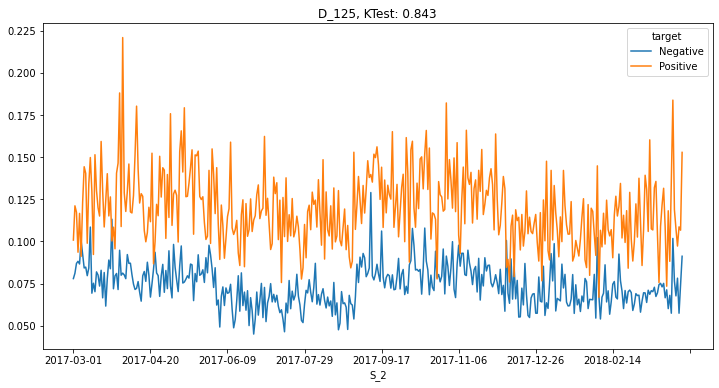

D_134


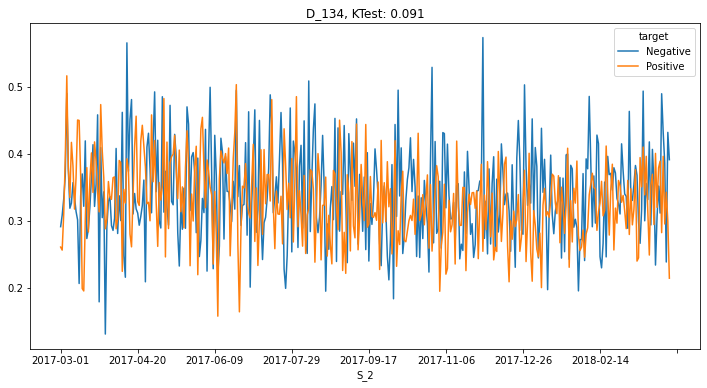

D_141


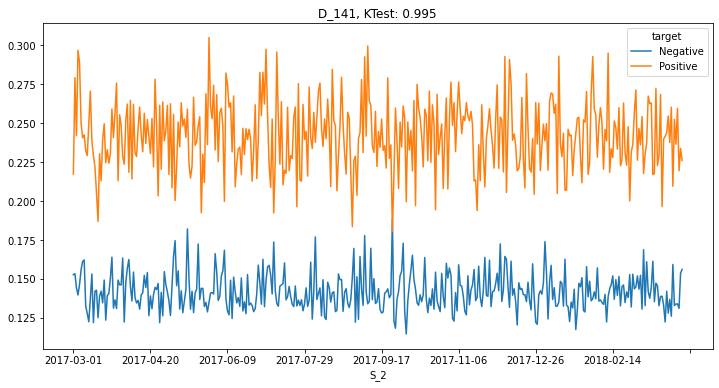

B_11


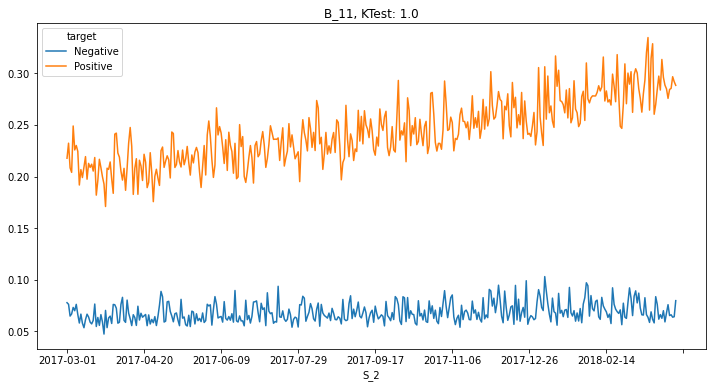

S_16


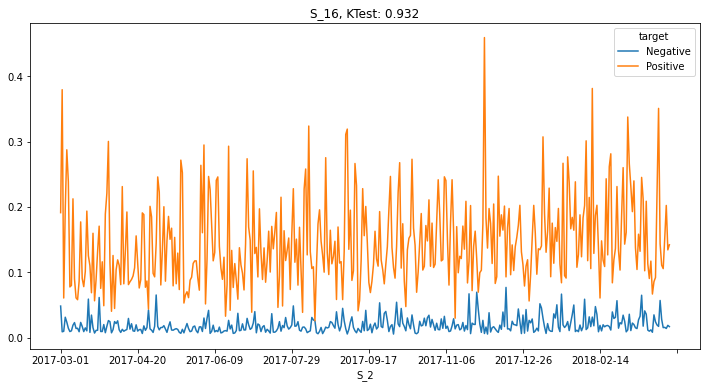

R_20


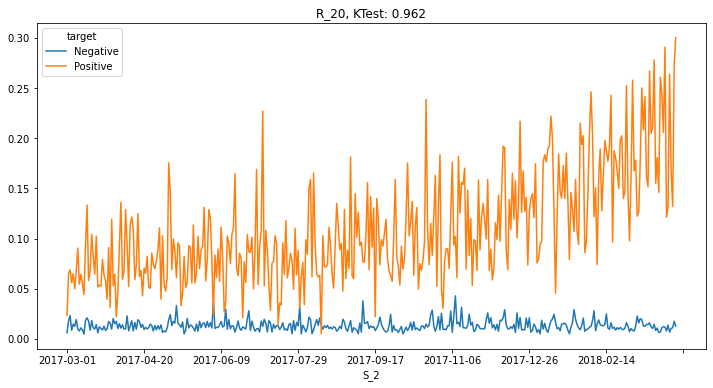

R_25


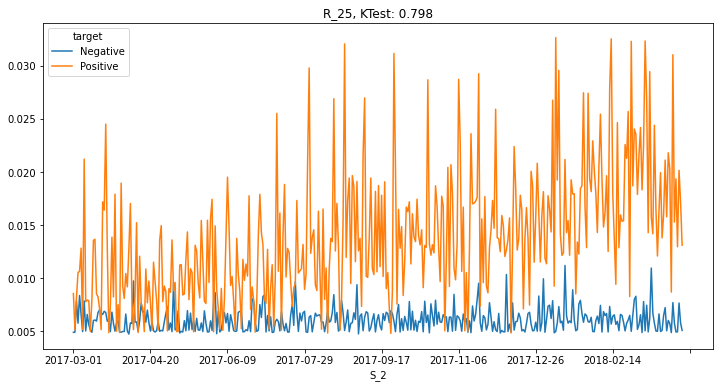

D_65


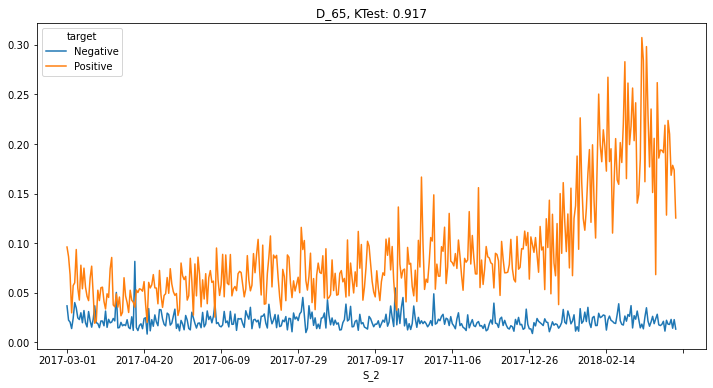

D_124


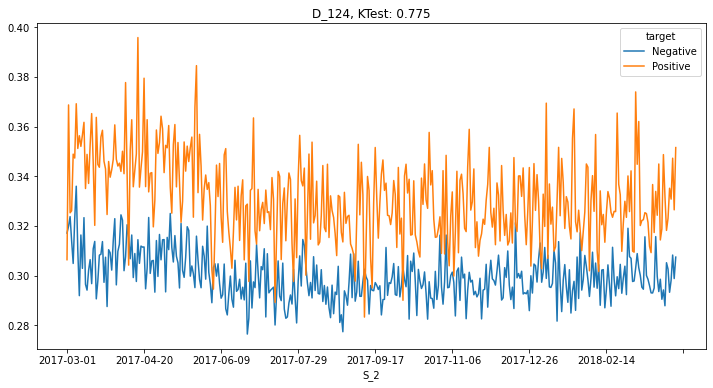

D_86


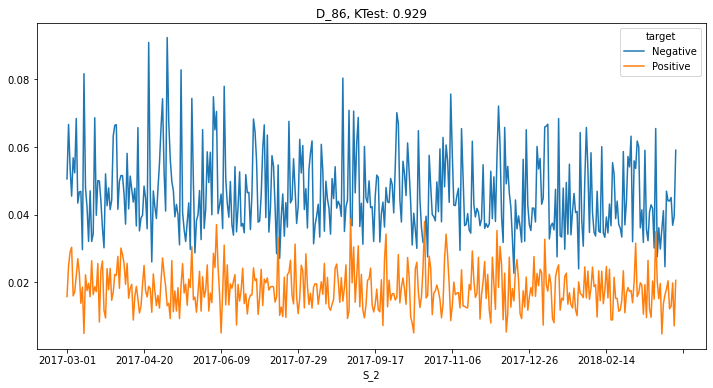

D_130


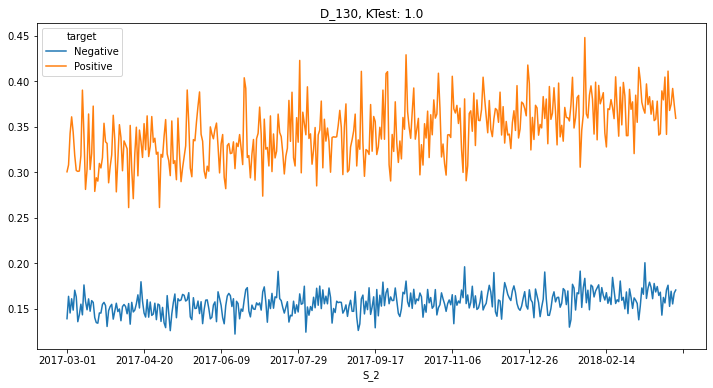

B_33


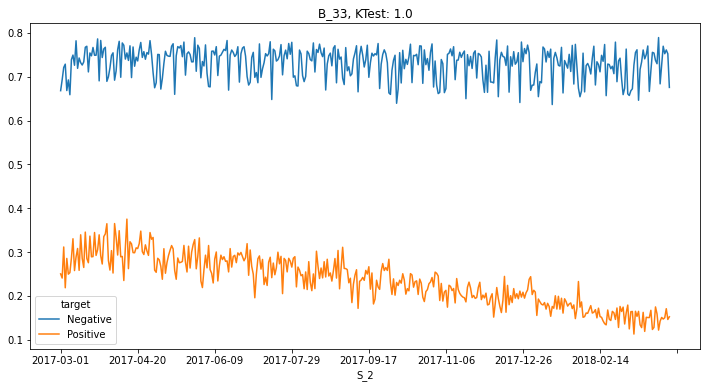

S_3


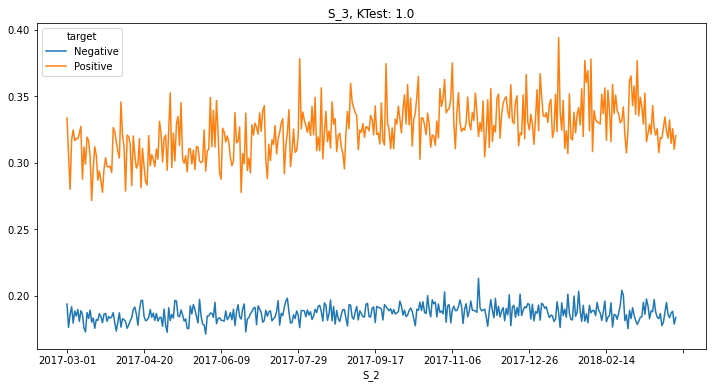

B_40


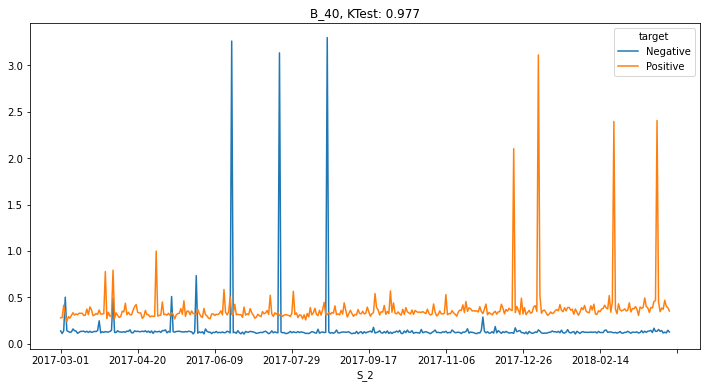

D_129


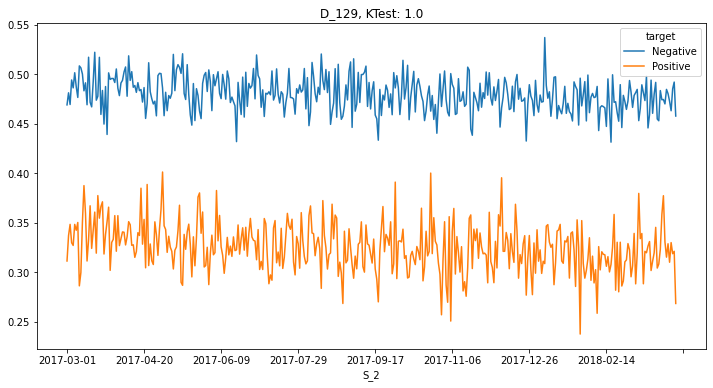

S_8


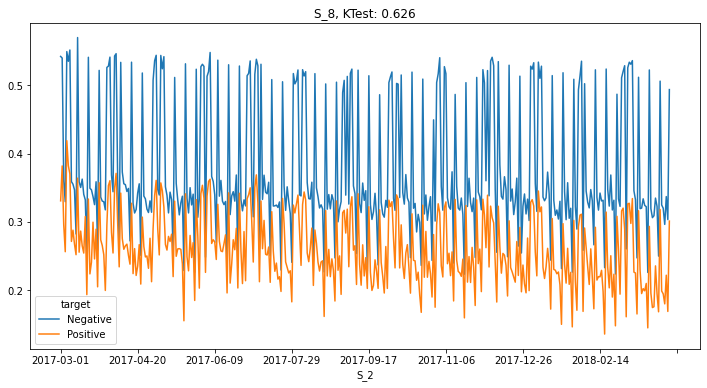

R_19


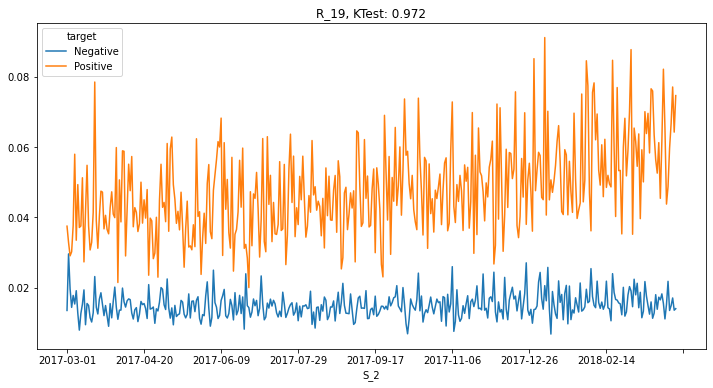

D_132


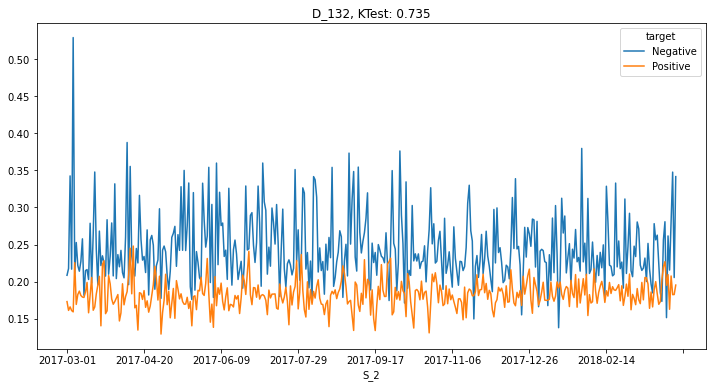

D_118


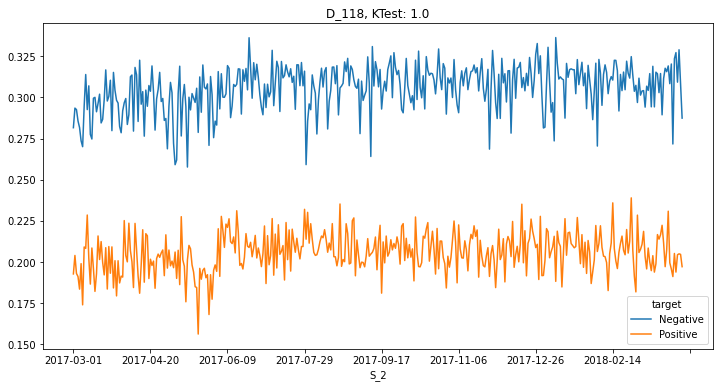

D_135


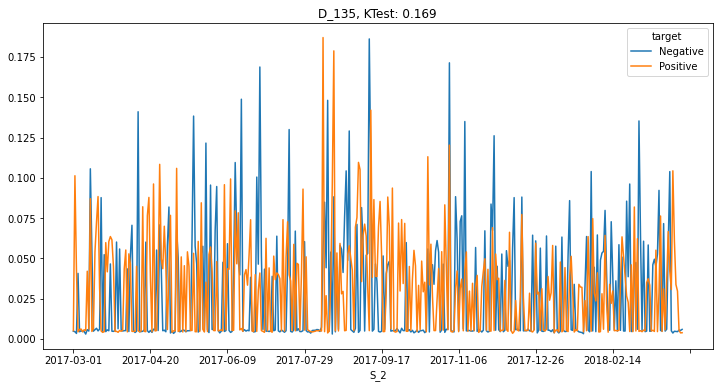

S_25


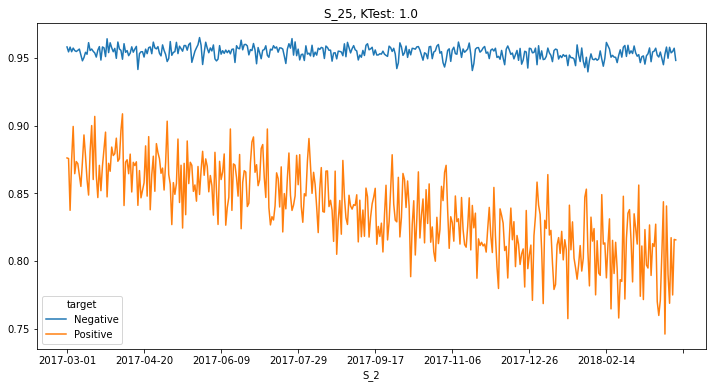

D_105


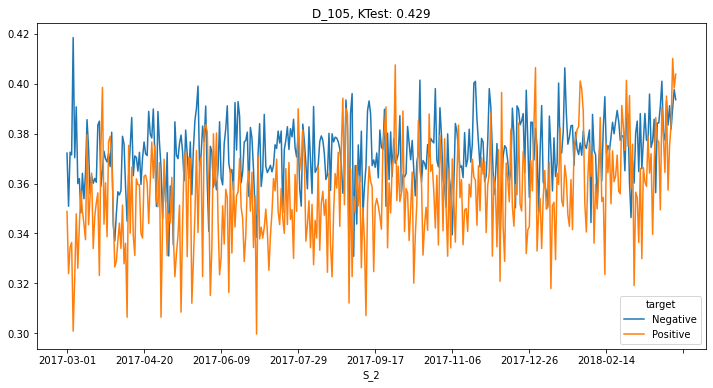

R_26


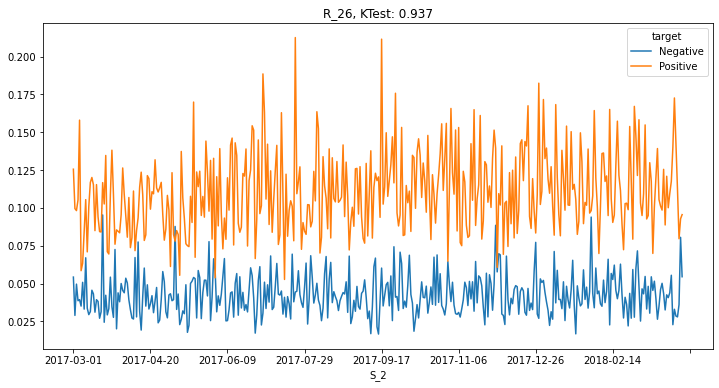

D_61


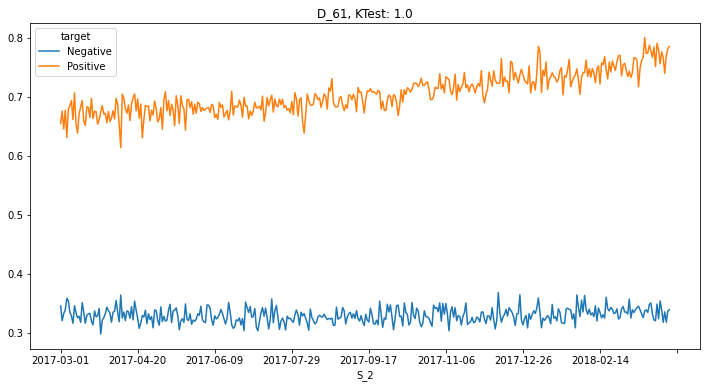

B_23


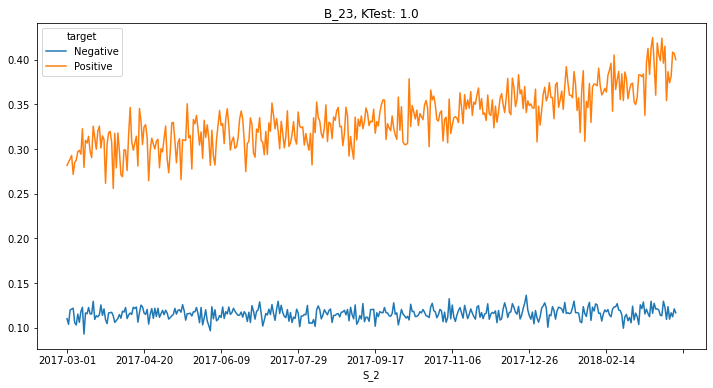

D_144


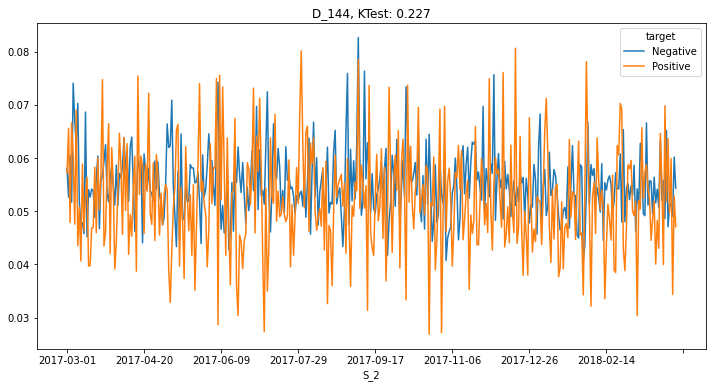

B_4


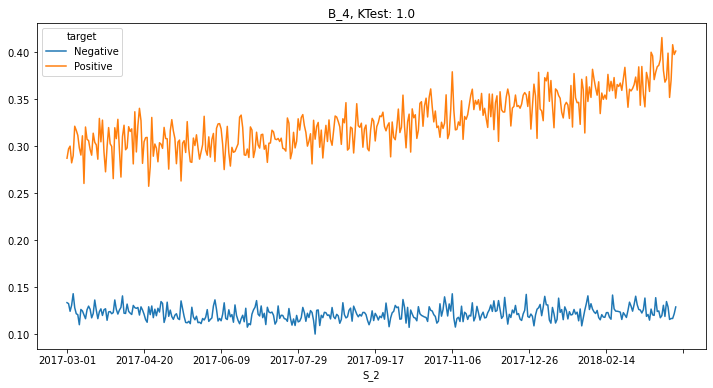

D_45


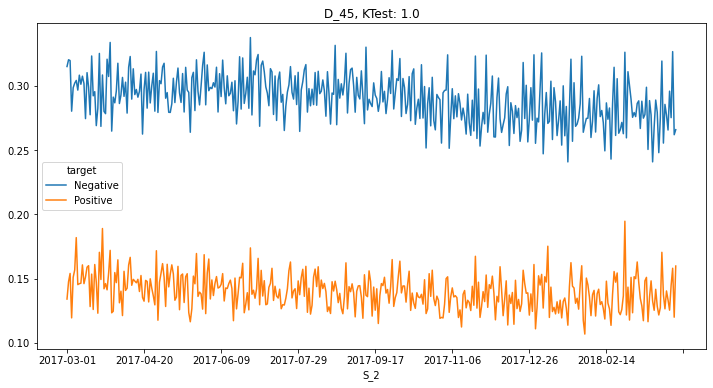

D_58


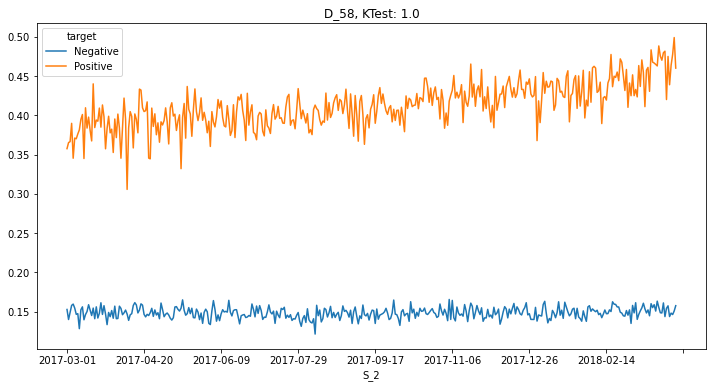

S_7


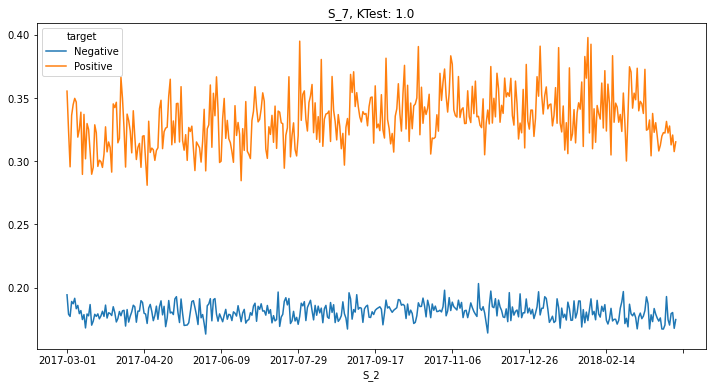

R_17


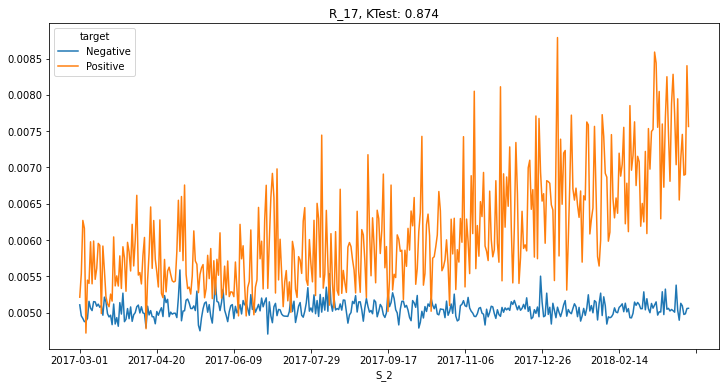

B_18


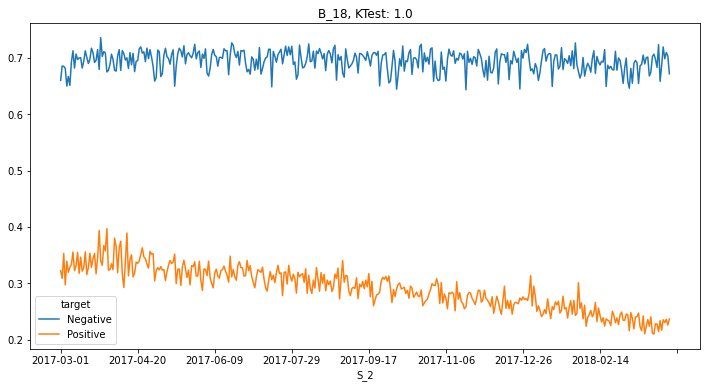

D_88


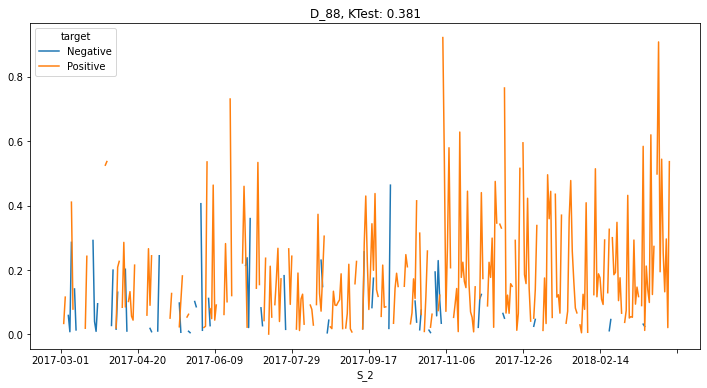

D_83


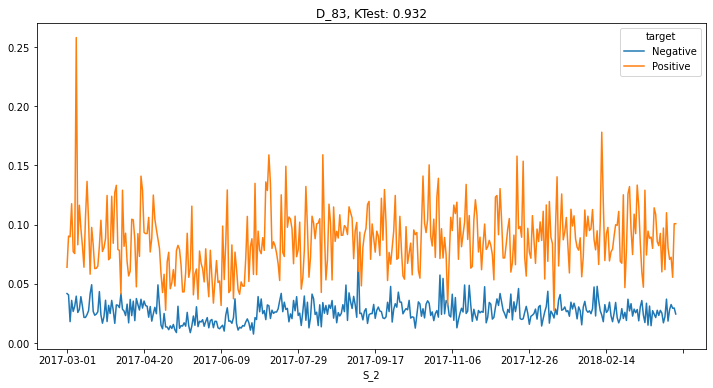

D_93


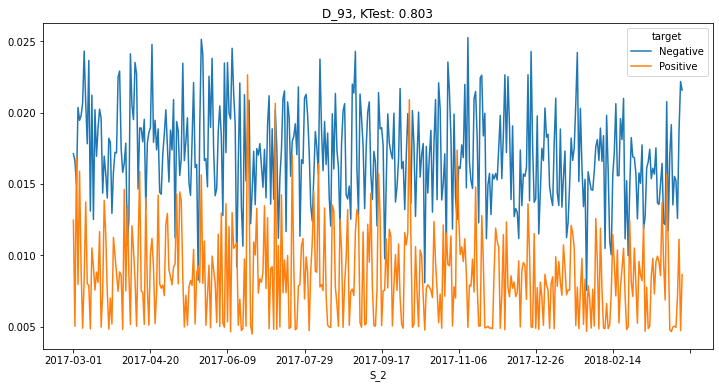

D_52


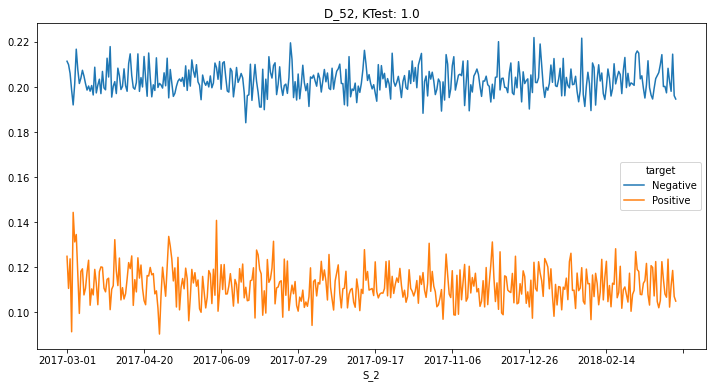

S_6


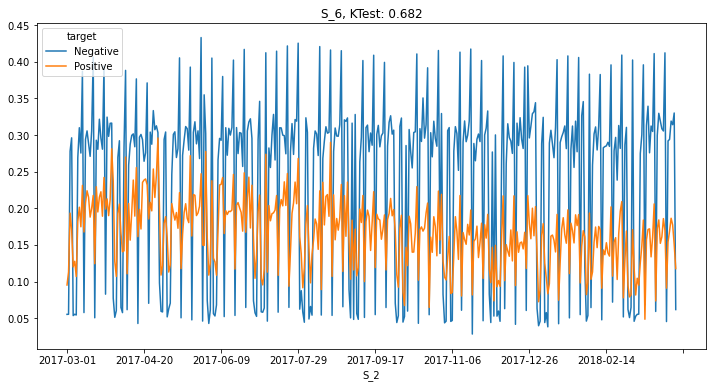

R_12


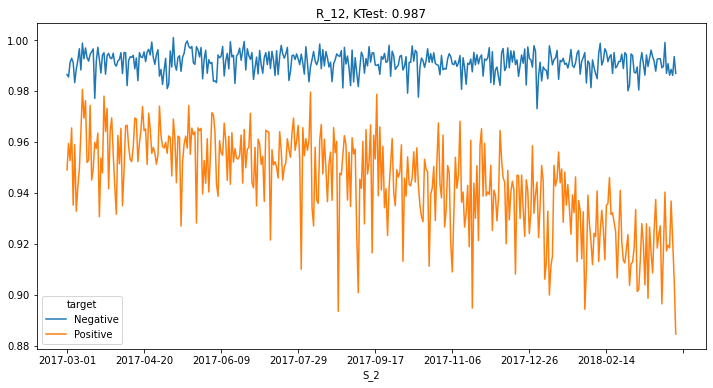

D_117


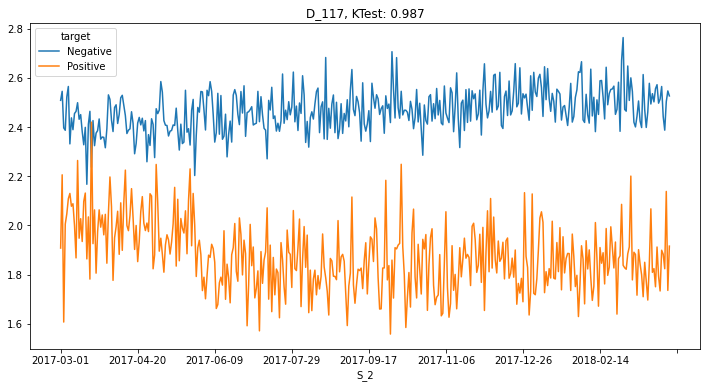

D_138


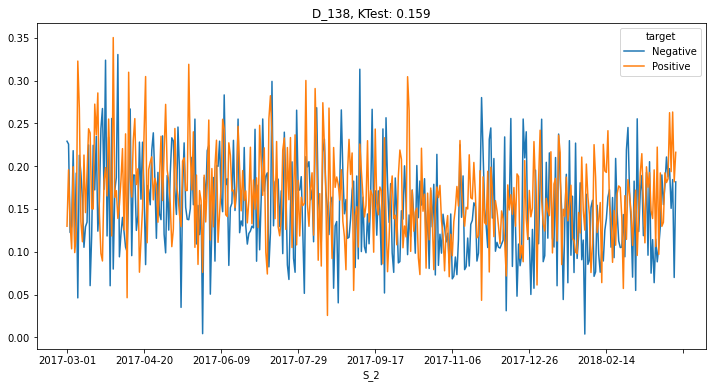

S_11


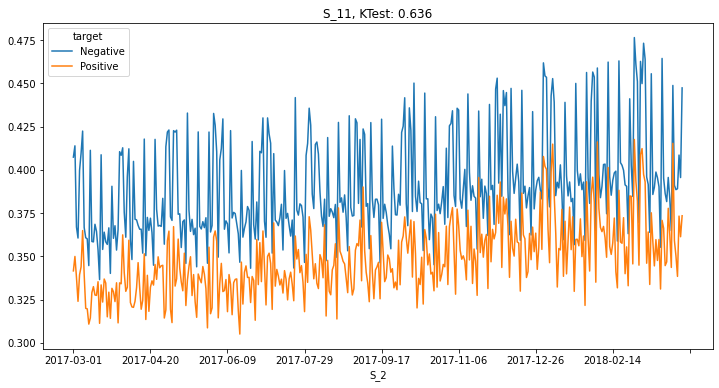

D_84


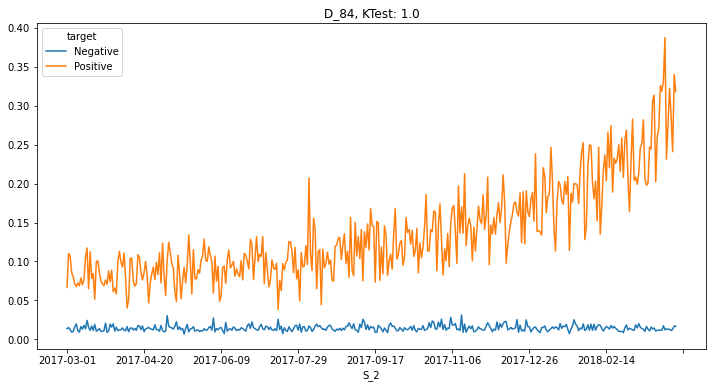

R_14


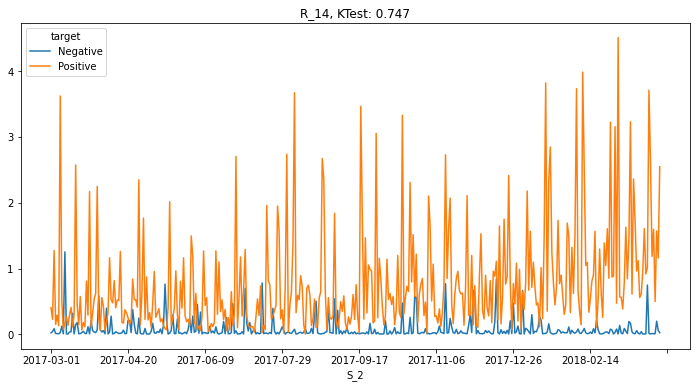

D_106


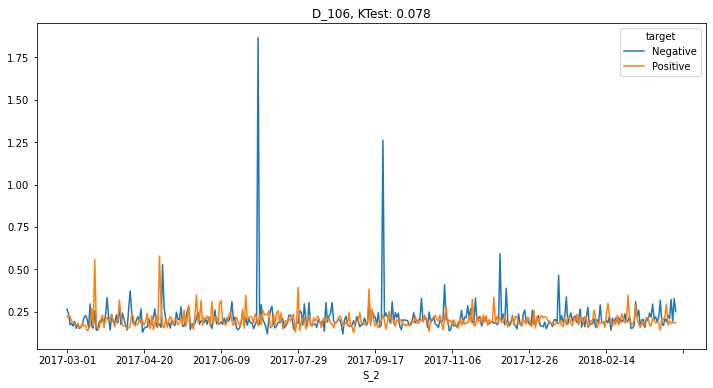

D_54


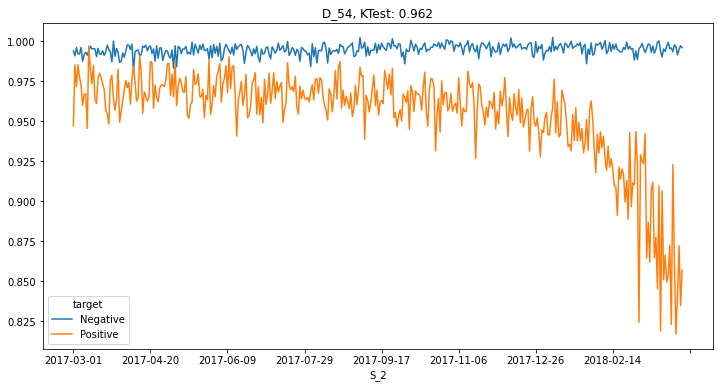

B_1


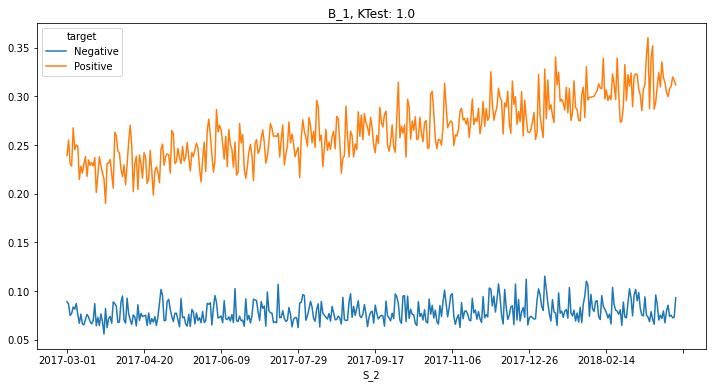

S_9


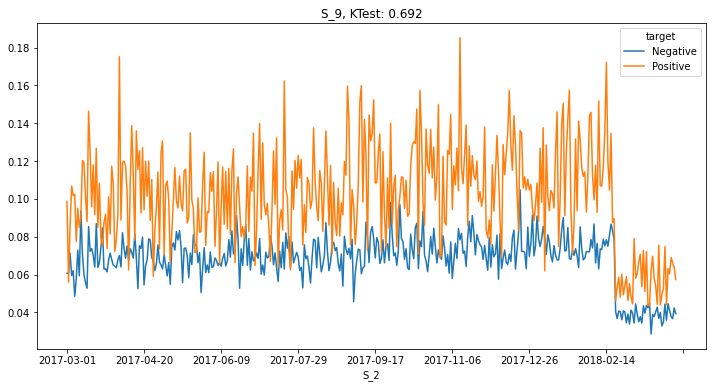

S_18


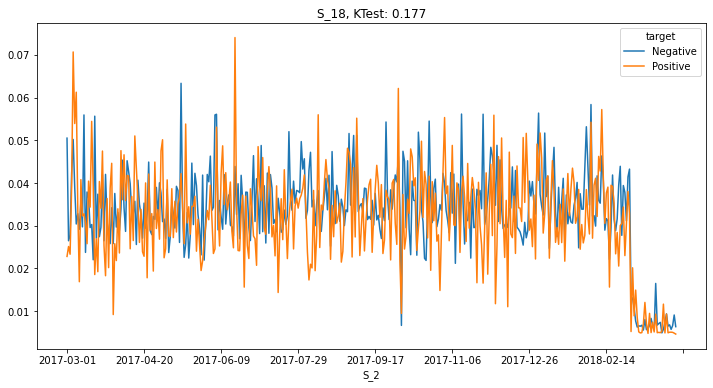

B_24


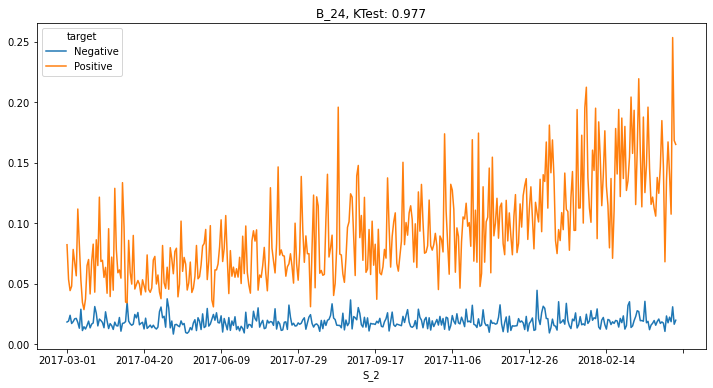

R_9


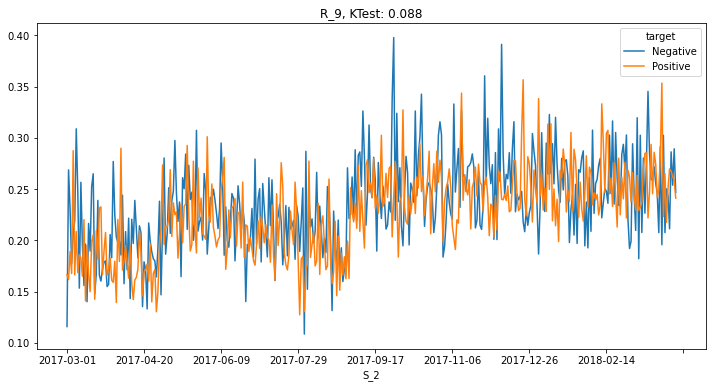

R_7


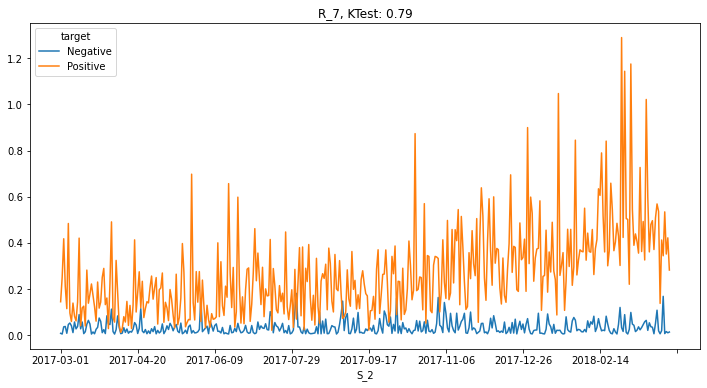

D_75


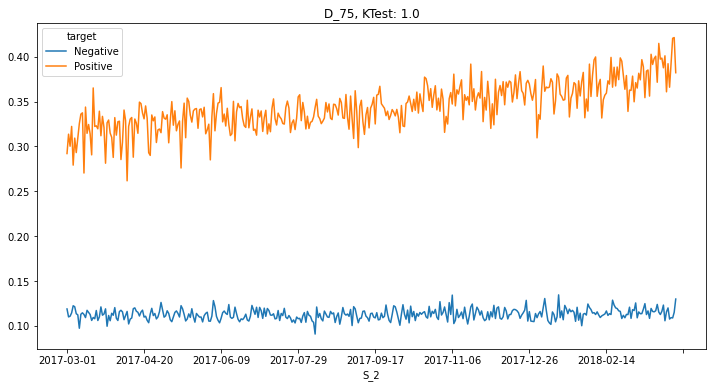

D_55


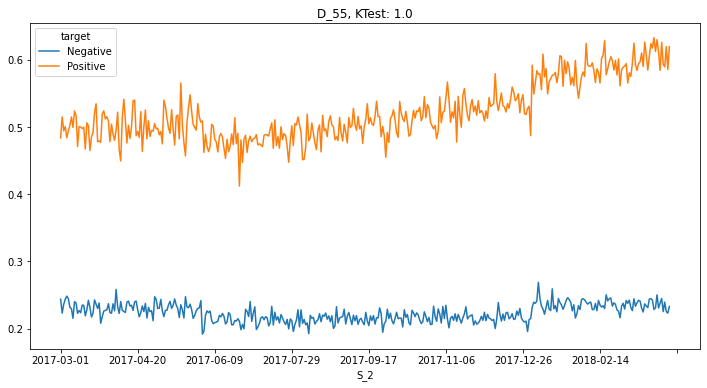

B_36


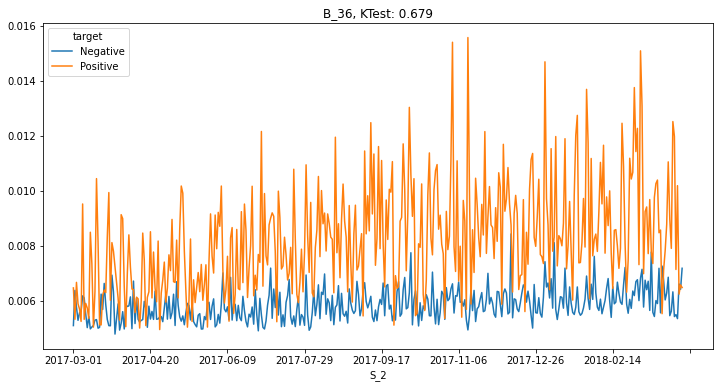

B_29


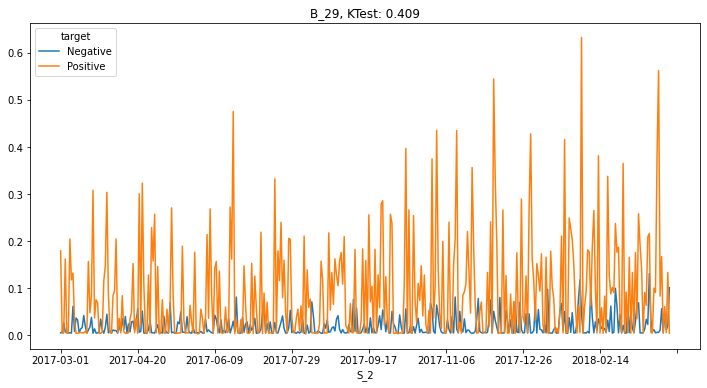

S_5


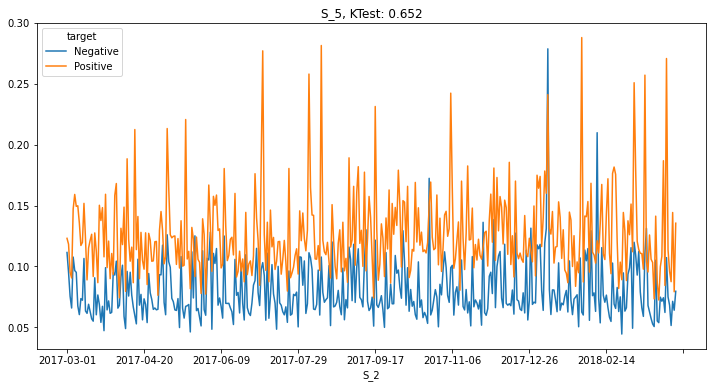

D_60


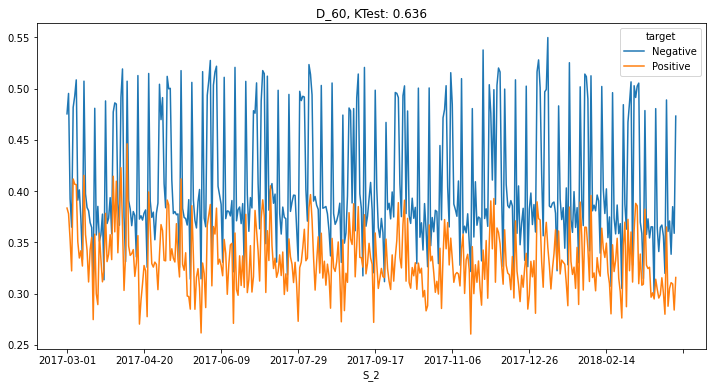

D_73


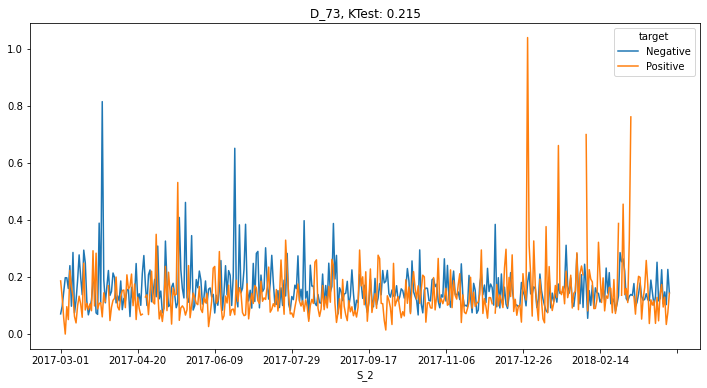

S_27


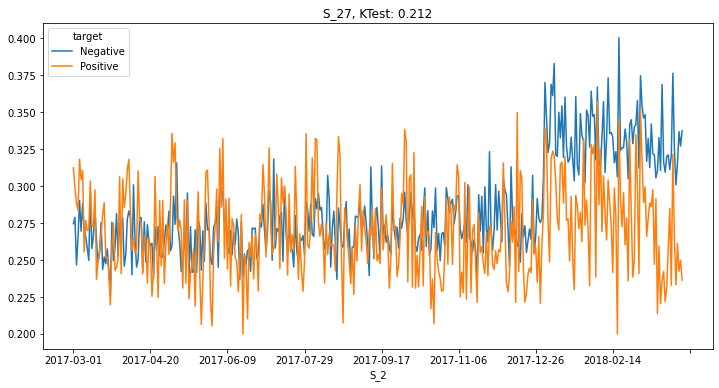

D_136


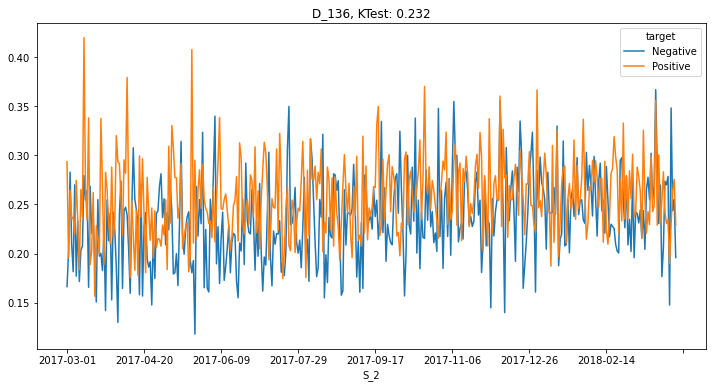

D_109


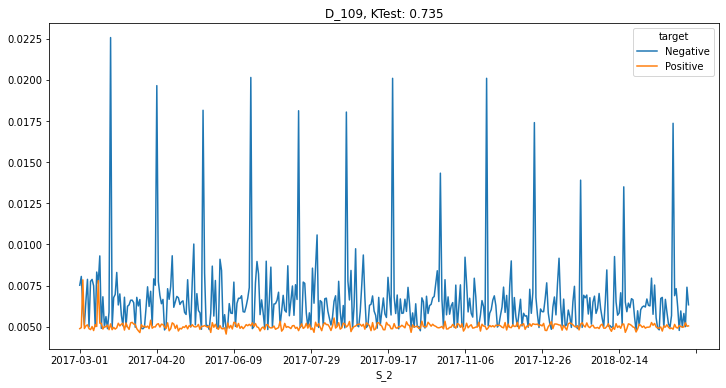

rank_per_user


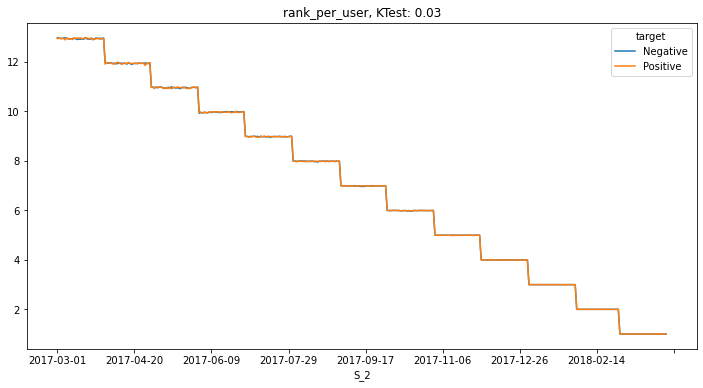

B_21


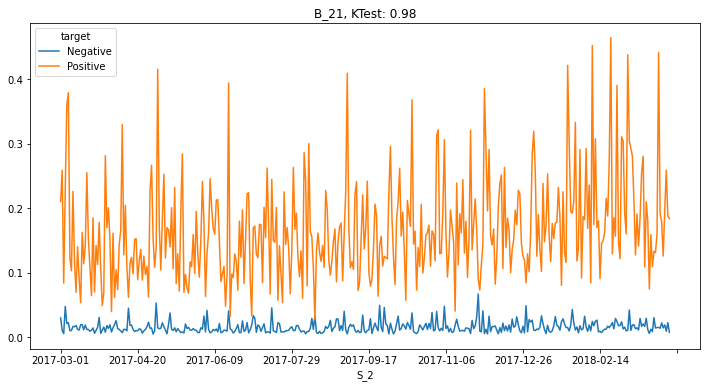

D_47


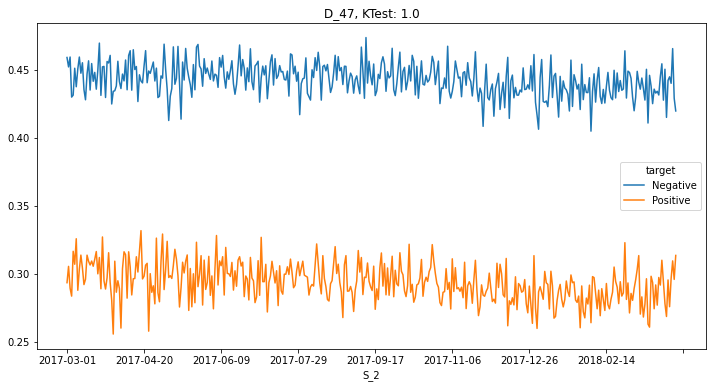

R_28


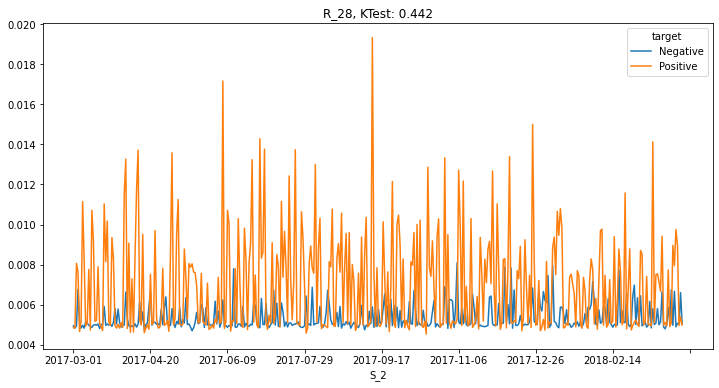

B_26


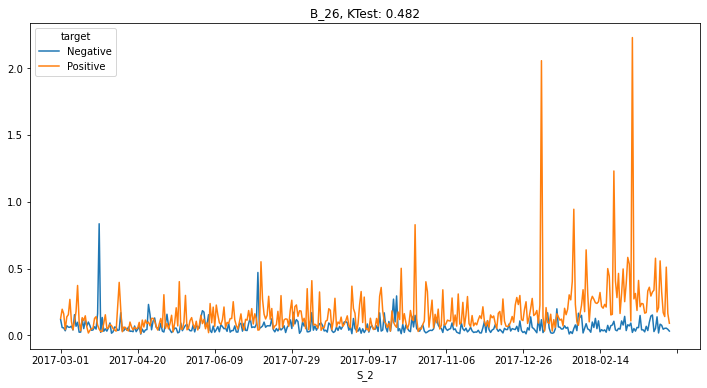

D_81


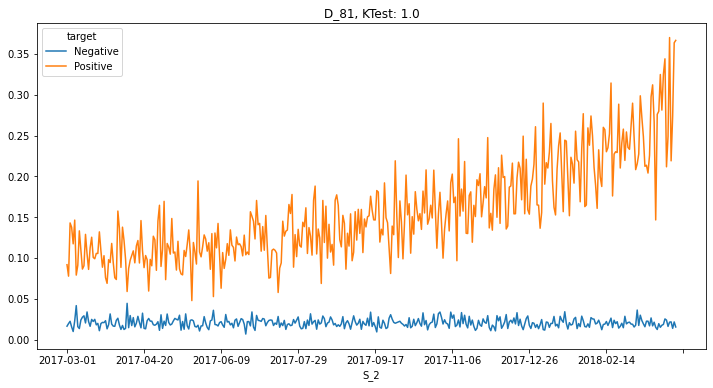

S_13


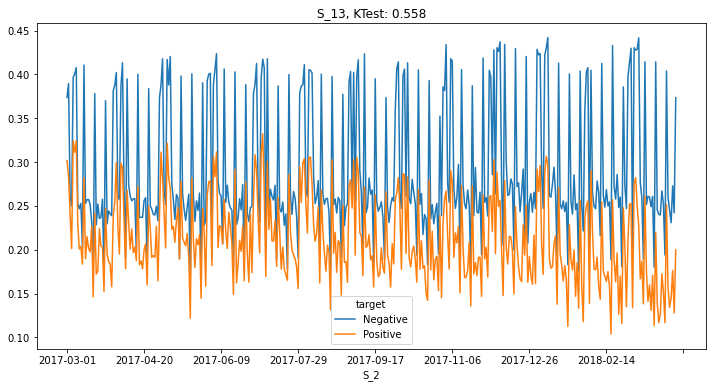

B_39


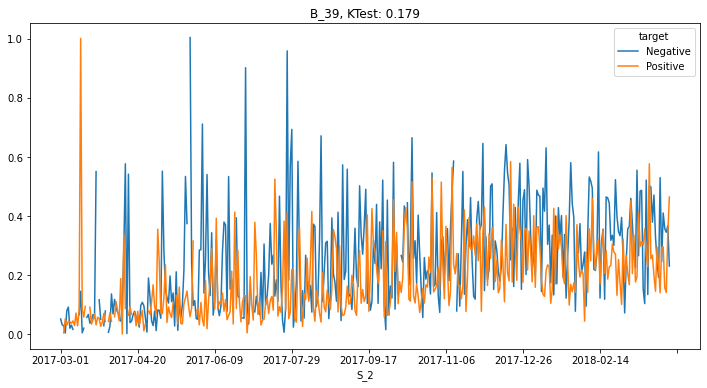

S_17


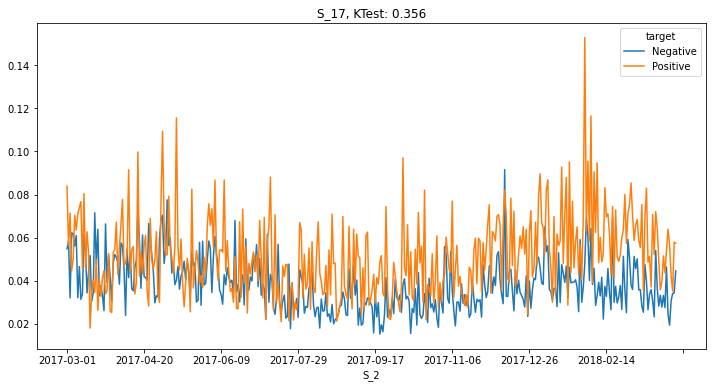

B_22


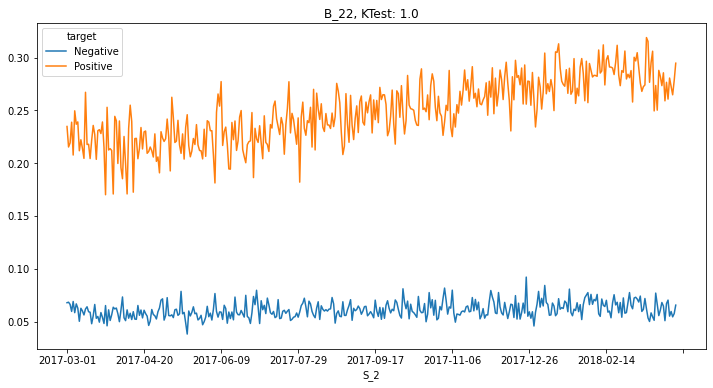

R_23


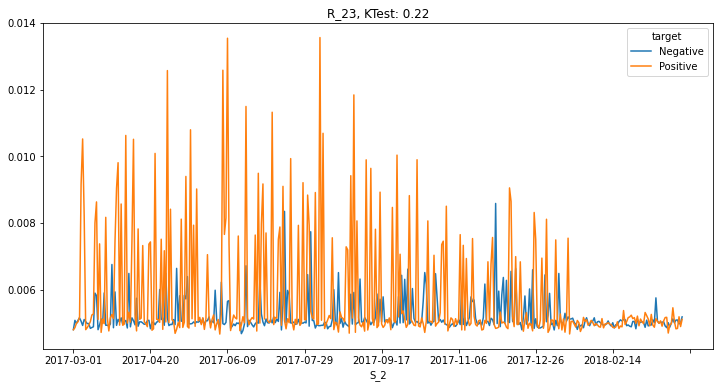

D_113


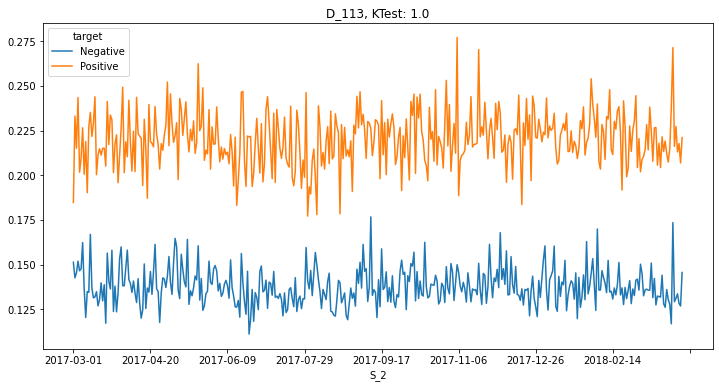

S_15


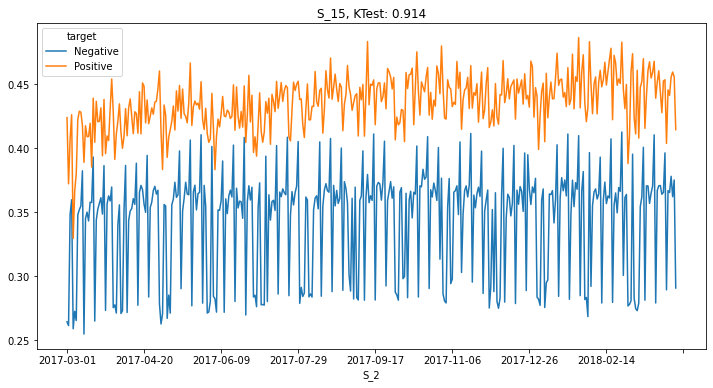

D_133


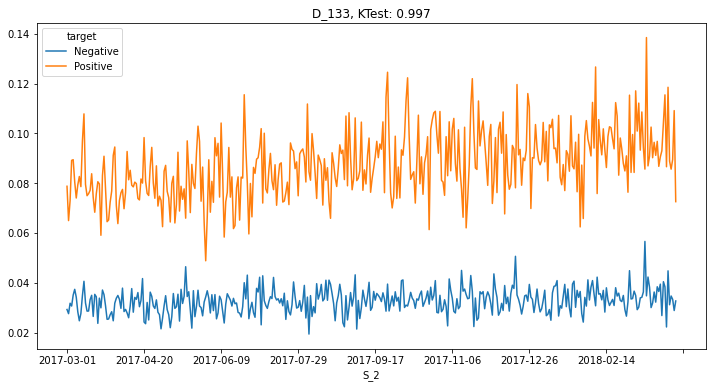

D_91


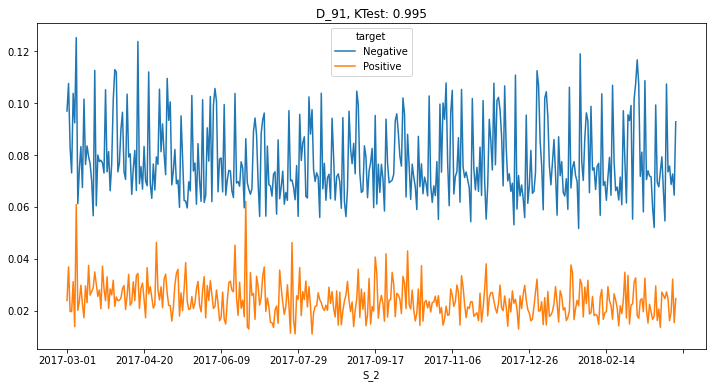

S_20


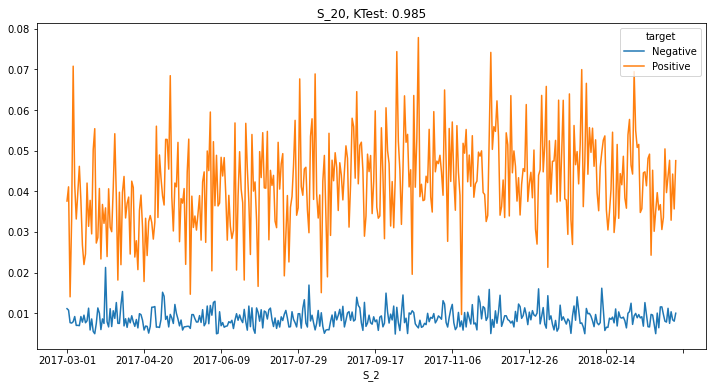

D_43


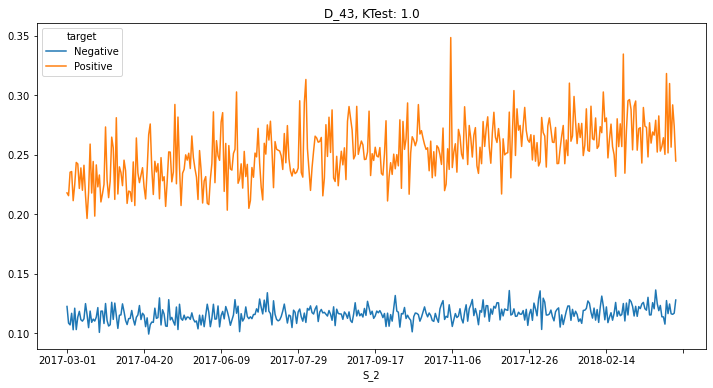

D_46


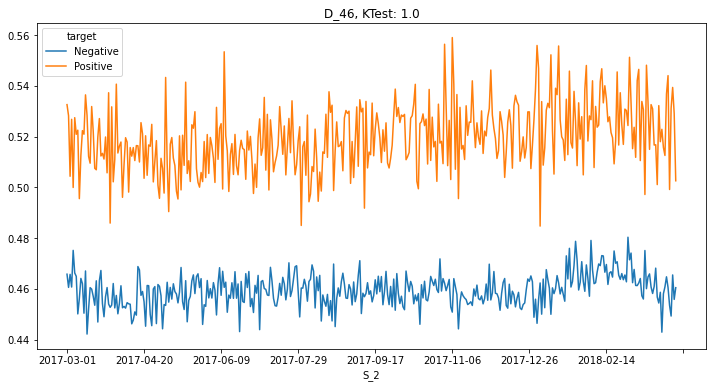

R_8


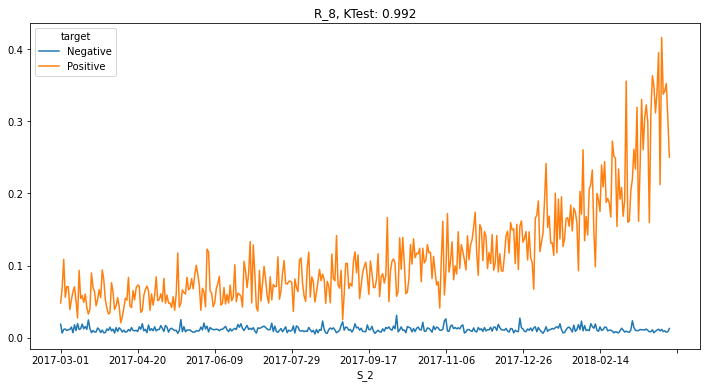

D_92


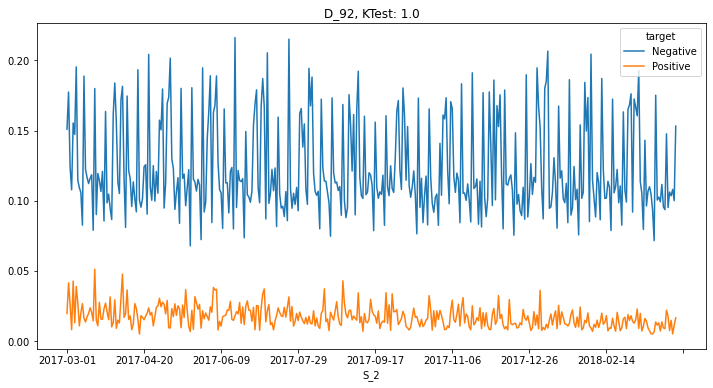

D_53


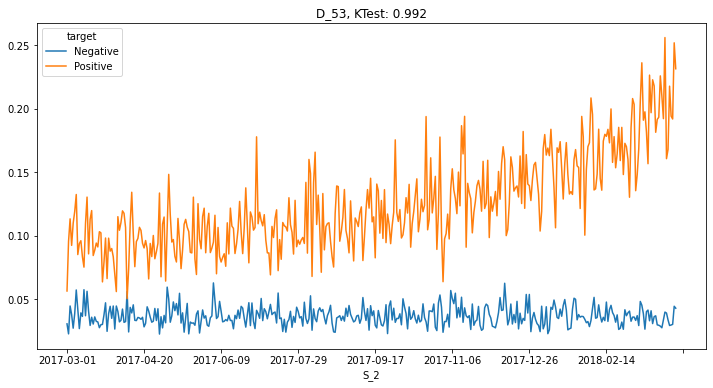

S_12


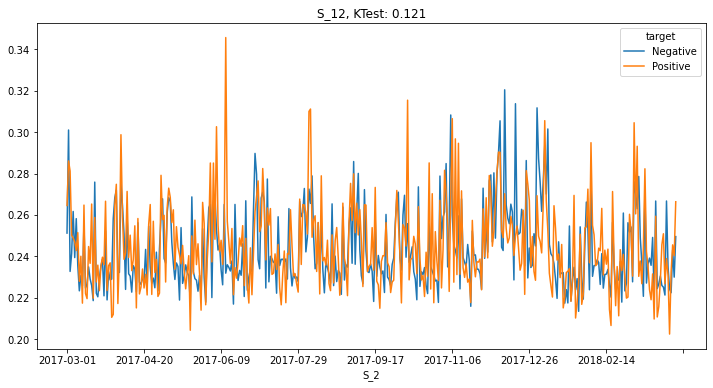

D_94


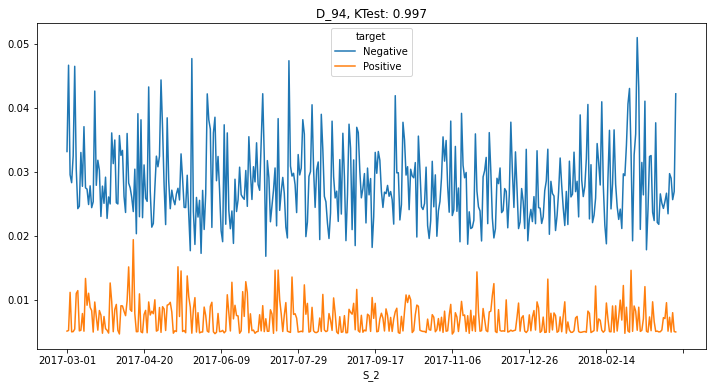

B_10


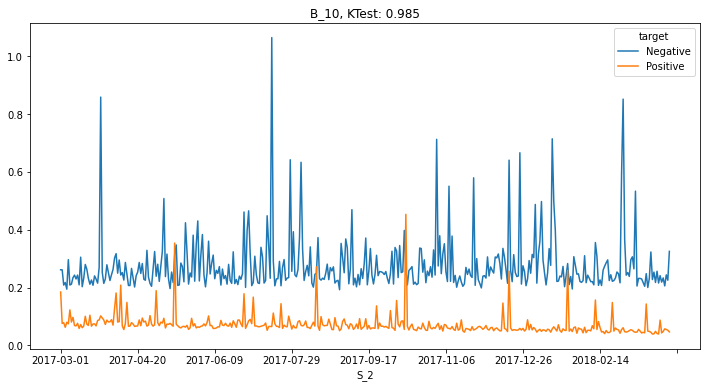

D_68


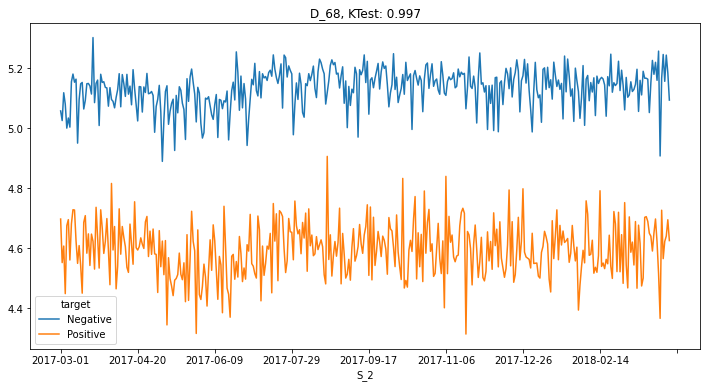

D_62


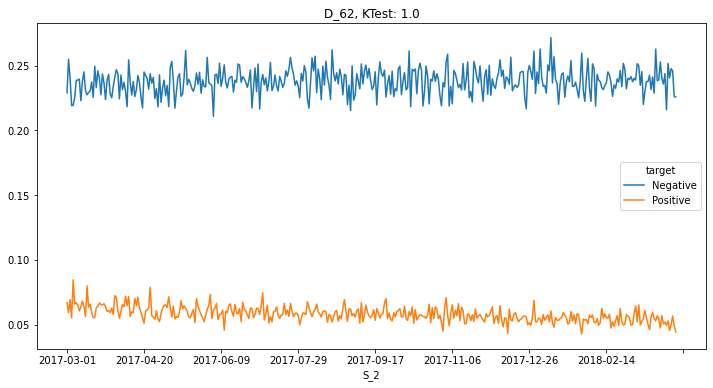

S_23


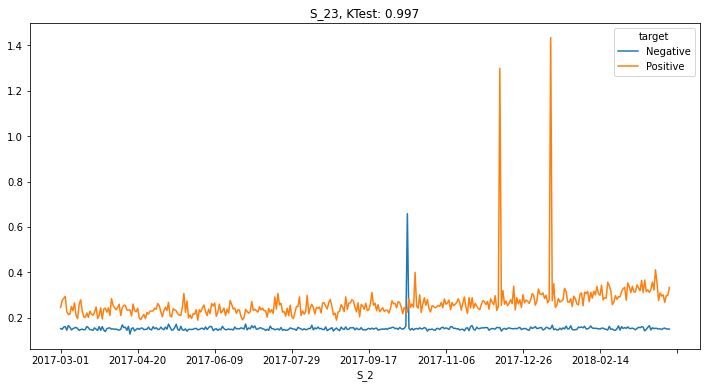

D_131


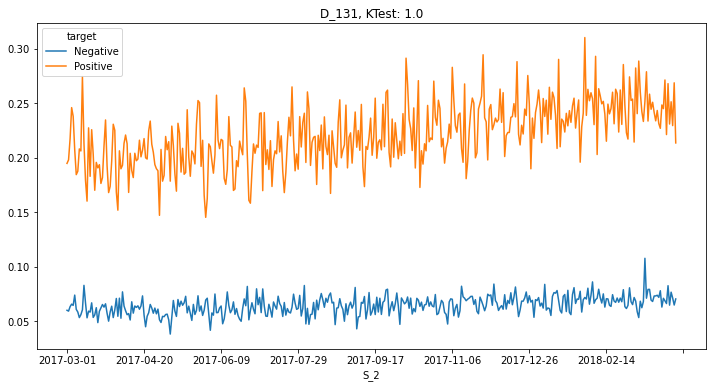

D_48


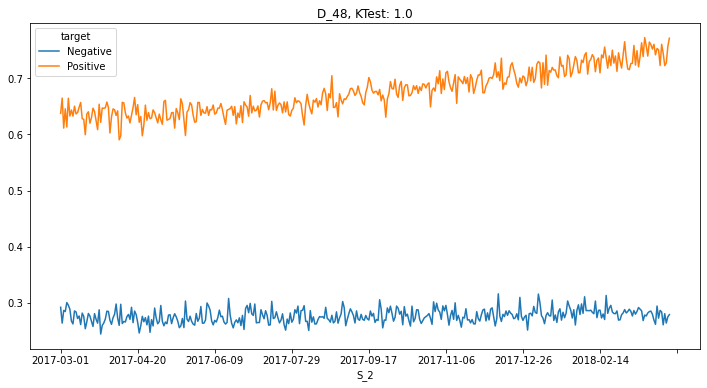

B_15


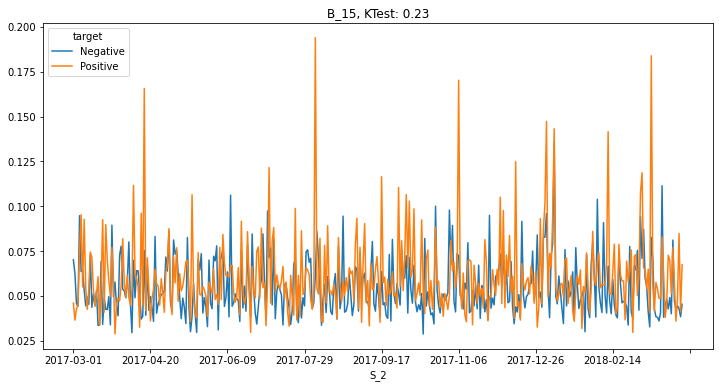

B_25


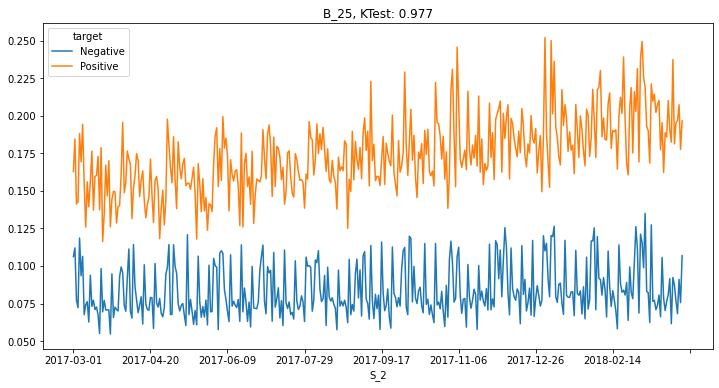

D_89


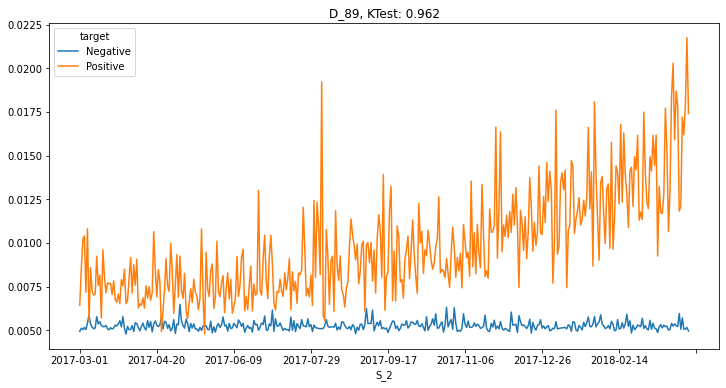

B_28


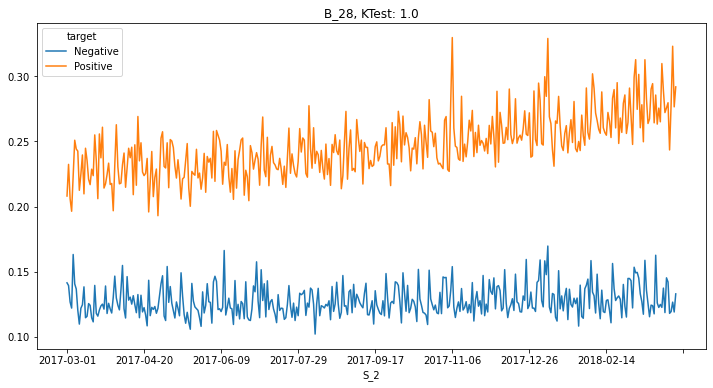

D_87


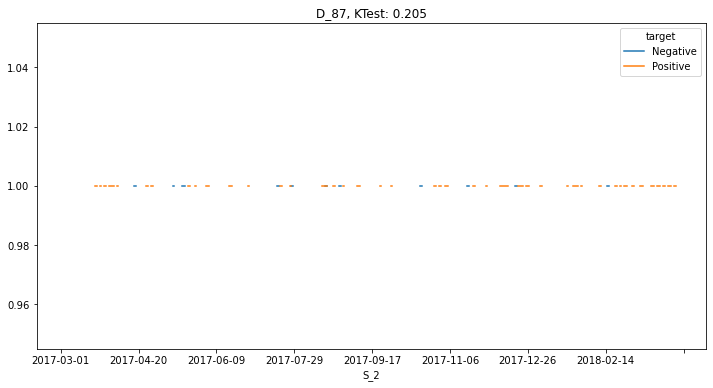

D_44


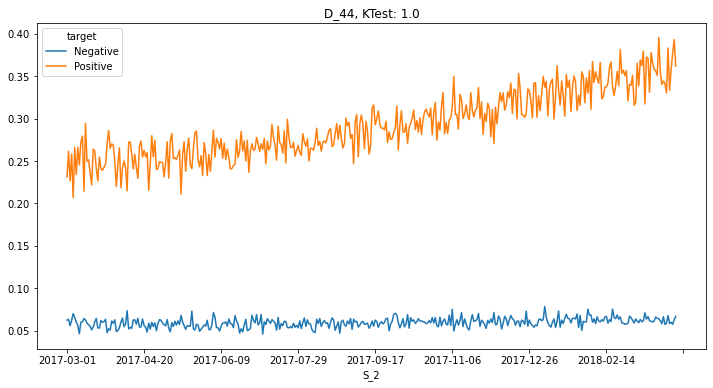

D_122


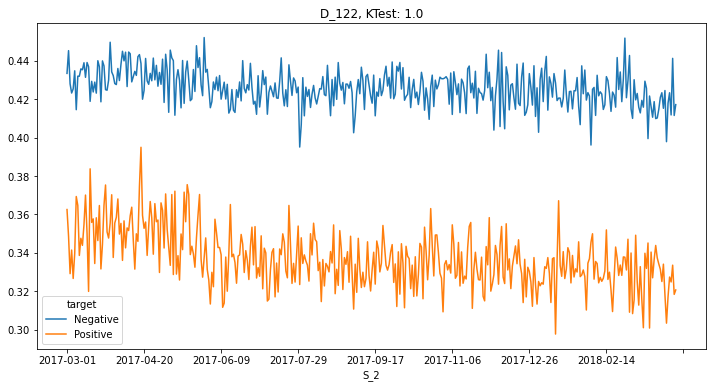

D_102


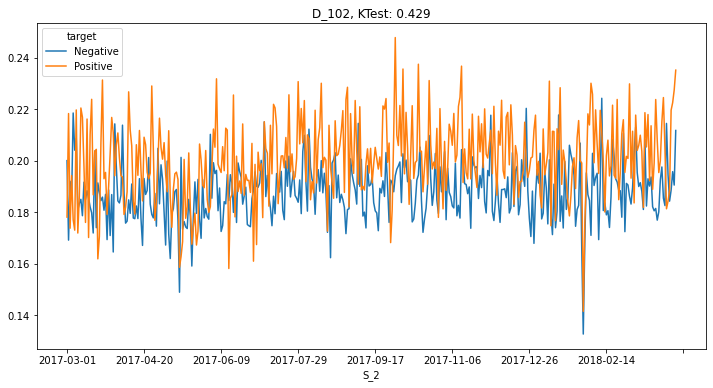

D_143


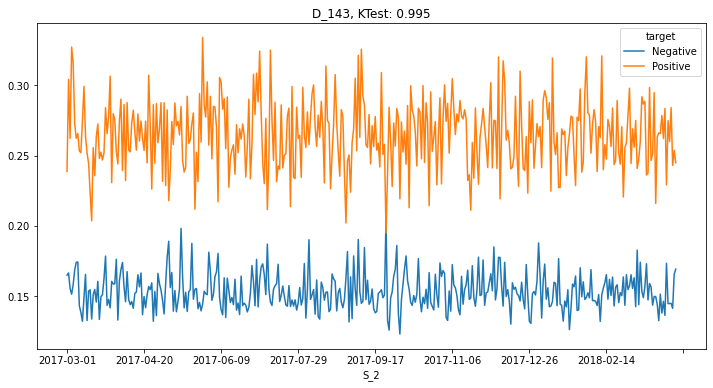

R_3


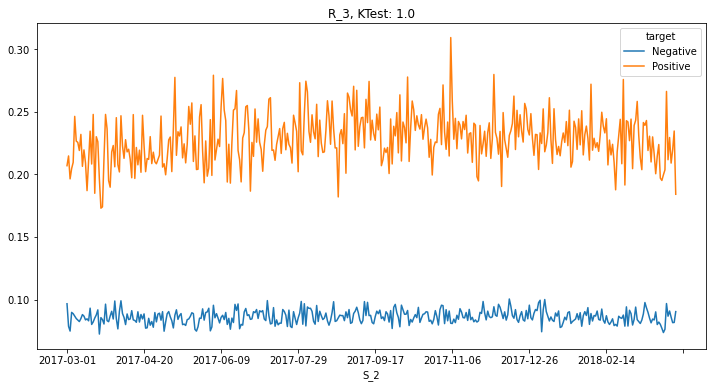

D_78


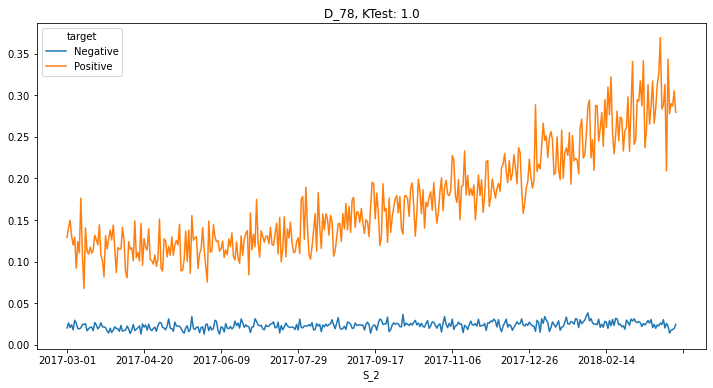

R_10


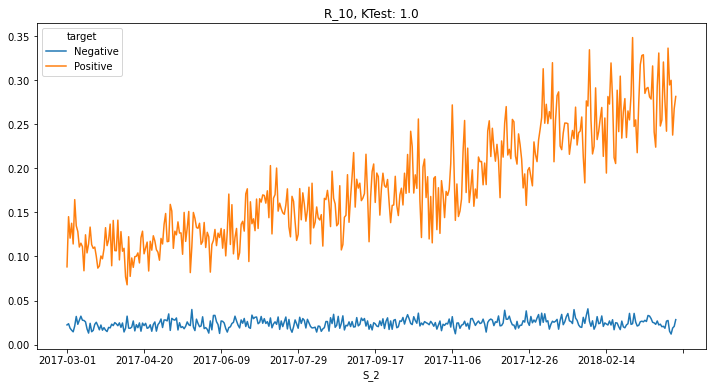

S_26


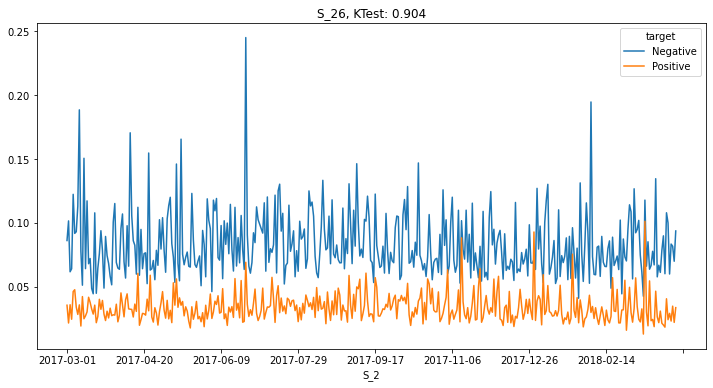

D_140


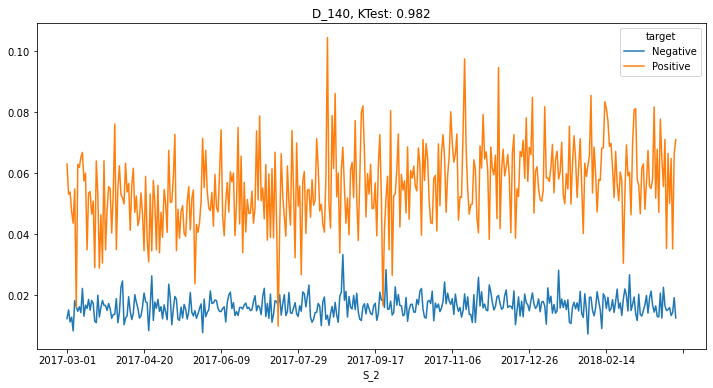

B_9


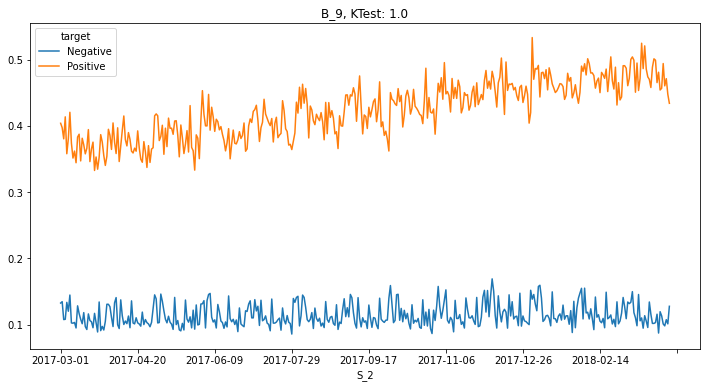

R_24


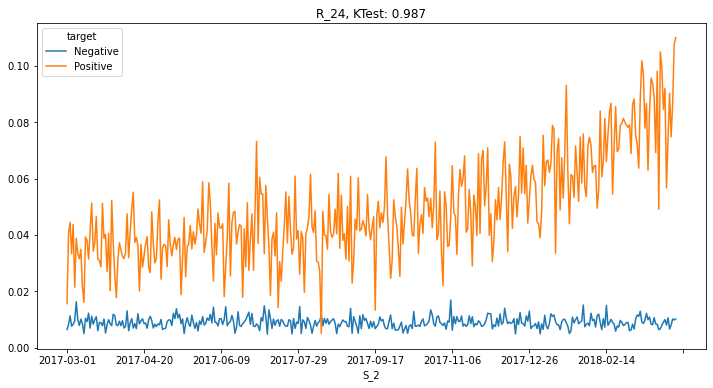

B_13


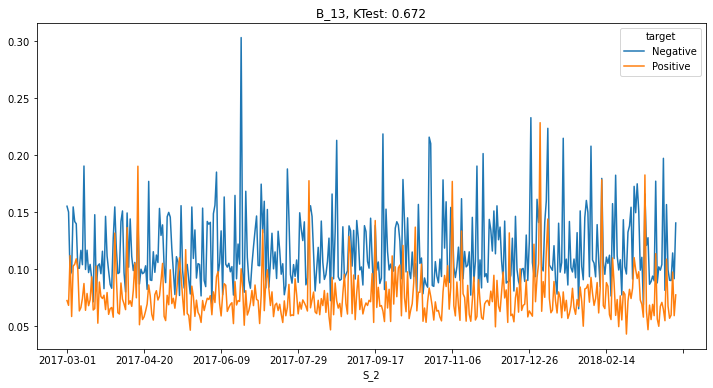

D_79


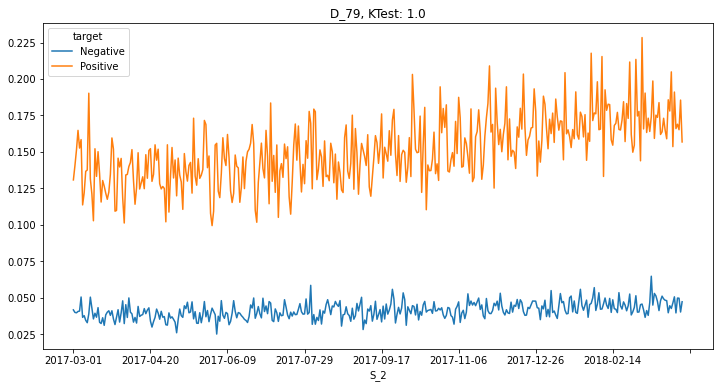

R_21


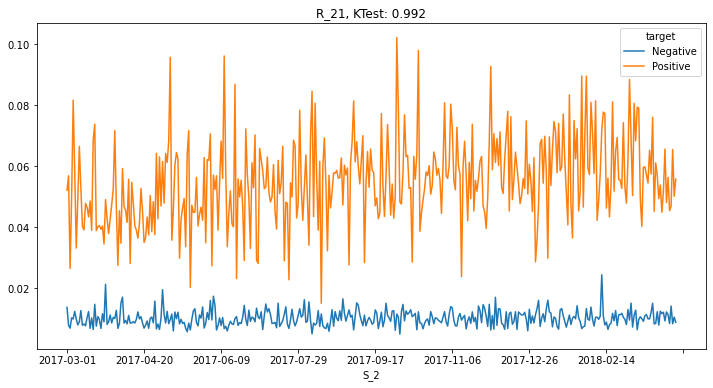

D_66


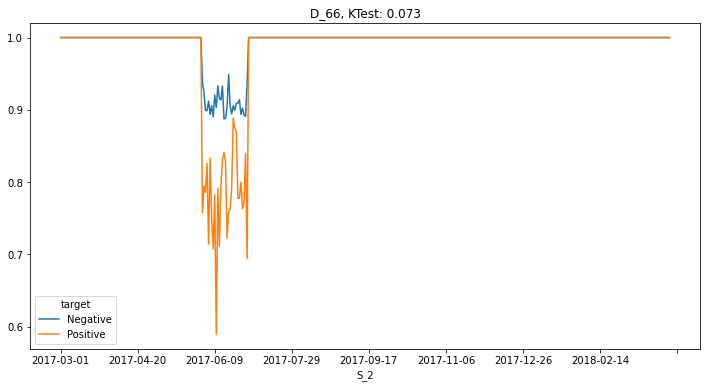

B_2


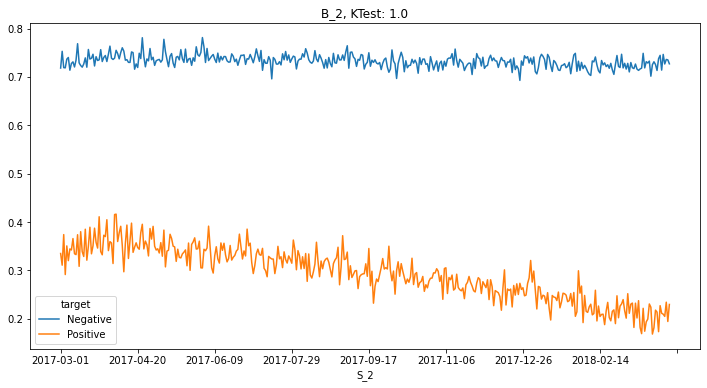

R_15


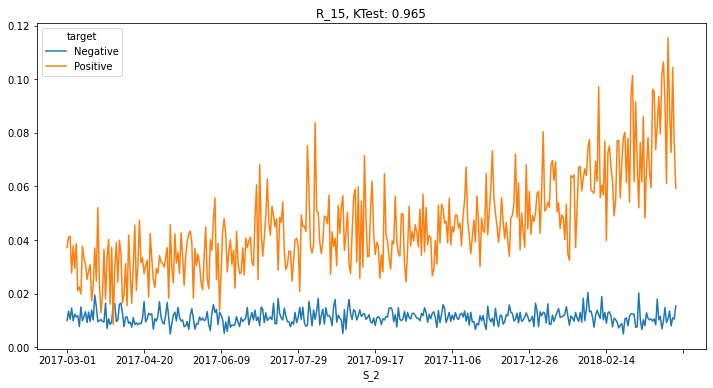

R_18


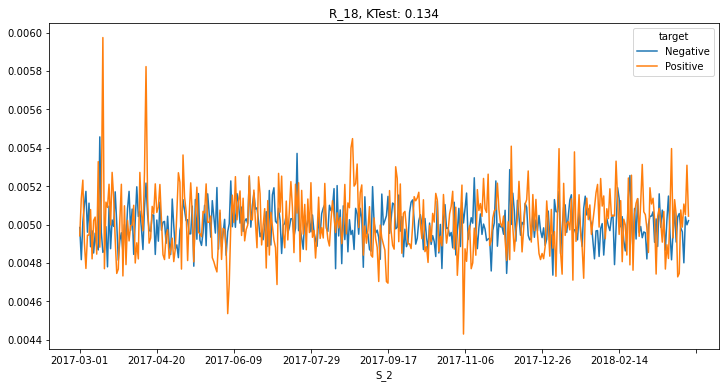

D_107


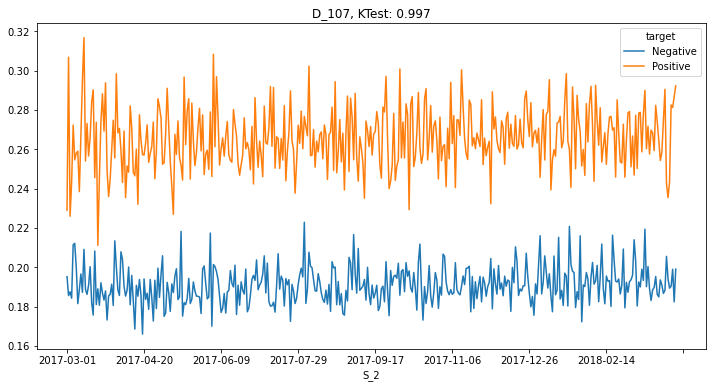

D_114


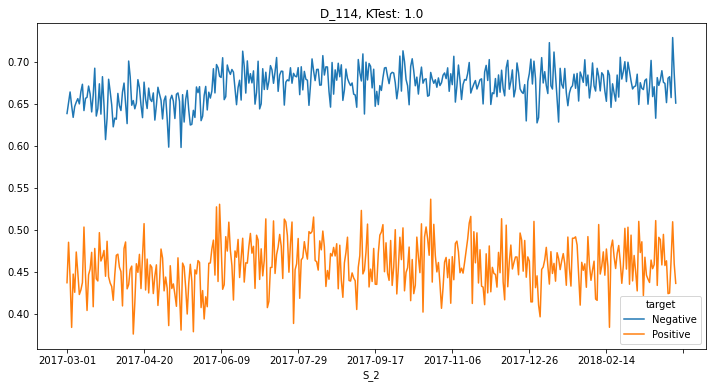

D_121


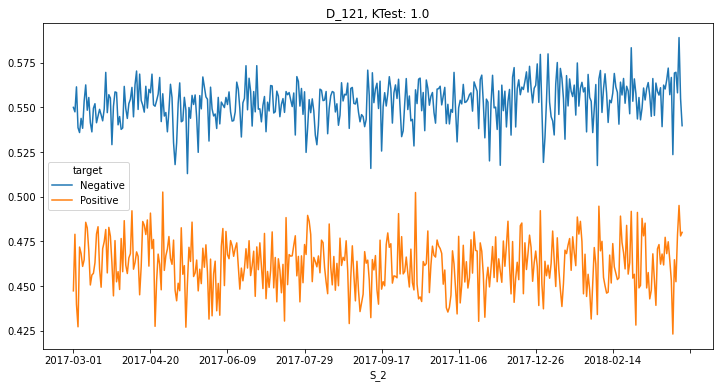

D_77


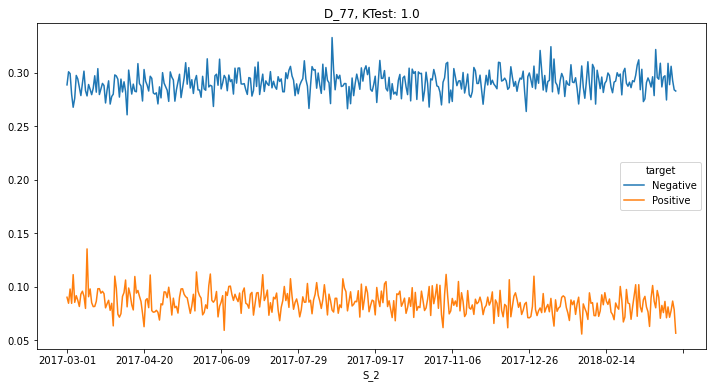

D_59


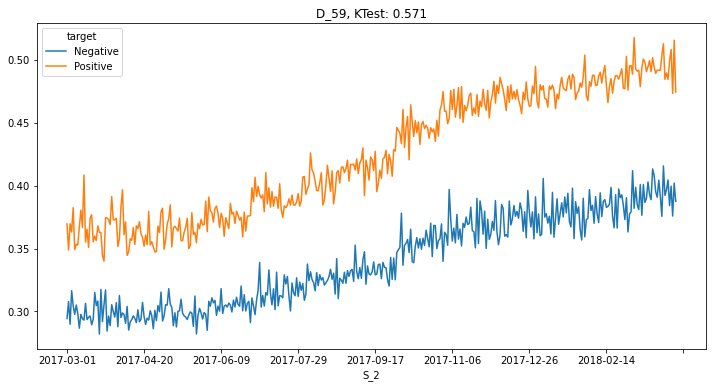

R_6


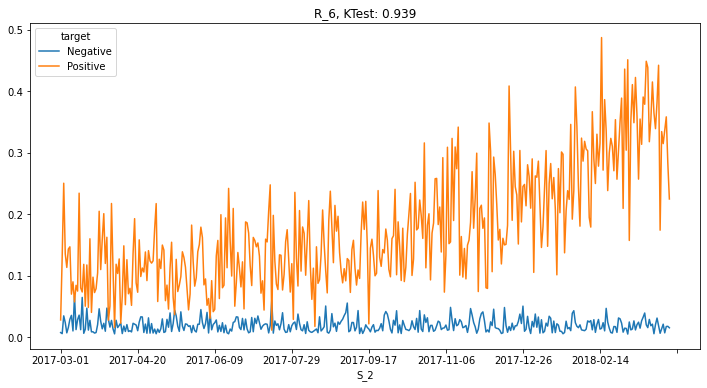

B_14


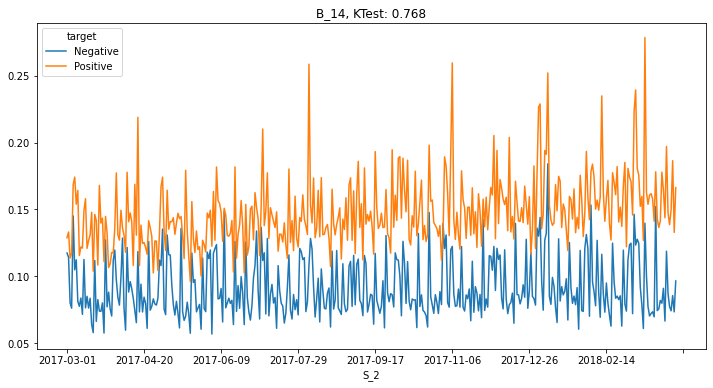

P_2


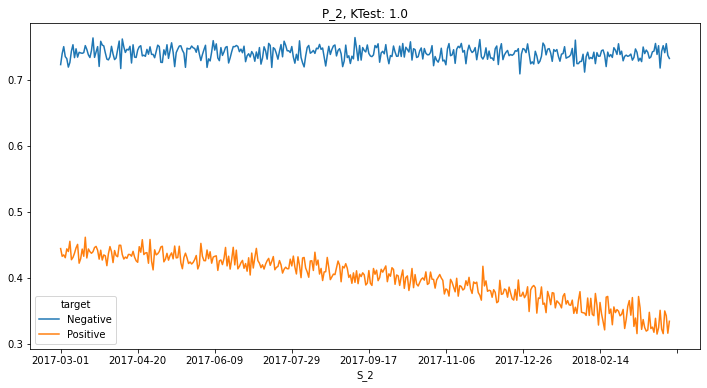

D_104


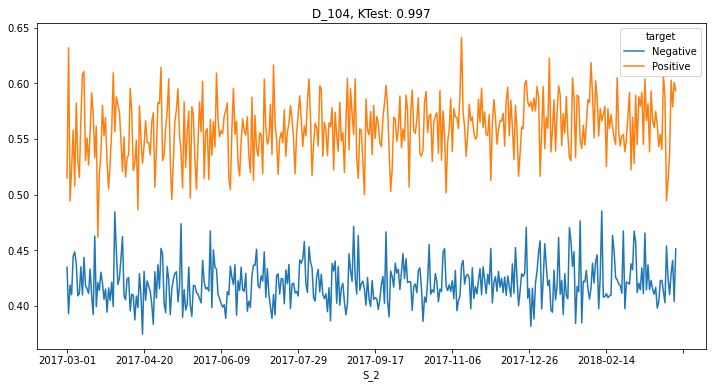

D_49


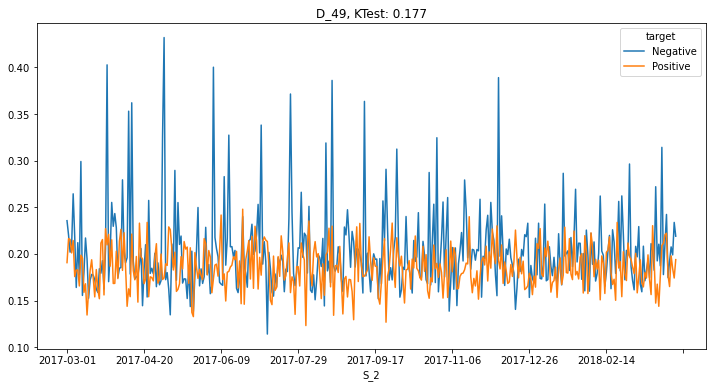

R_13


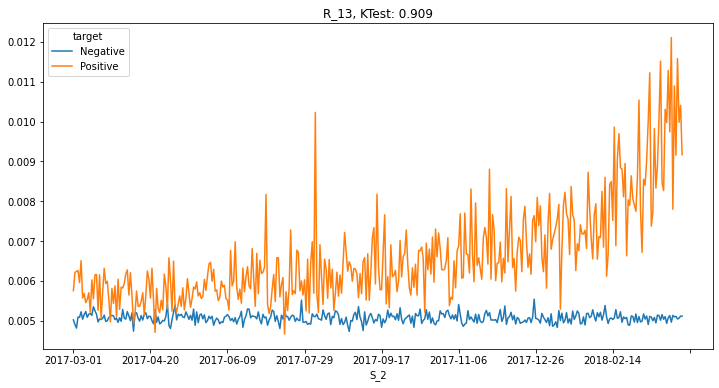

D_110


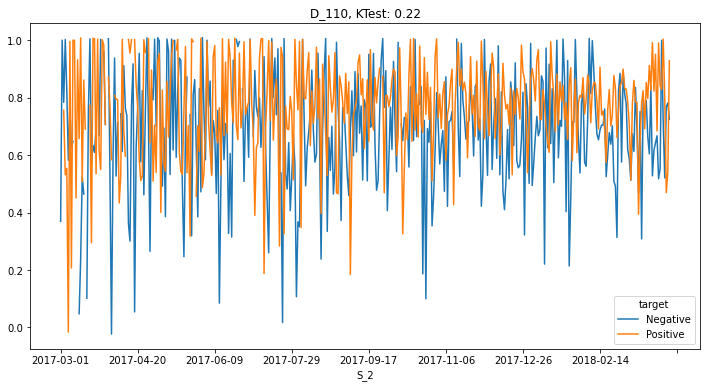

D_119


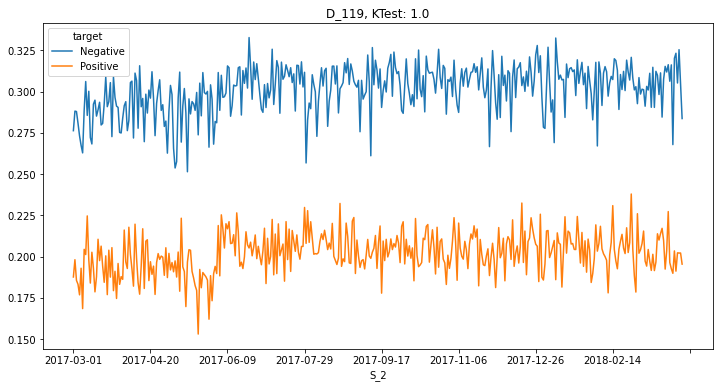

D_50


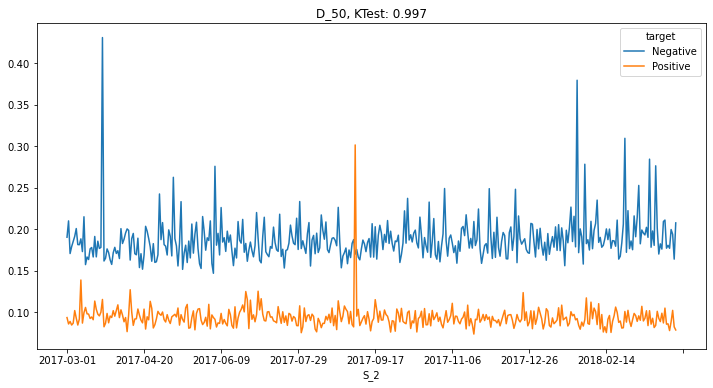

B_42


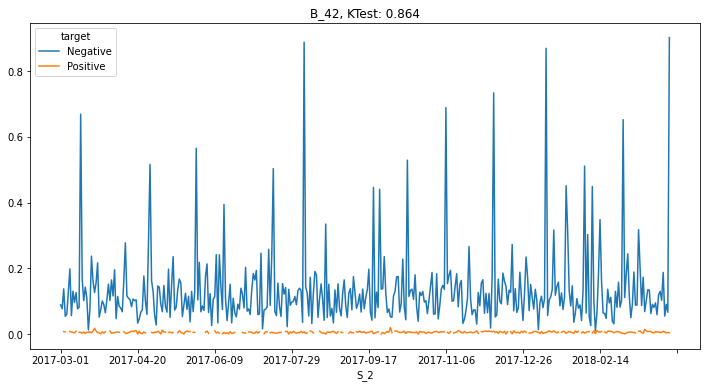

D_126


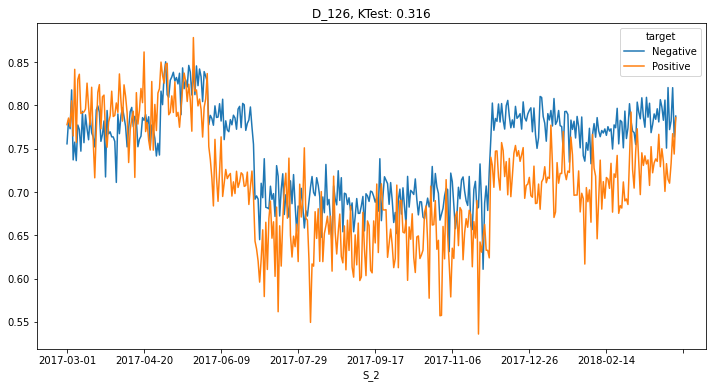

D_111


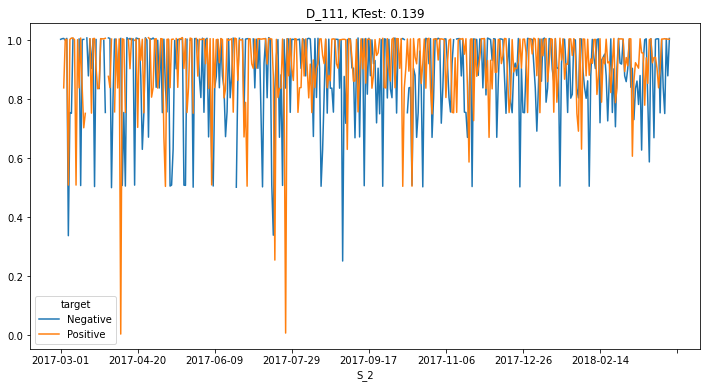

D_108


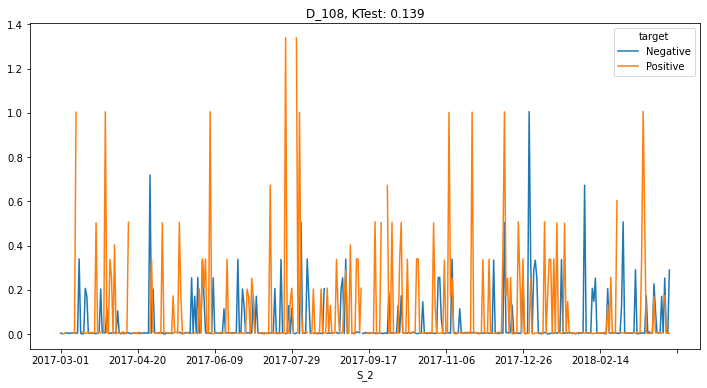

D_120


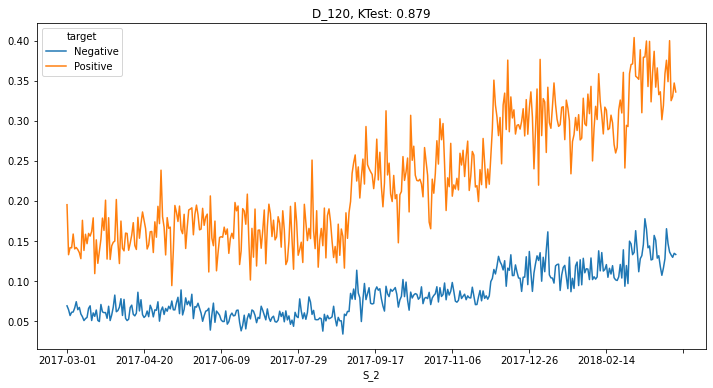

D_112


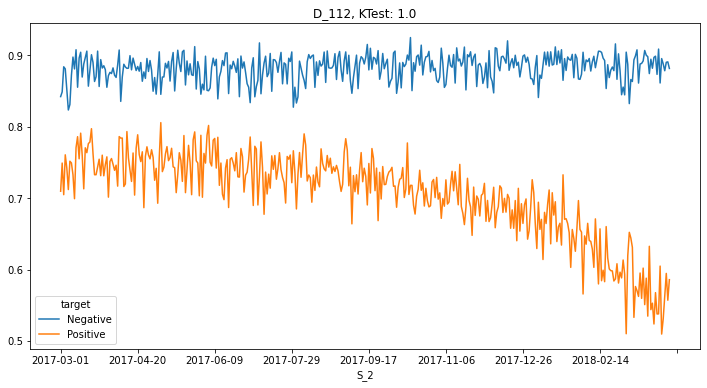

D_41


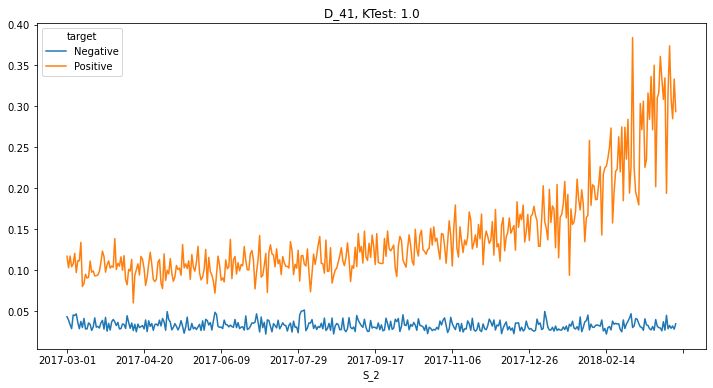

D_128


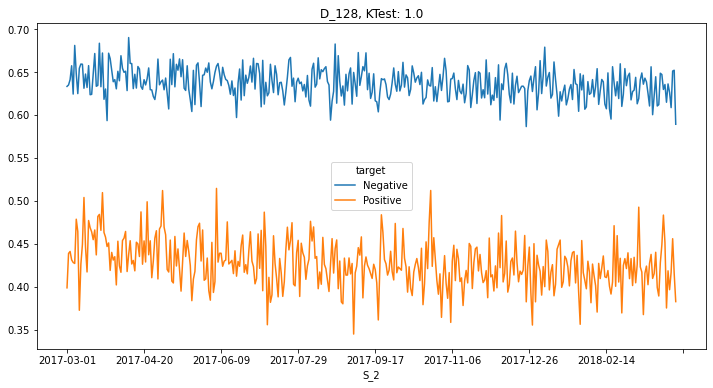

D_42


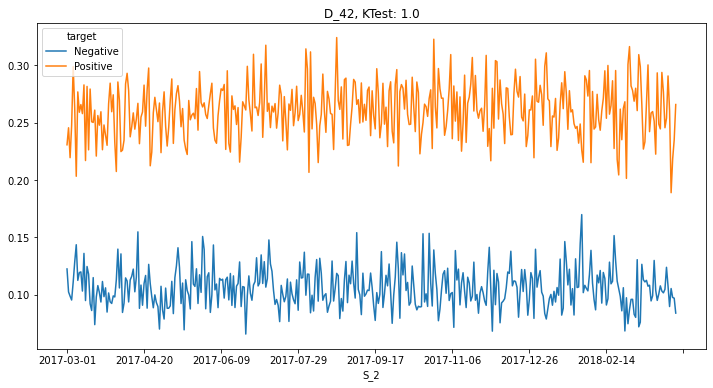

R_1


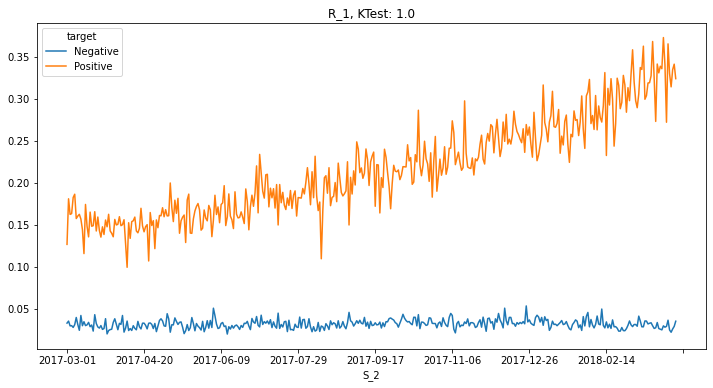

B_8


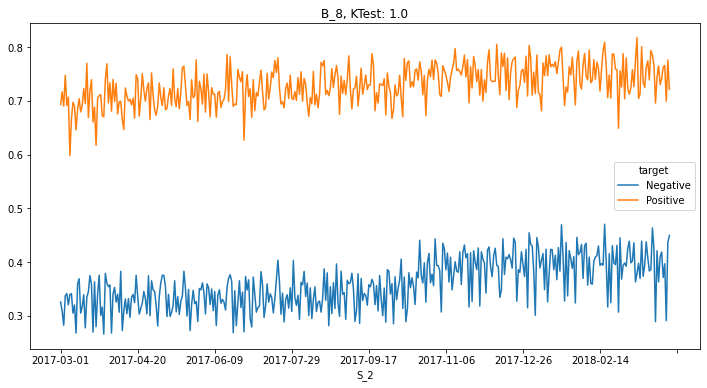

S_22


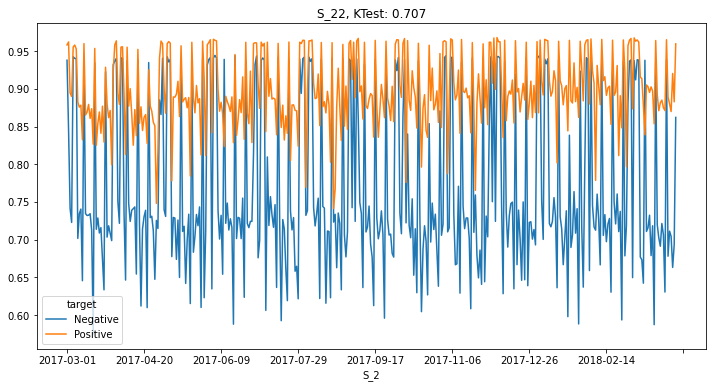

D_103


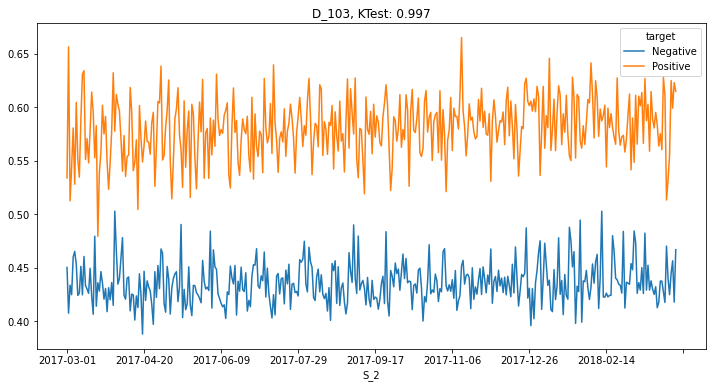

D_70


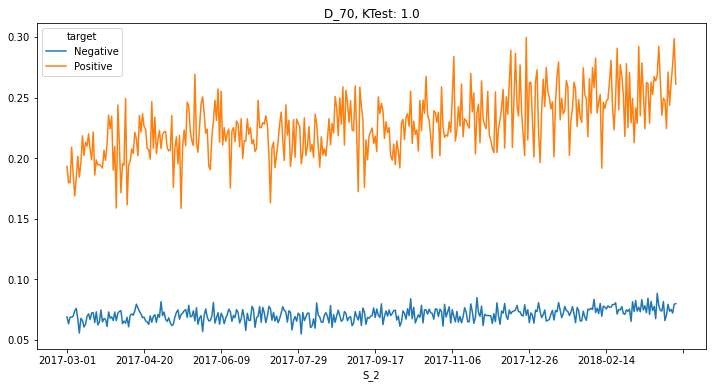

B_30


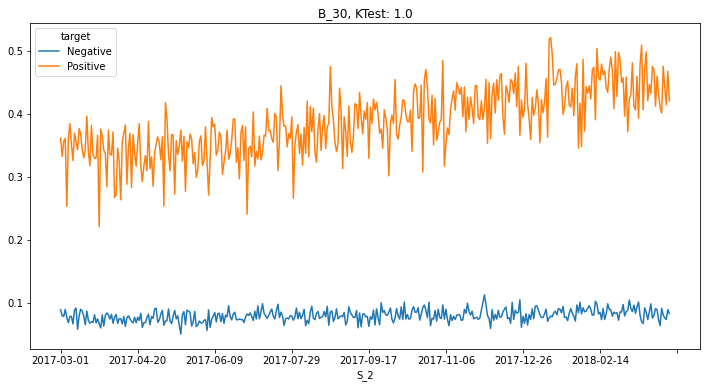

P_3


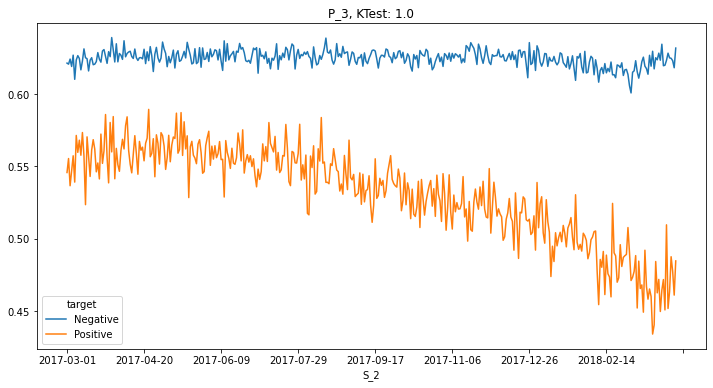

B_32


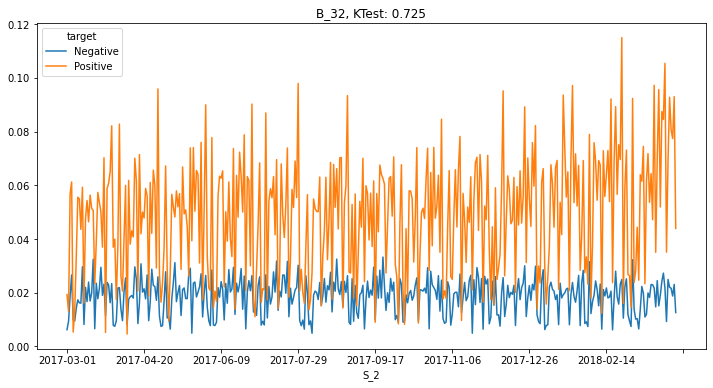

B_7


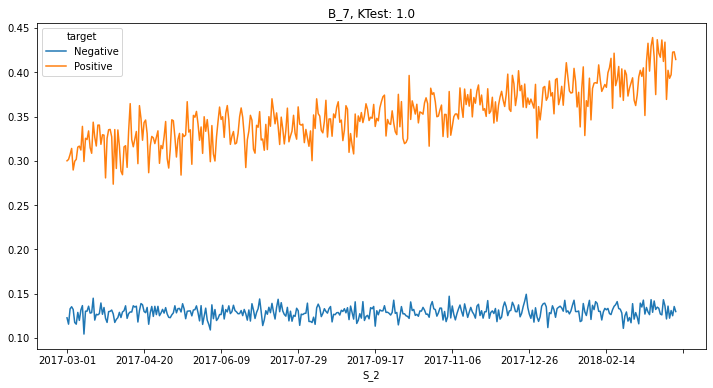

D_56


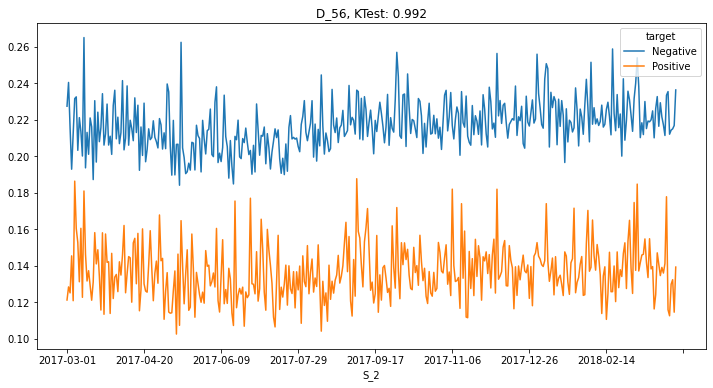

D_80


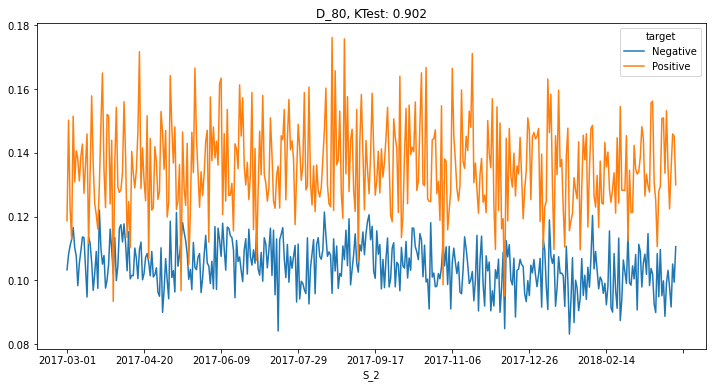

B_3


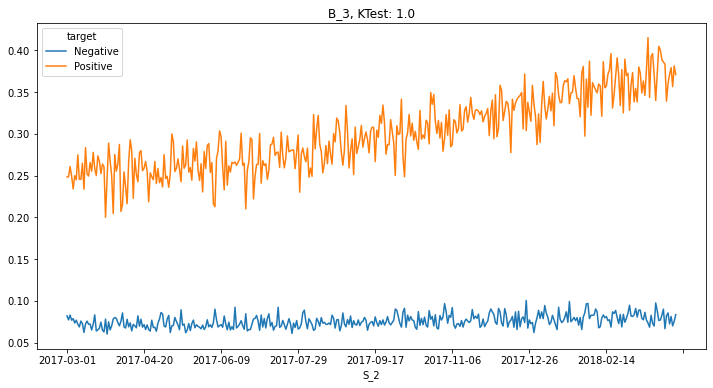

D_74


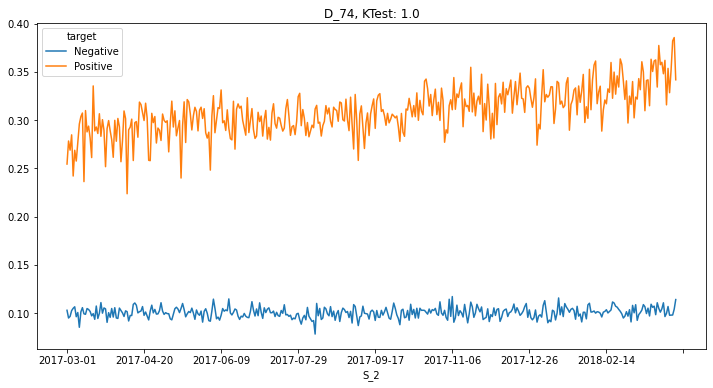

D_82


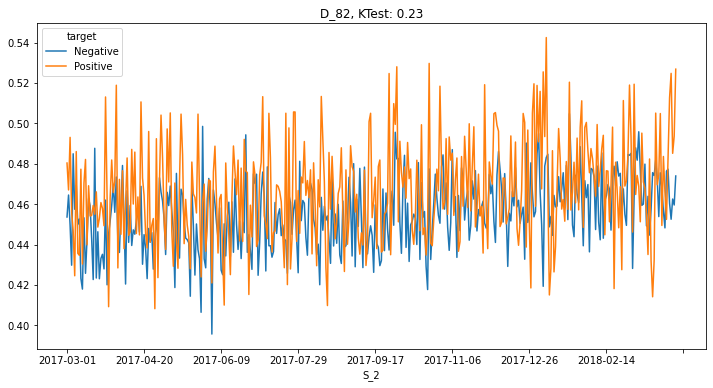

B_16


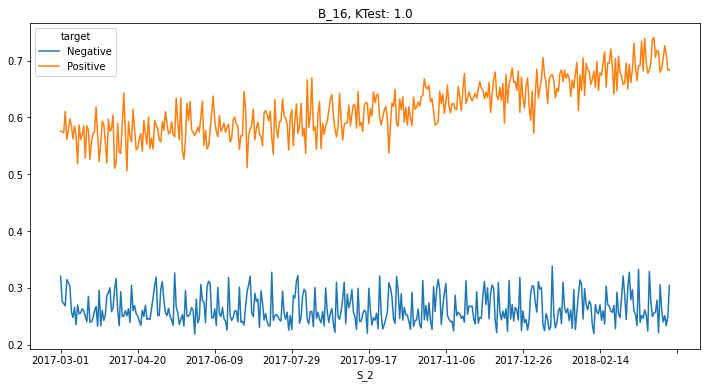

B_20


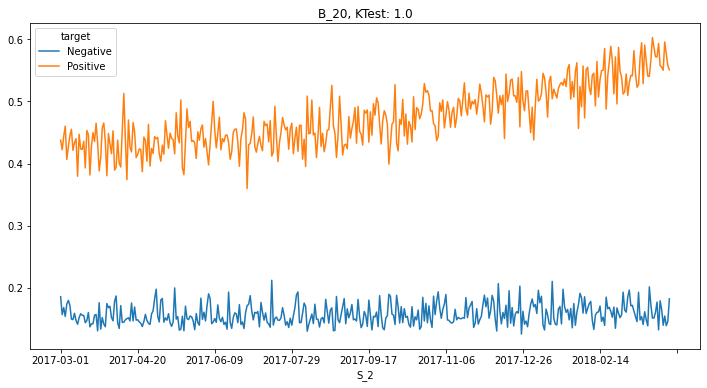

D_72


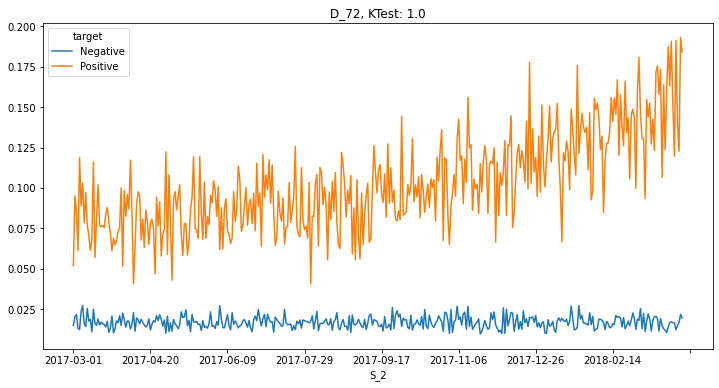

B_41


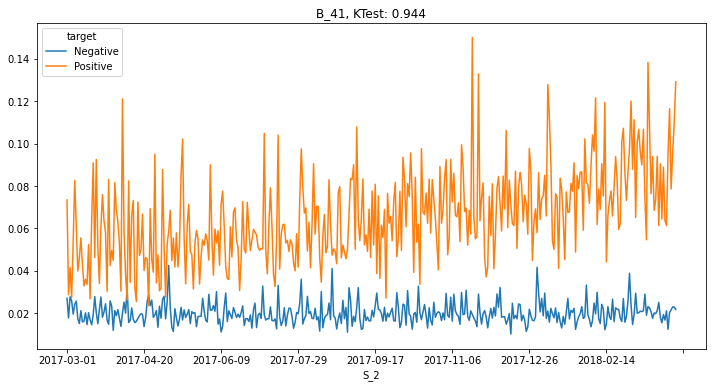

D_76


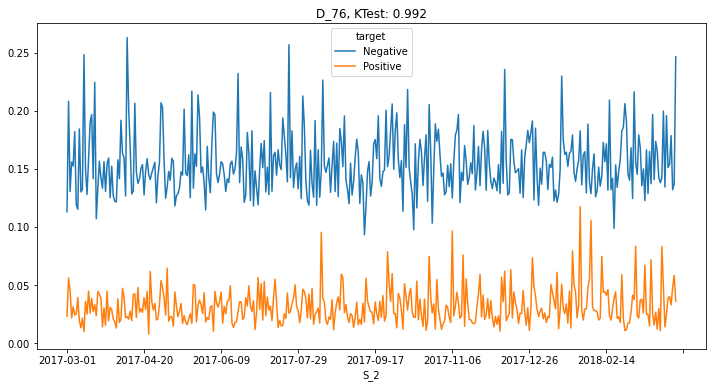

D_145


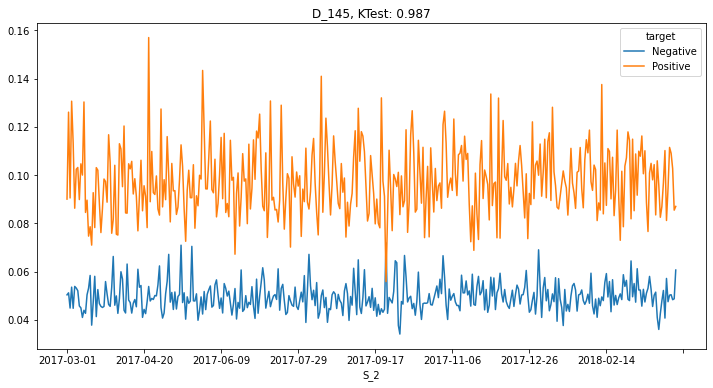

B_5


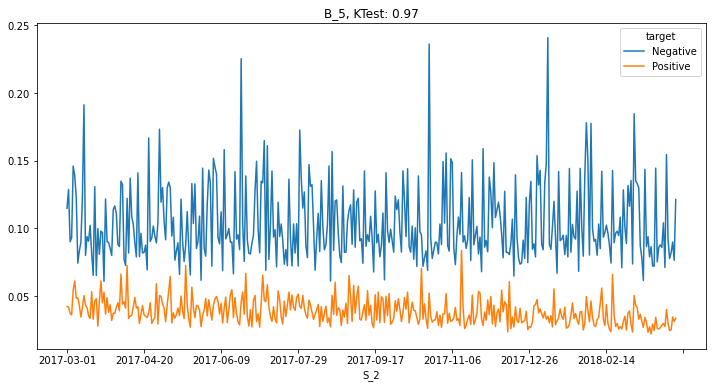

D_116


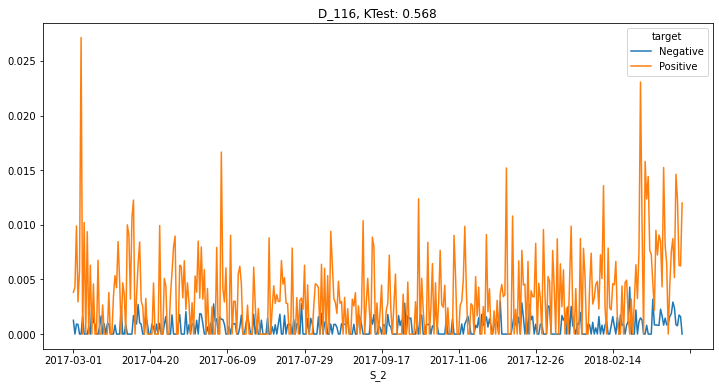

R_22


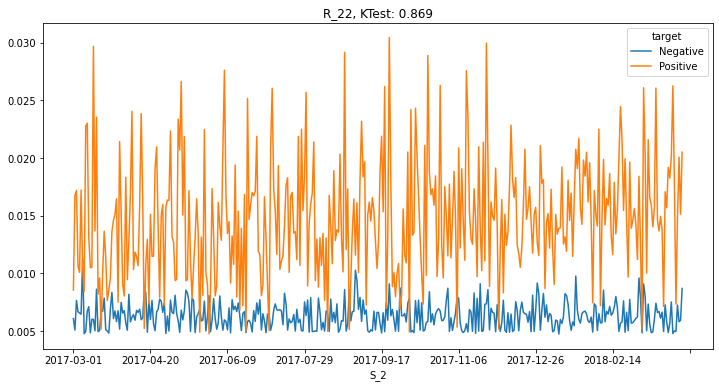

R_4


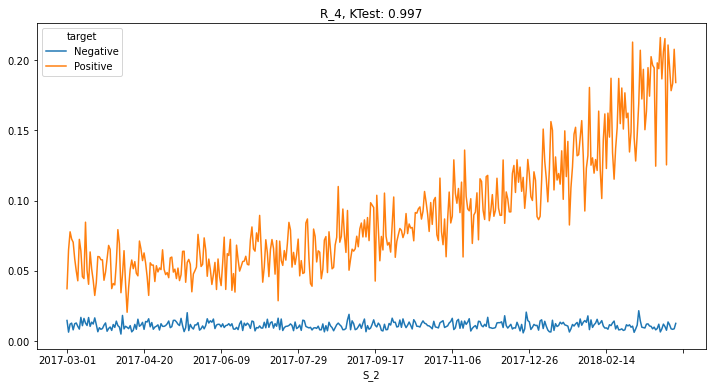

B_31


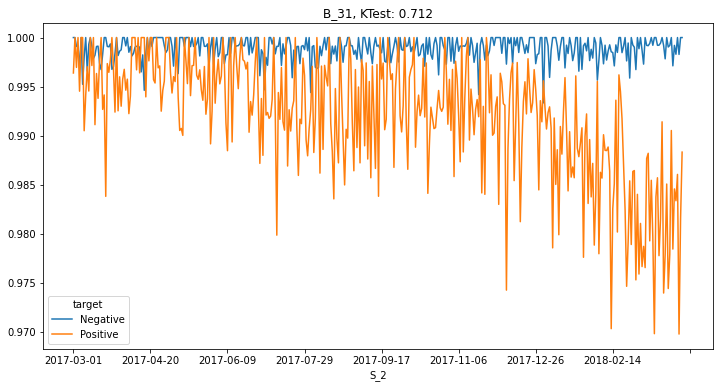

S_19


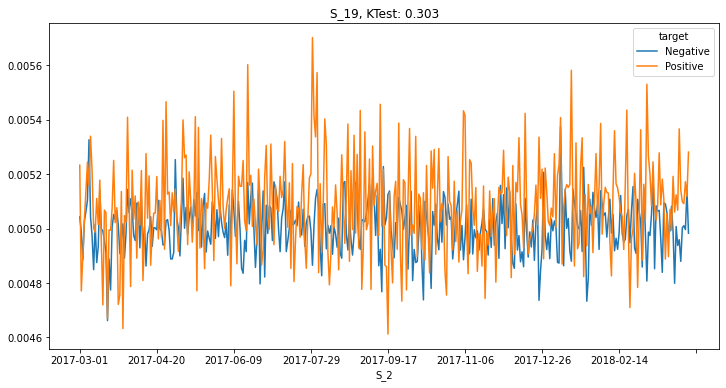

D_96


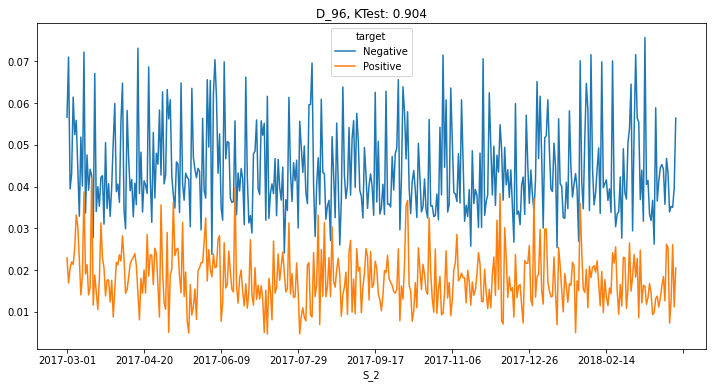

R_27


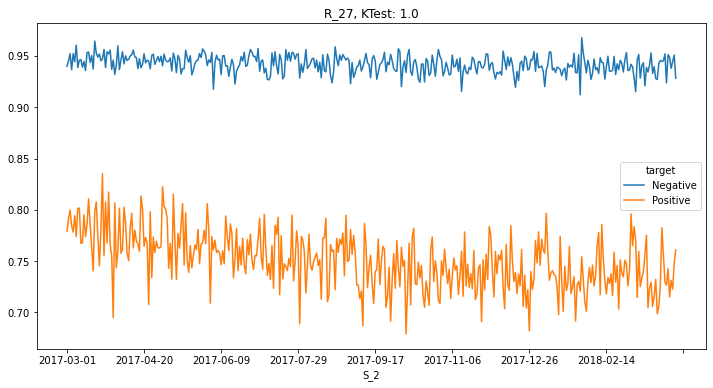

S_24


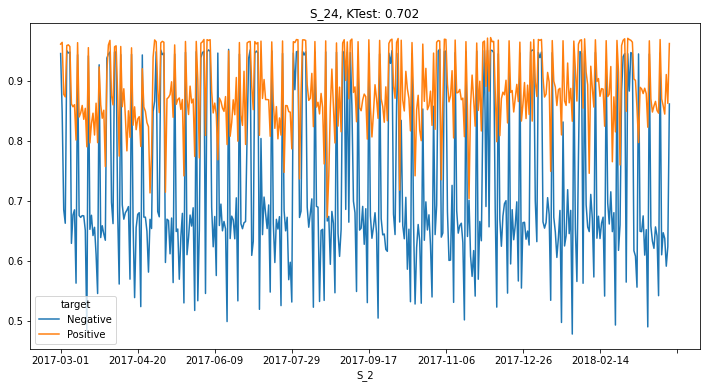

D_69


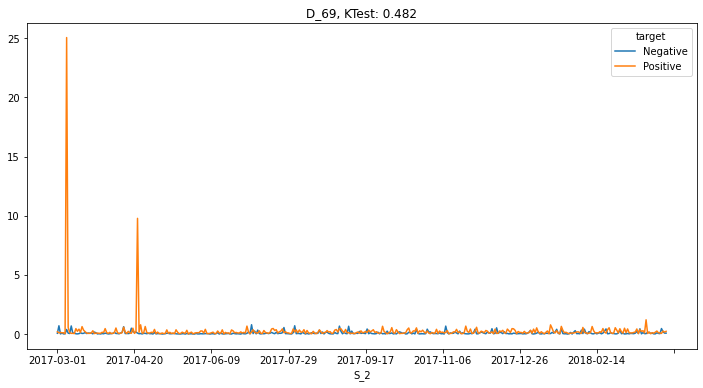

R_5


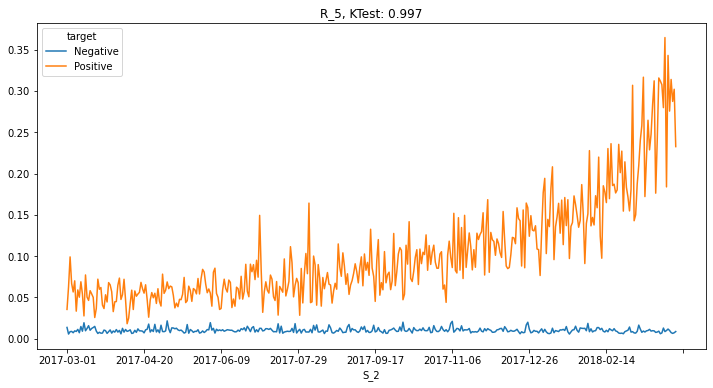

B_12


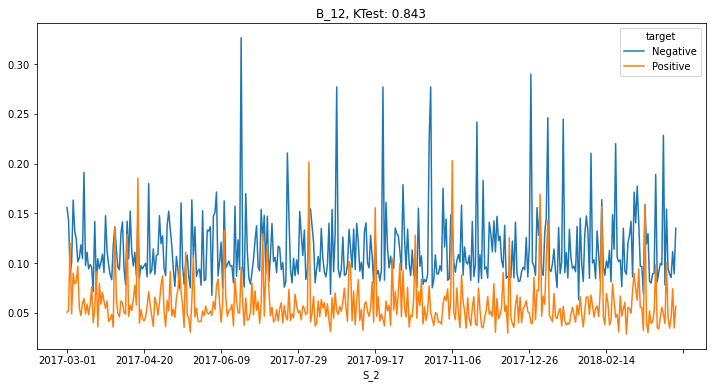

In [55]:
for feature_name in feature_names:
    print(feature_name)
    dt = daily_values_mean[feature_name].rename(columns={0:'Negative', 1:'Positive'})
    ks_statistics = np.round(ks_2samp(dt.Positive, dt.Negative).statistic, 3)
    dt.plot(title=f'{feature_name}, KTest: {ks_statistics}', figsize=(12,6))
    plt.show()

D_42


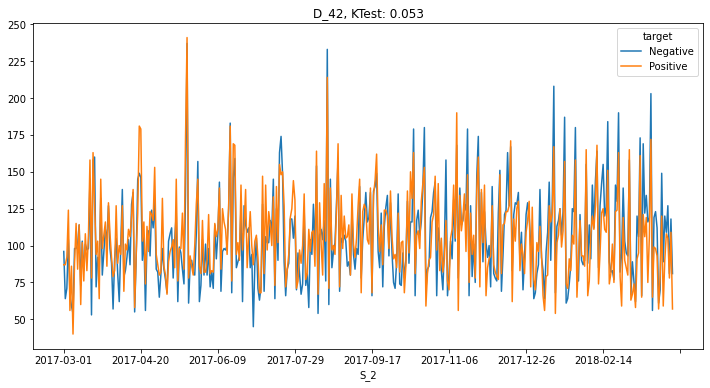

B_27


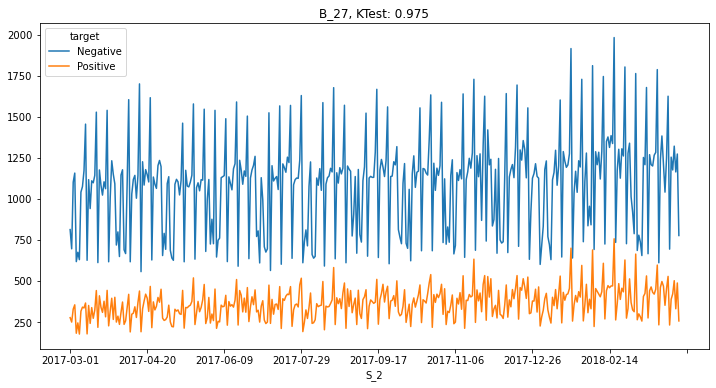

D_142


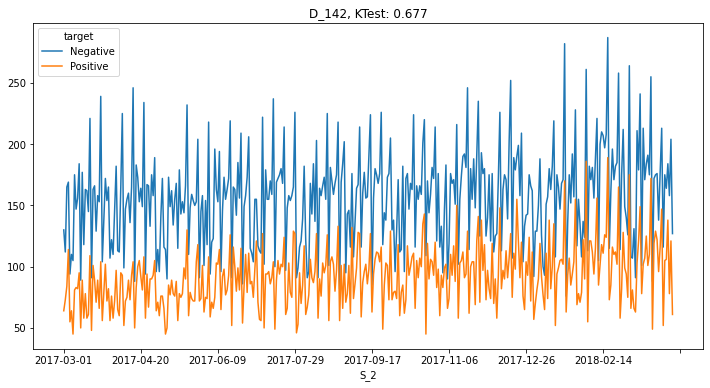

S_7


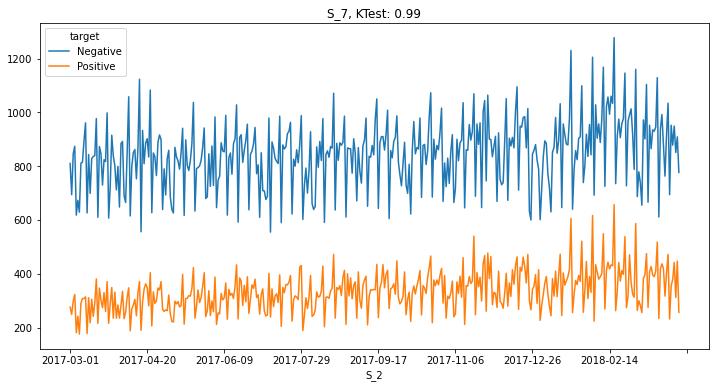

B_2


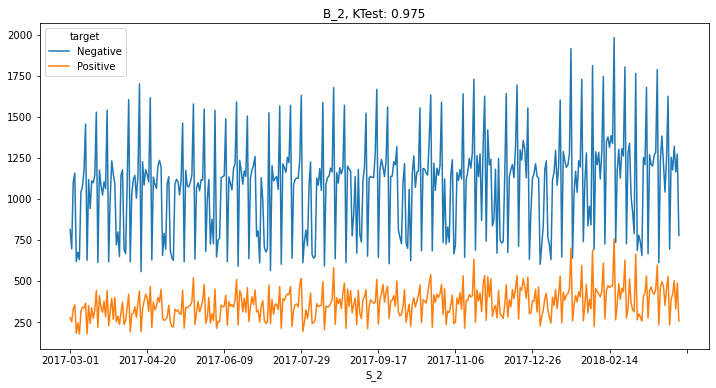

S_5


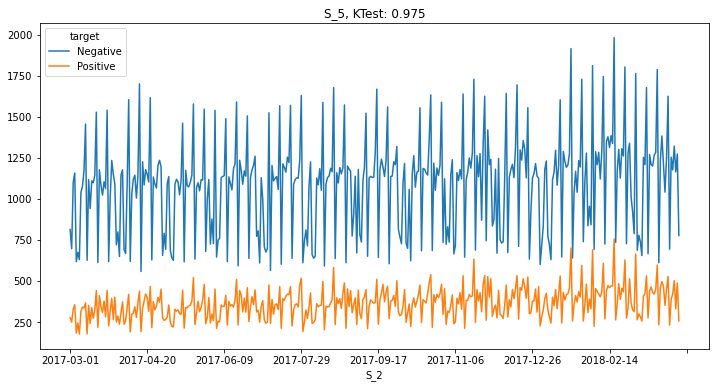

B_25


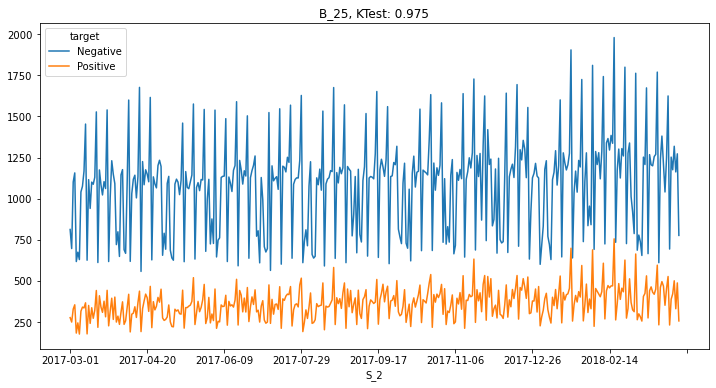

R_1


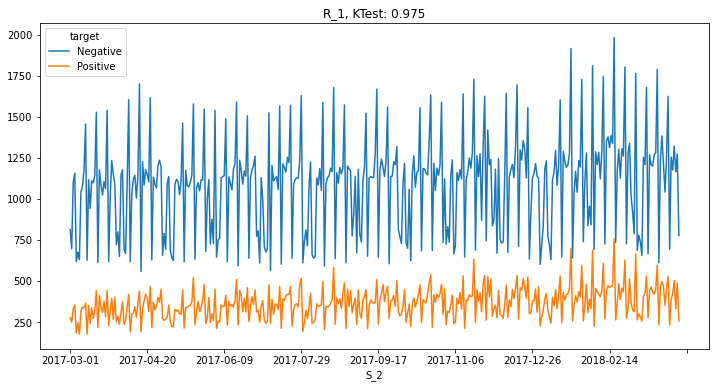

S_12


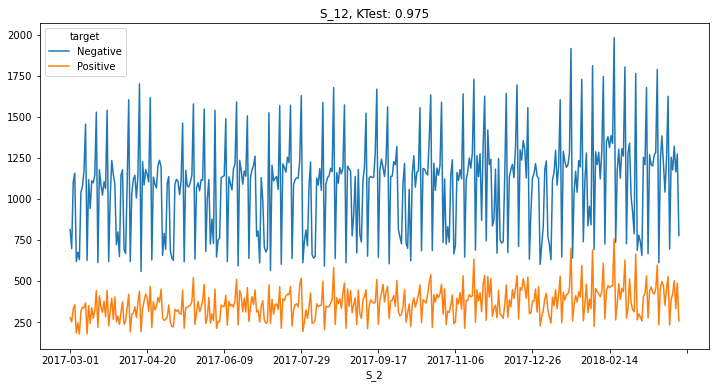

D_126


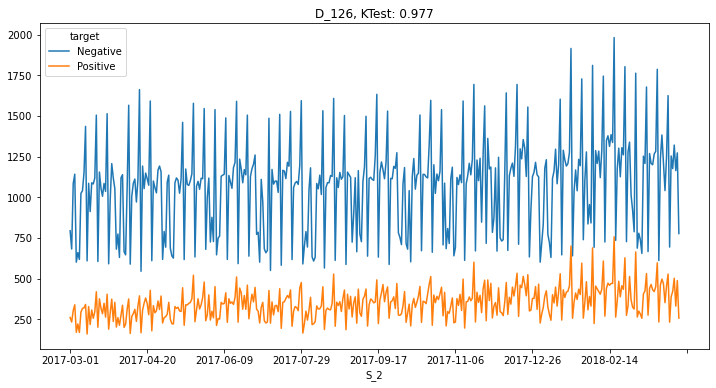

D_88


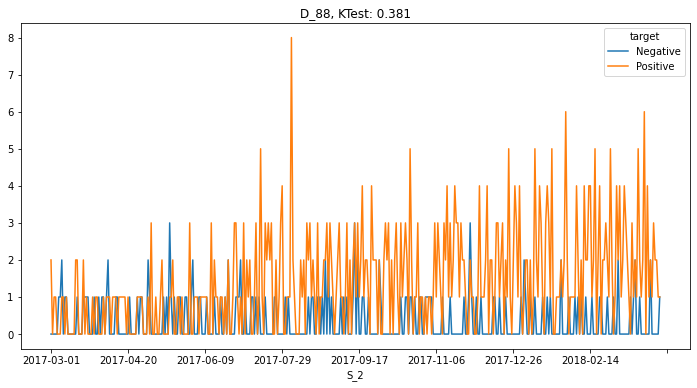

D_129


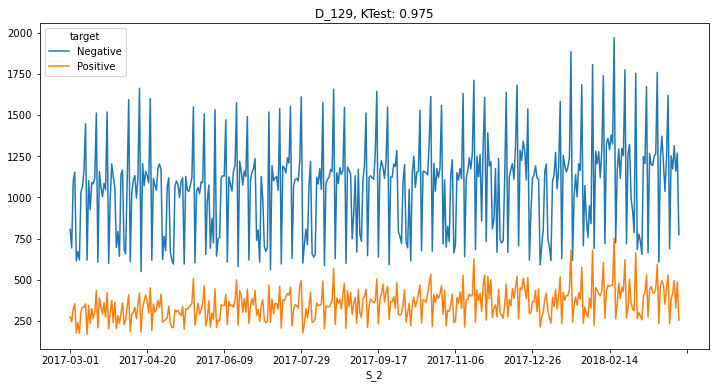

R_17


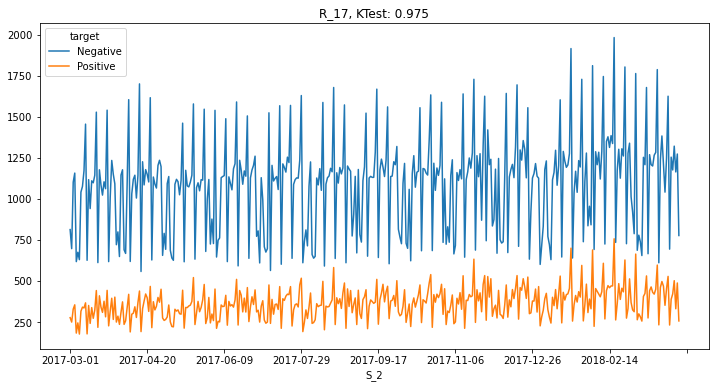

D_66


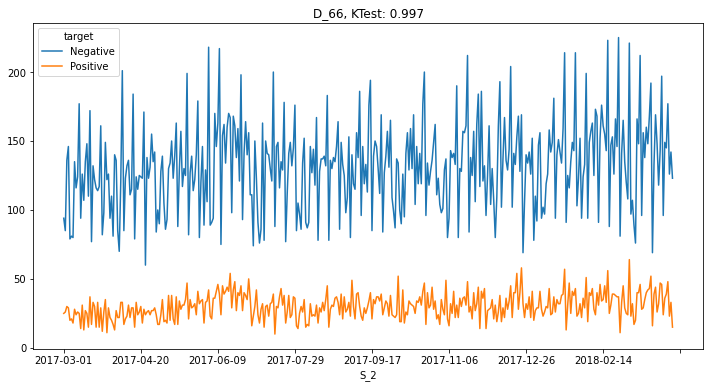

B_41


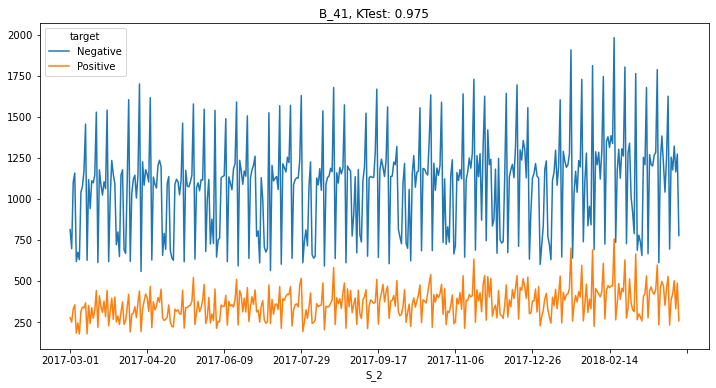

B_30


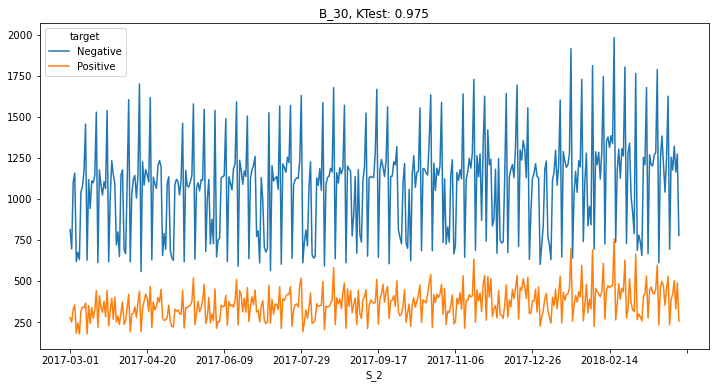

B_21


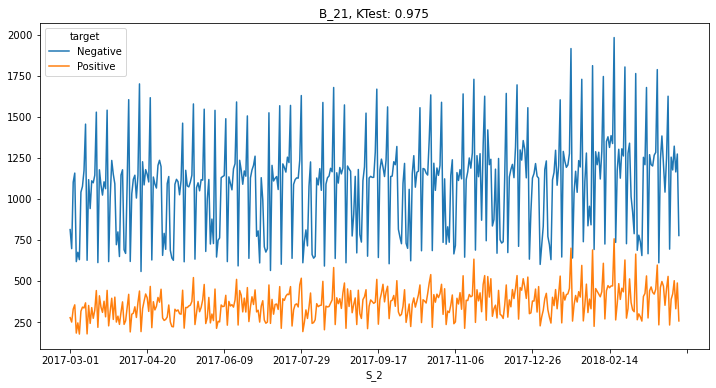

D_92


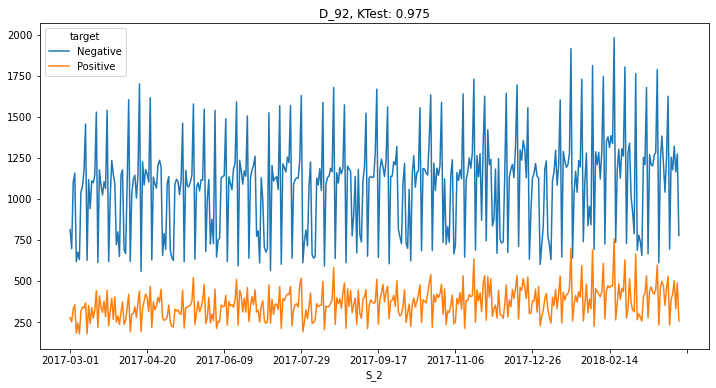

D_49


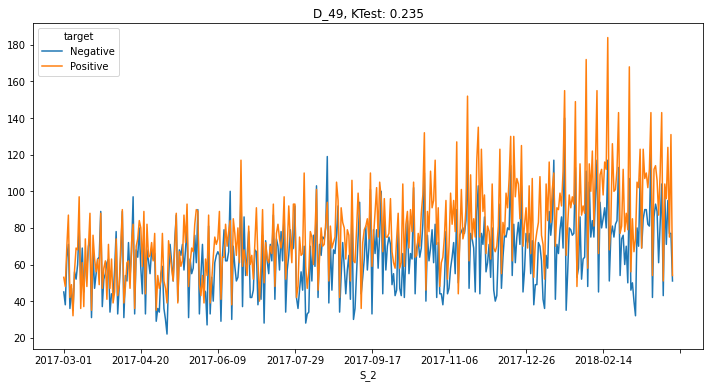

B_7


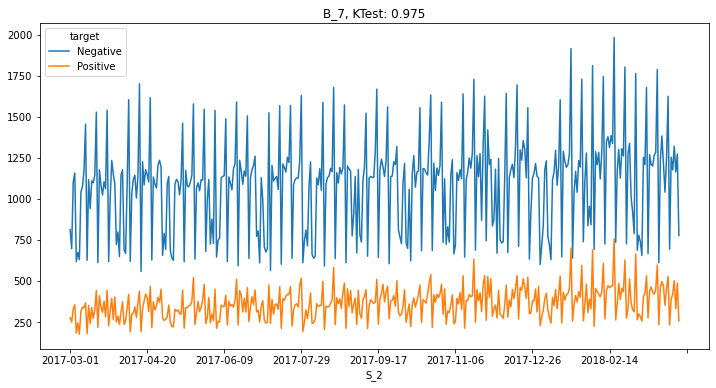

B_11


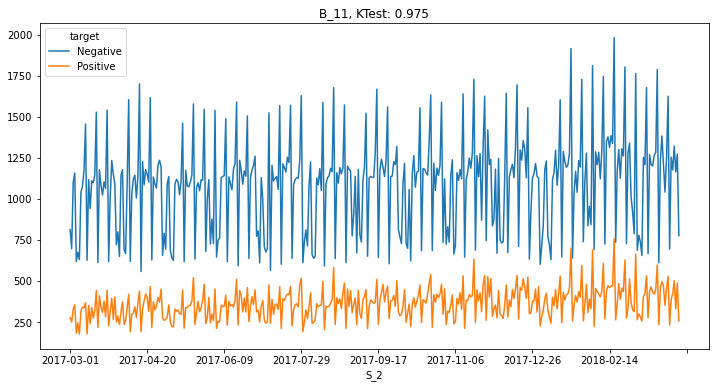

R_15


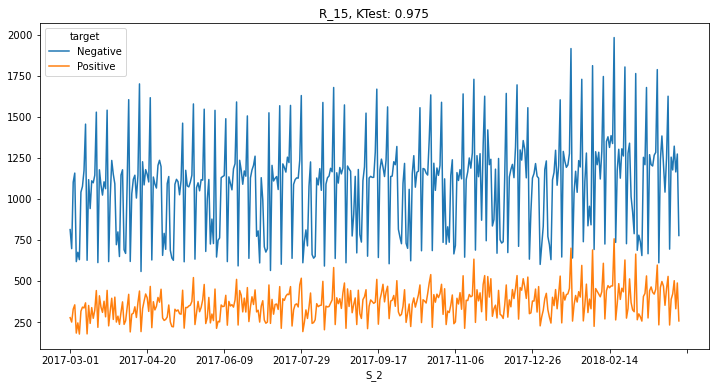

D_89


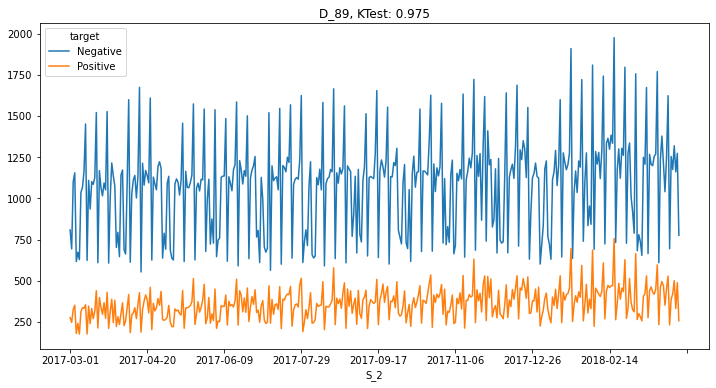

R_21


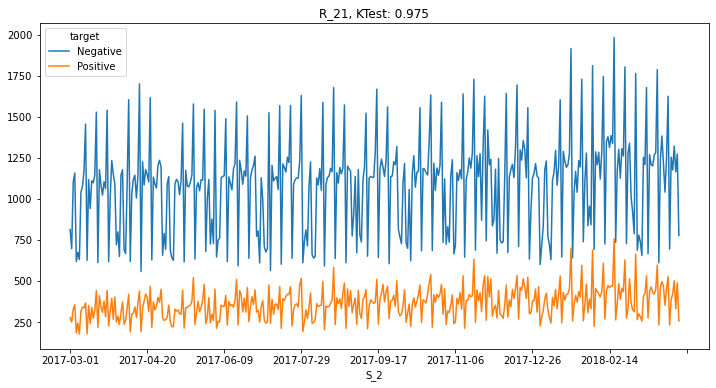

D_110


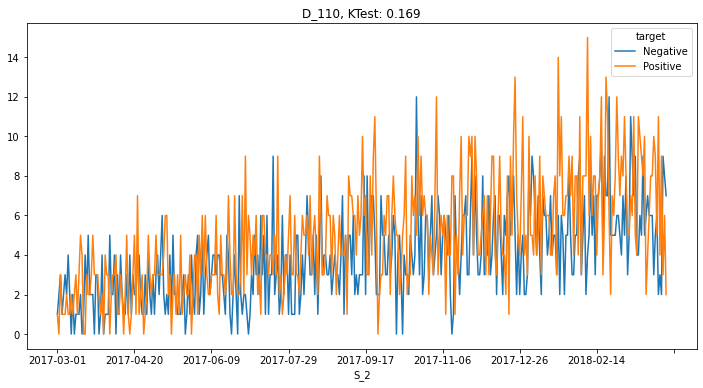

B_12


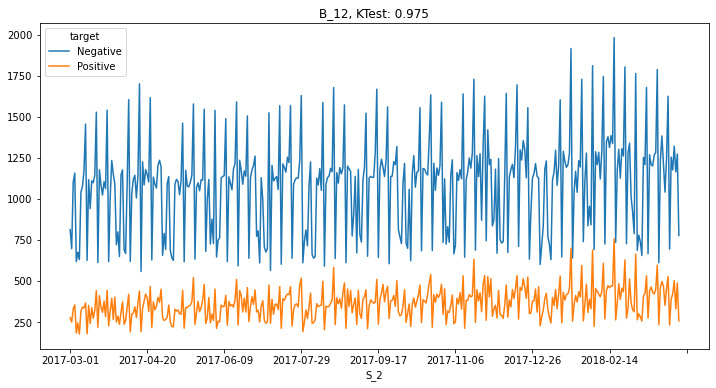

D_61


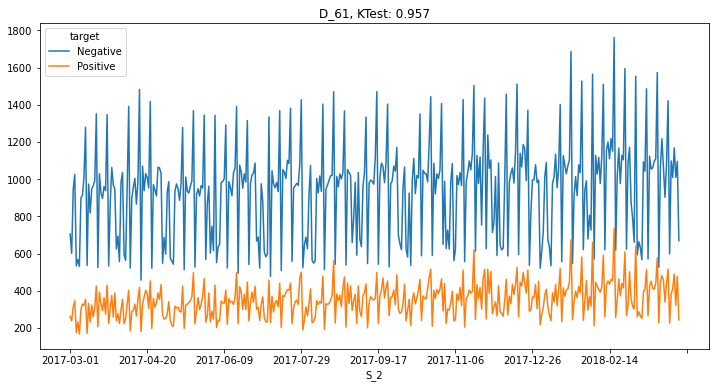

B_26


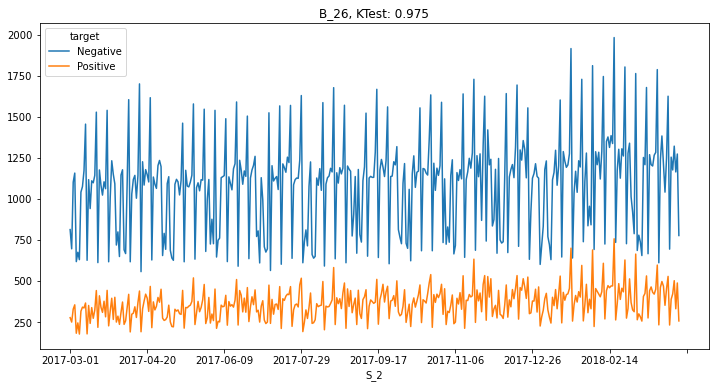

D_54


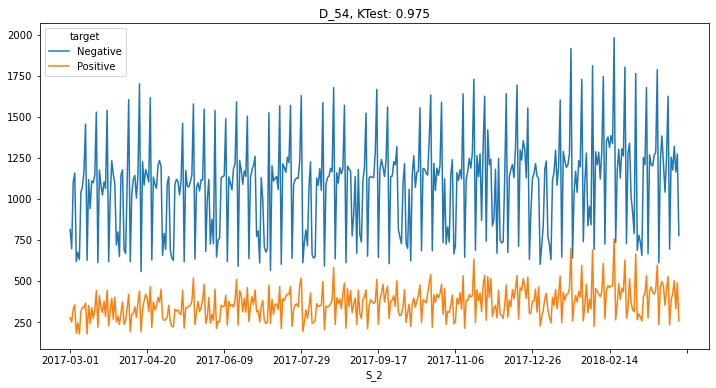

B_31


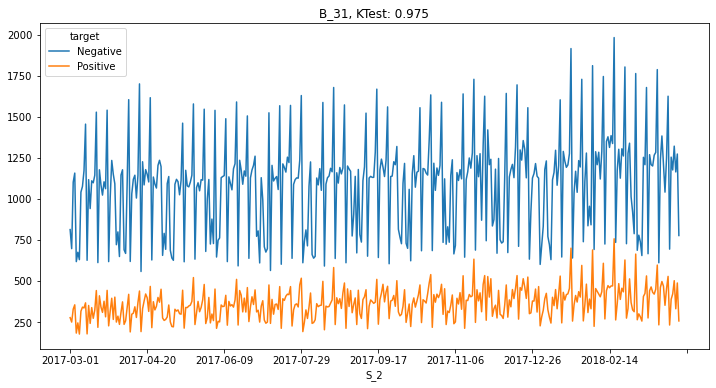

D_51


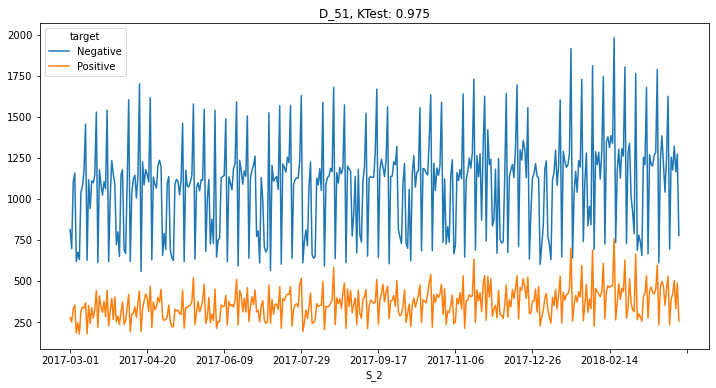

D_94


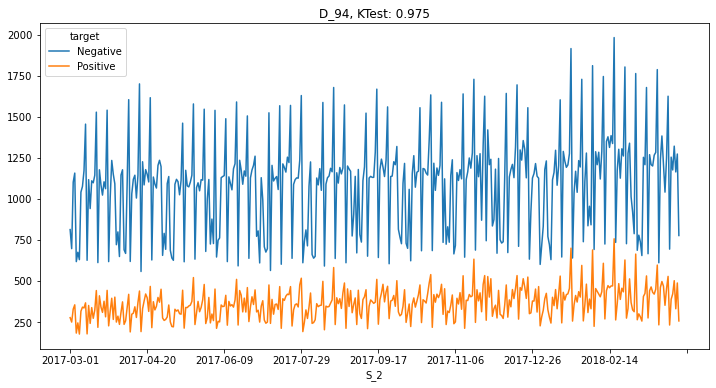

R_2


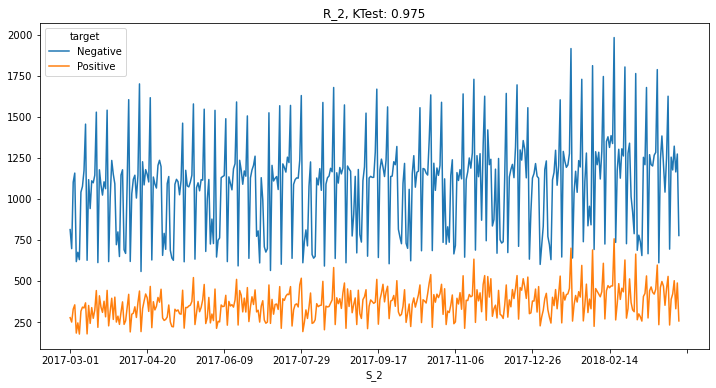

D_139


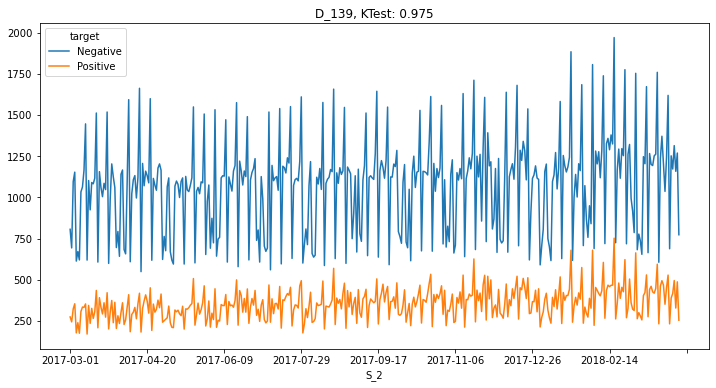

D_141


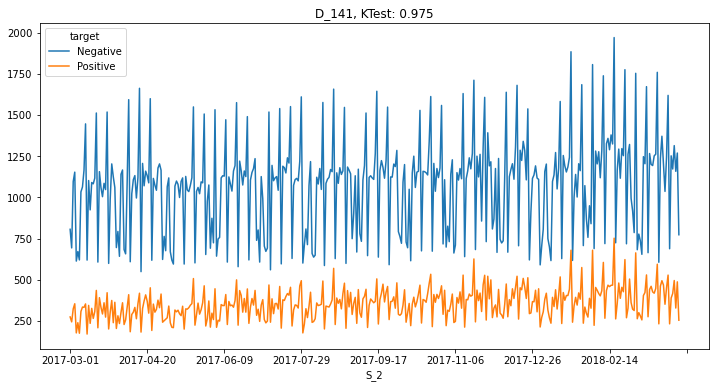

D_86


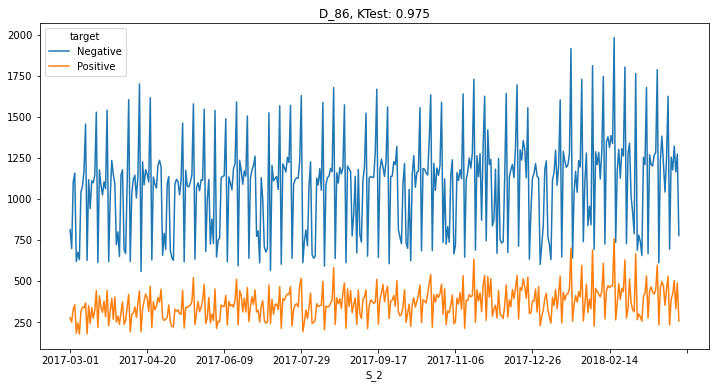

R_9


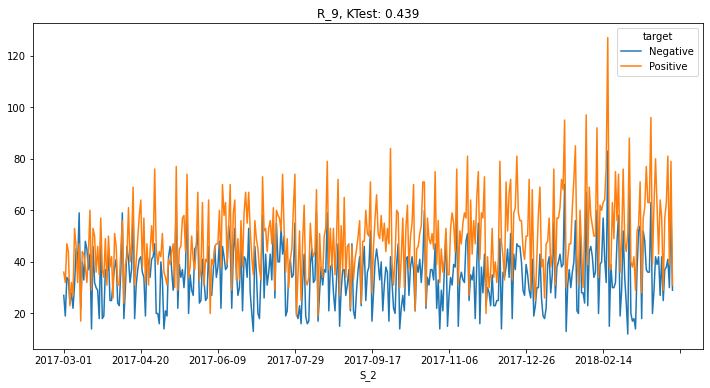

D_71


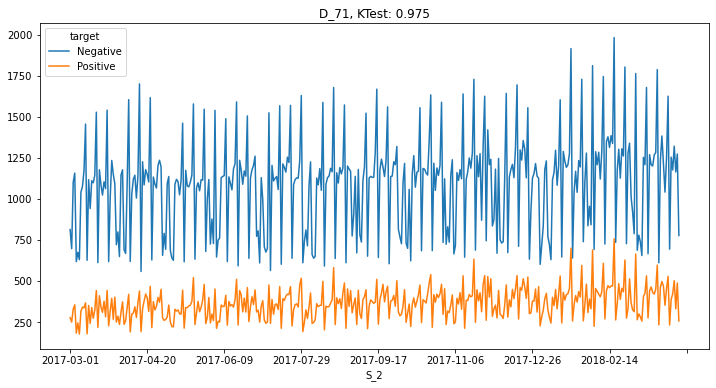

B_9


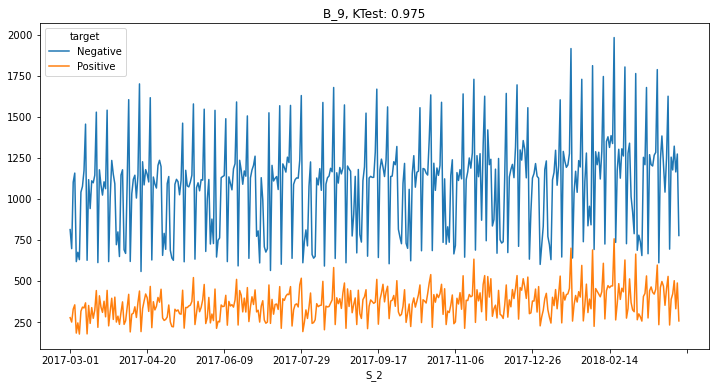

R_8


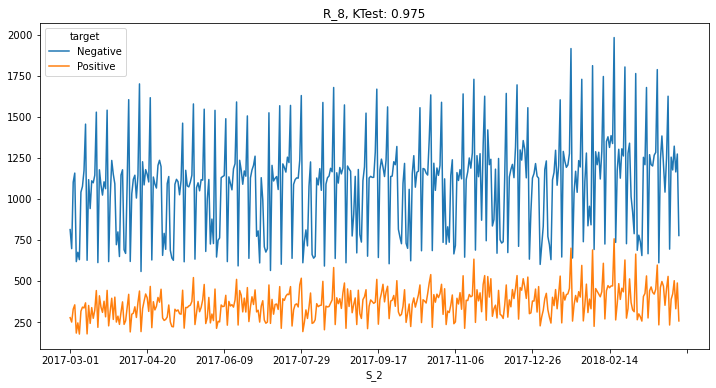

B_19


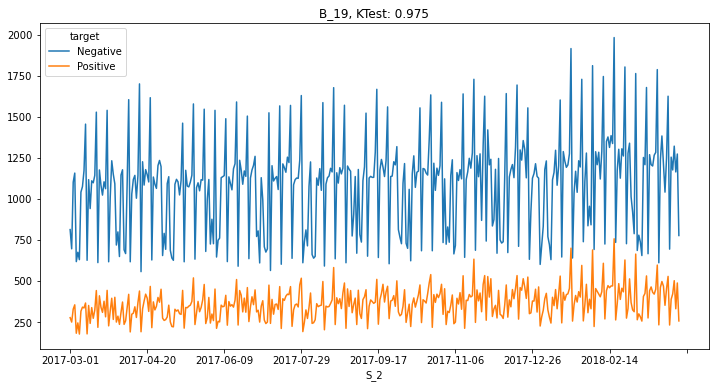

R_13


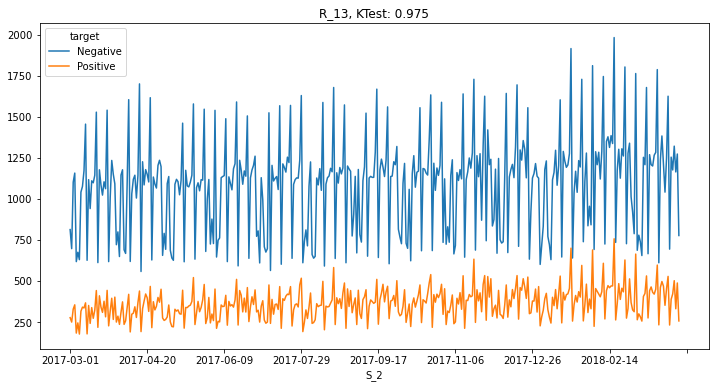

D_145


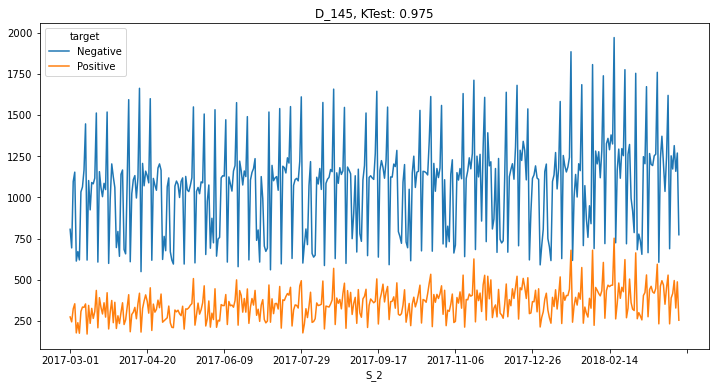

B_4


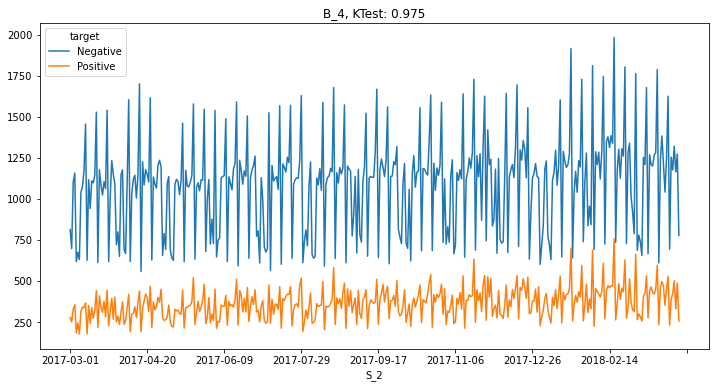

R_5


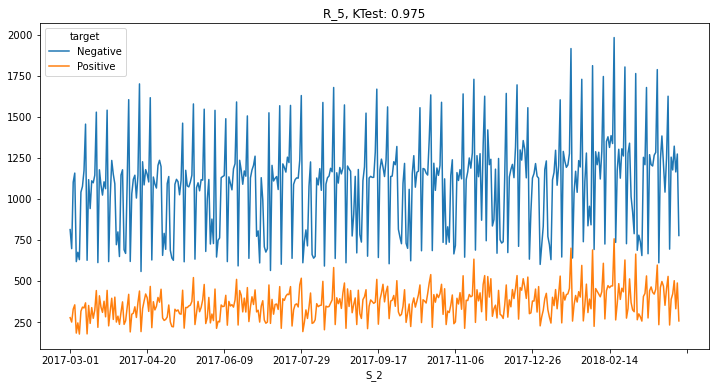

D_78


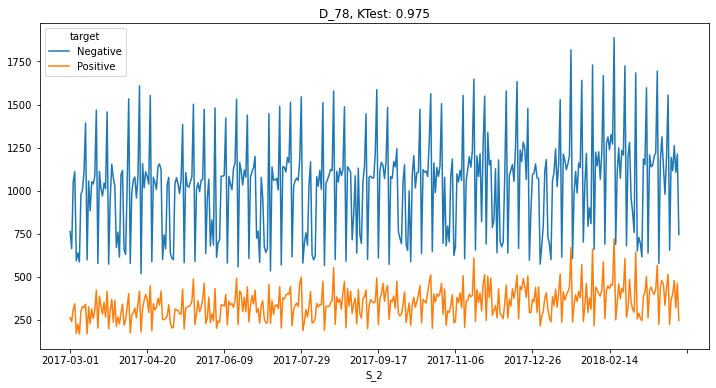

R_20


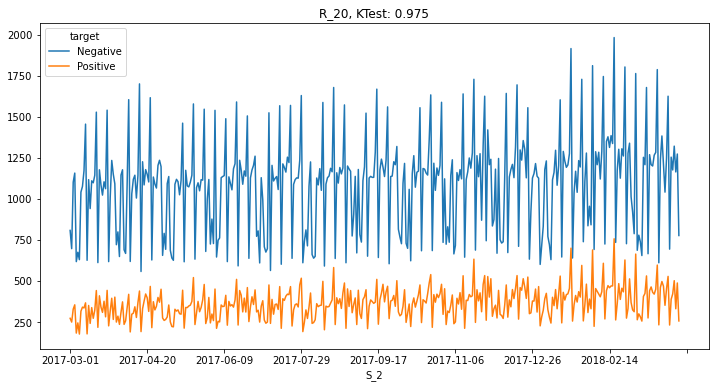

D_123


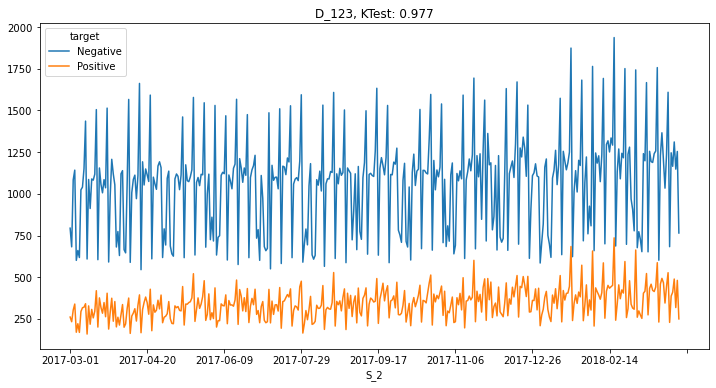

S_16


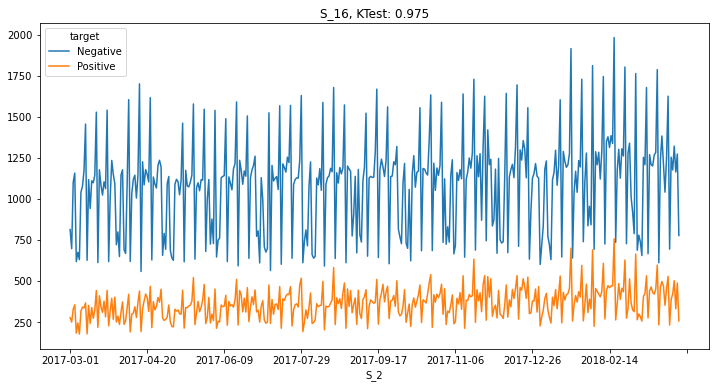

R_19


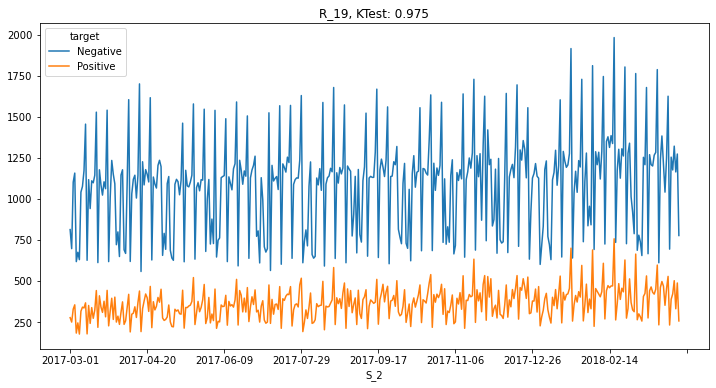

R_25


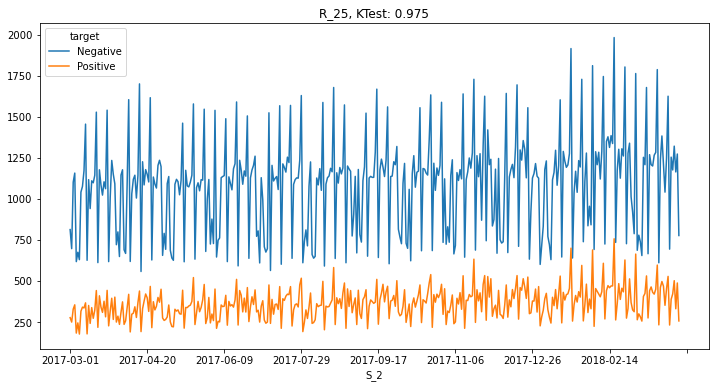

S_22


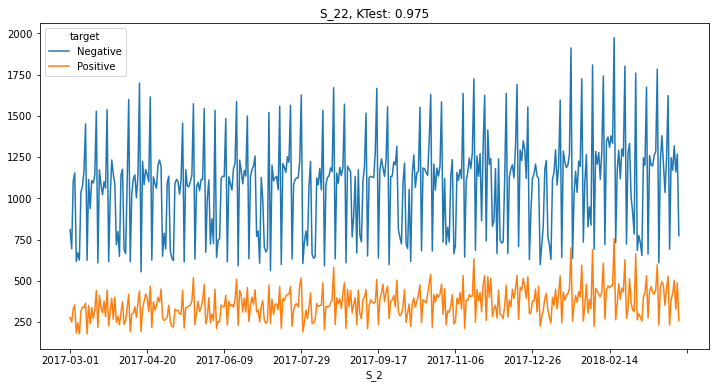

rank_per_user


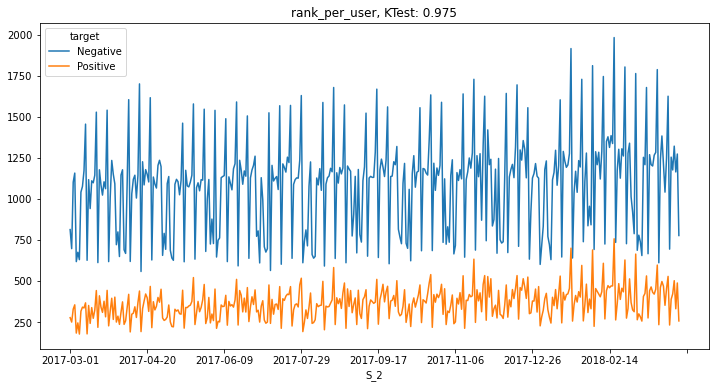

D_39


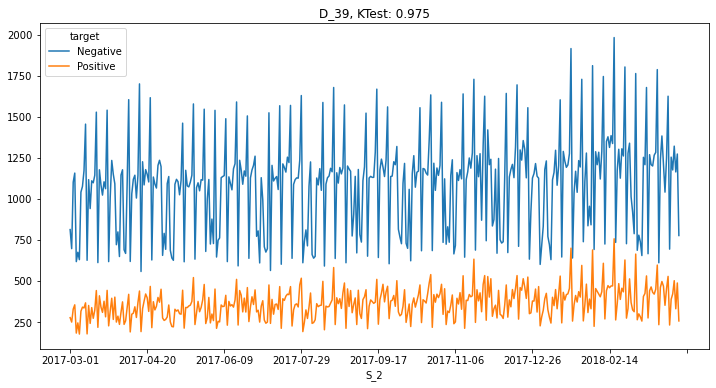

D_43


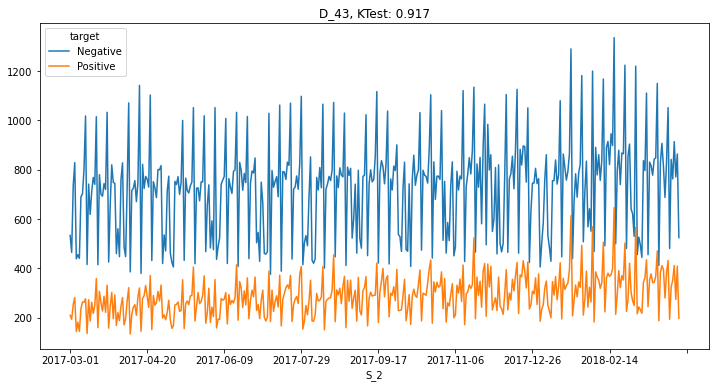

R_10


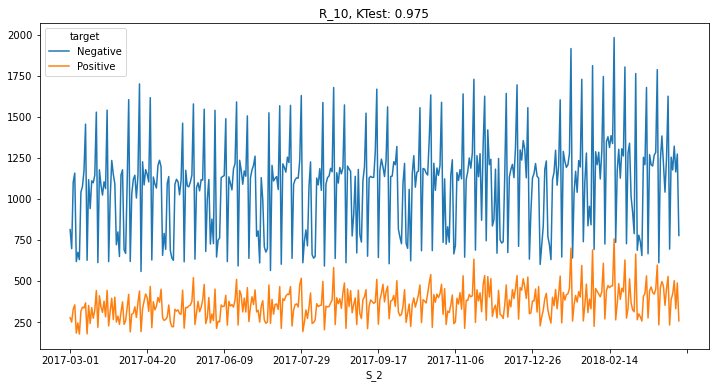

S_13


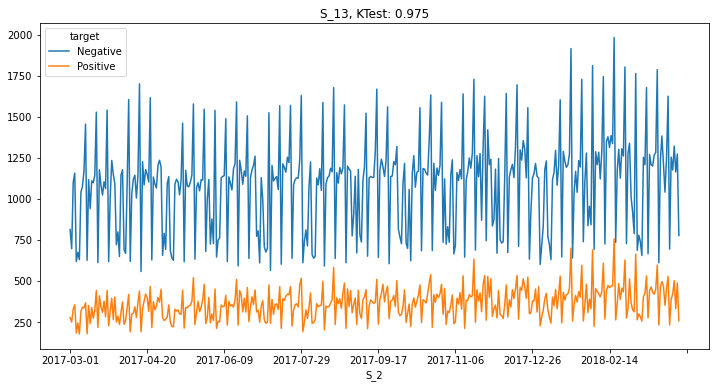

D_65


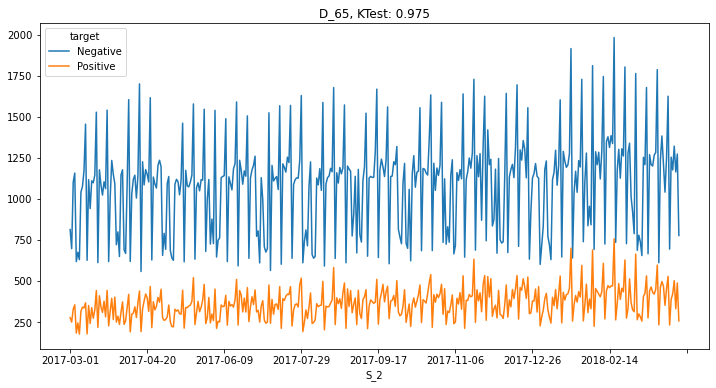

D_112


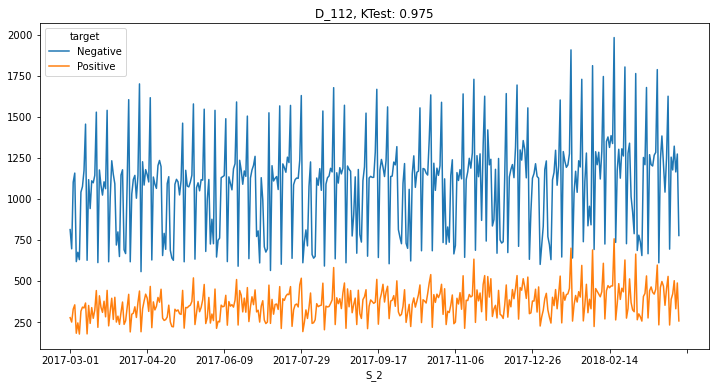

B_14


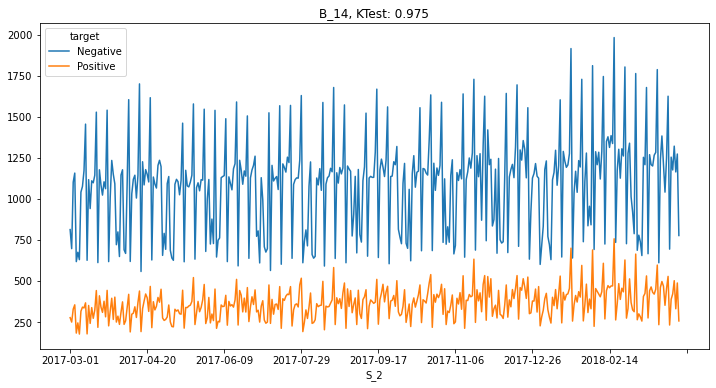

D_136


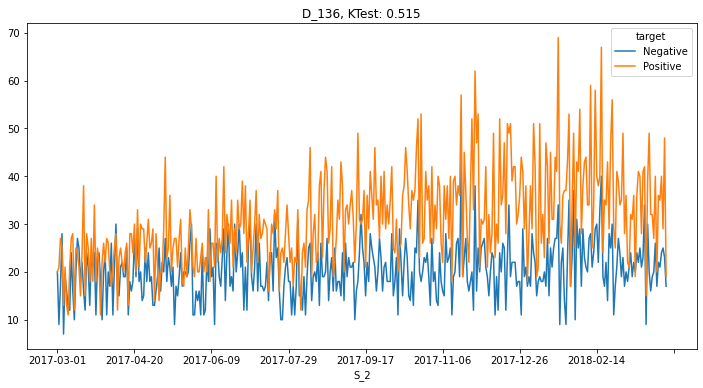

D_135


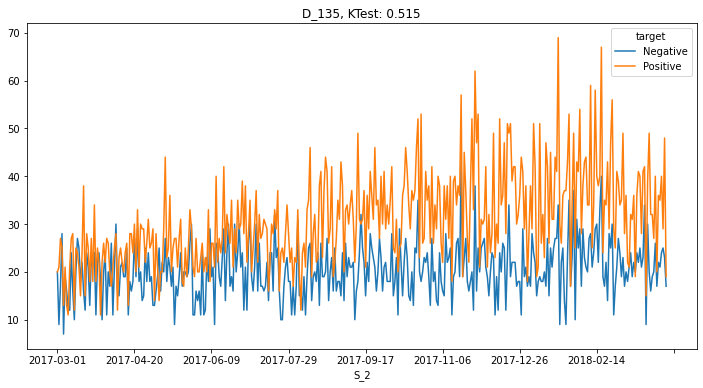

B_32


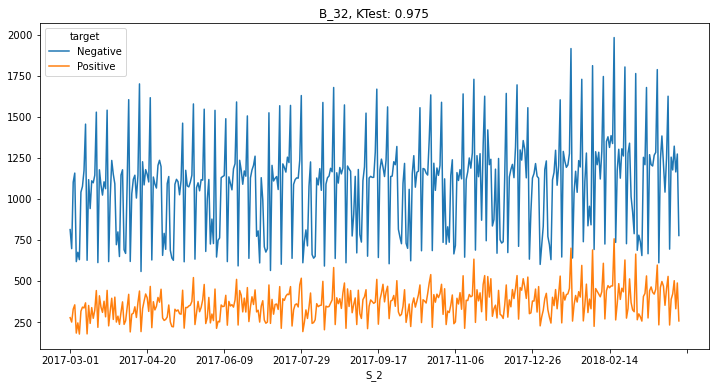

D_58


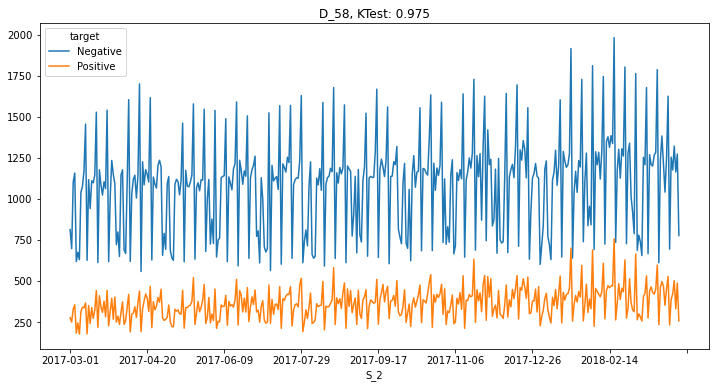

B_16


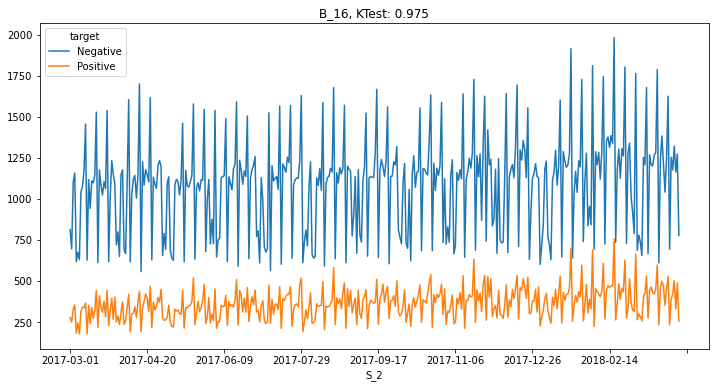

B_22


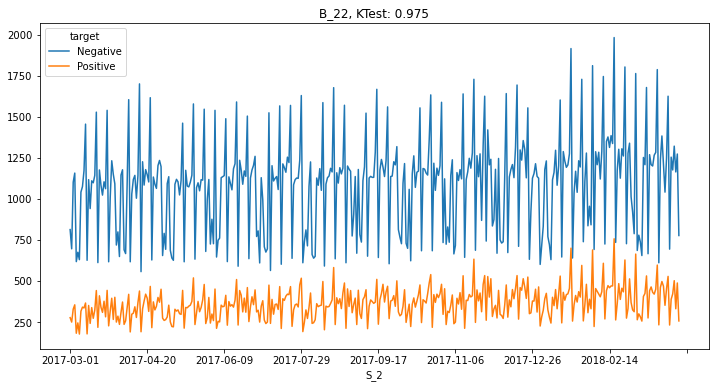

D_106


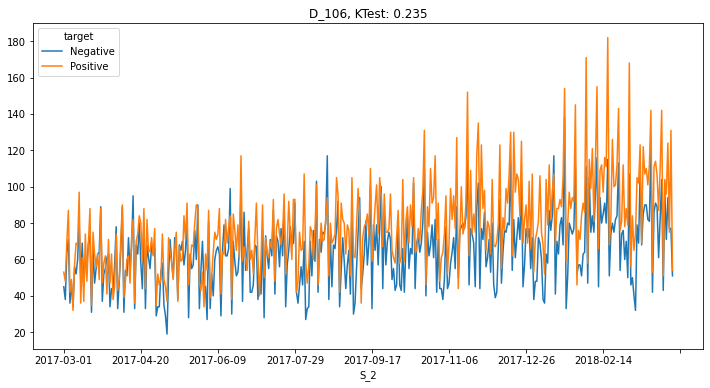

D_107


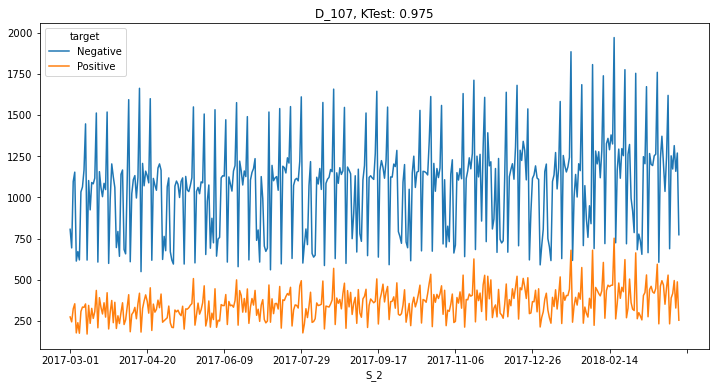

D_102


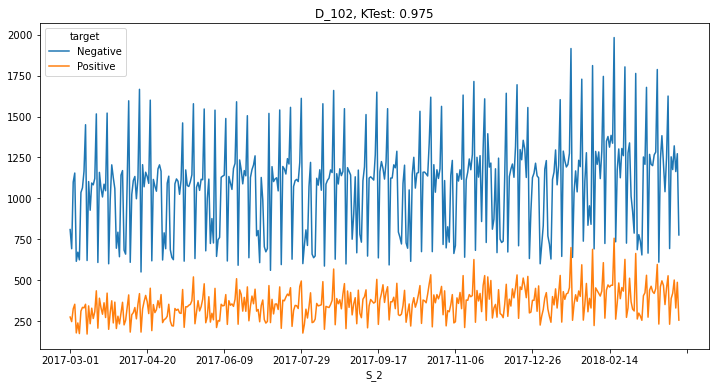

R_26


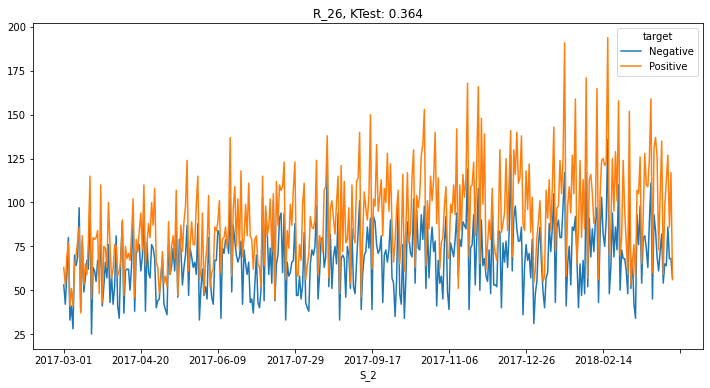

D_82


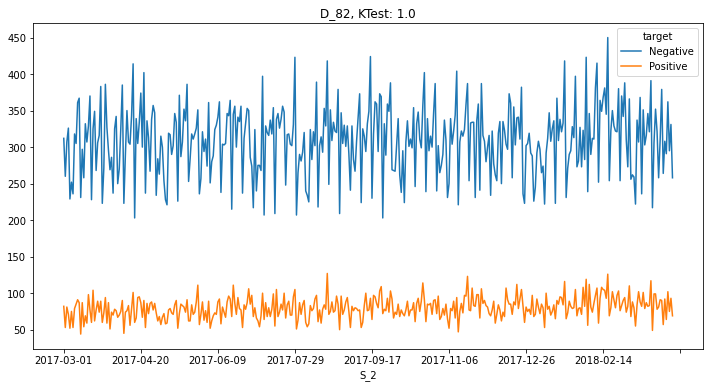

D_103


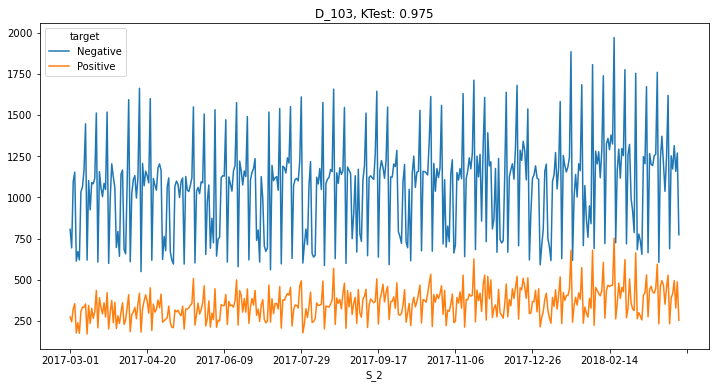

S_11


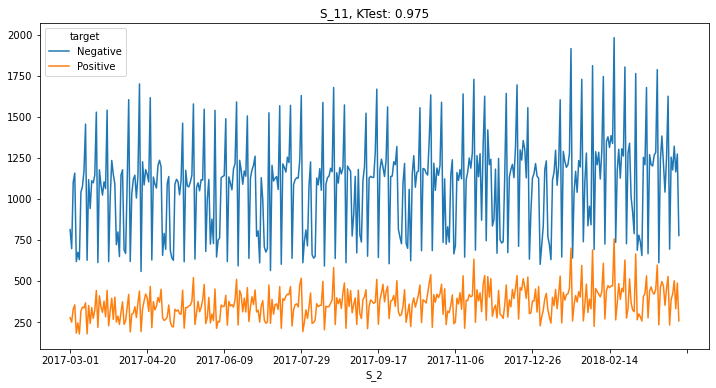

D_72


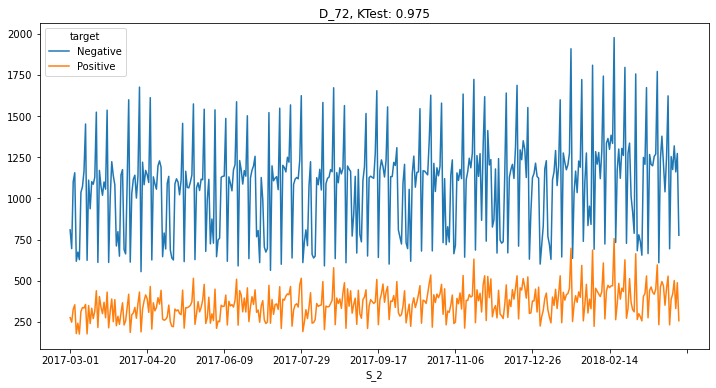

B_24


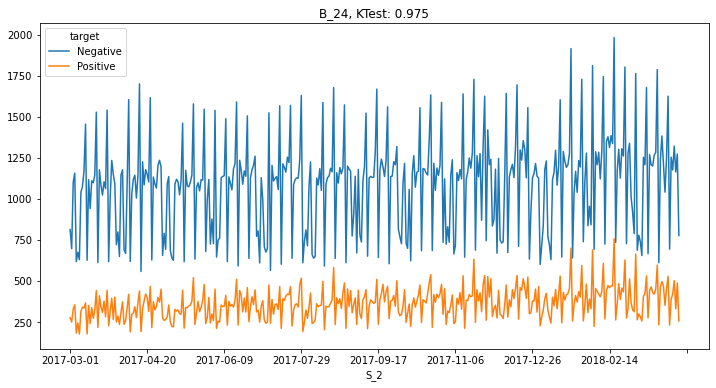

B_40


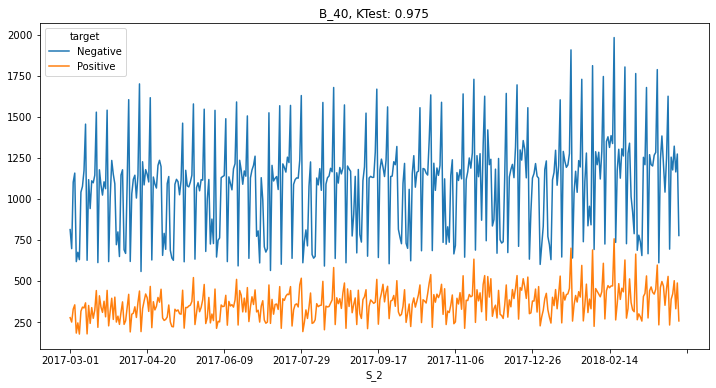

B_20


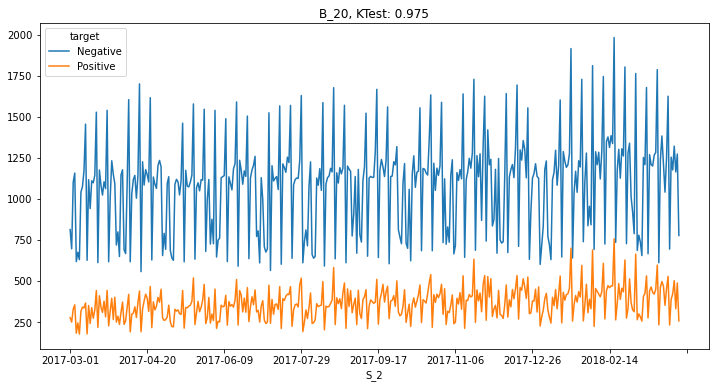

D_60


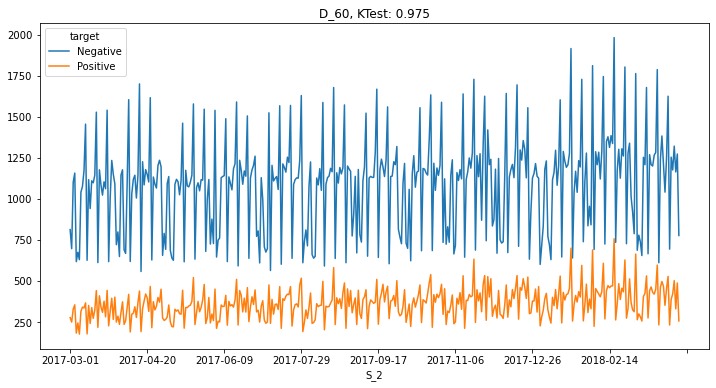

D_128


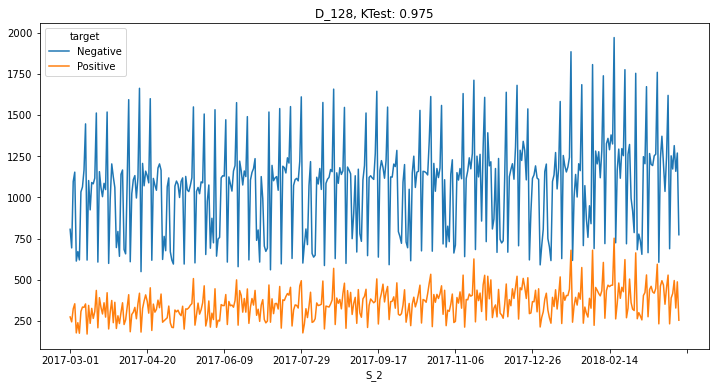

D_121


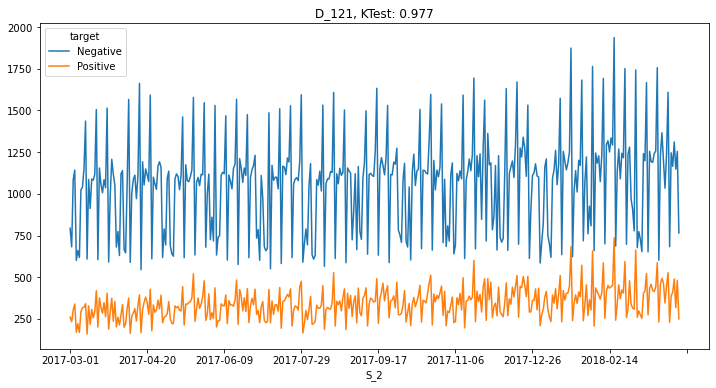

D_108


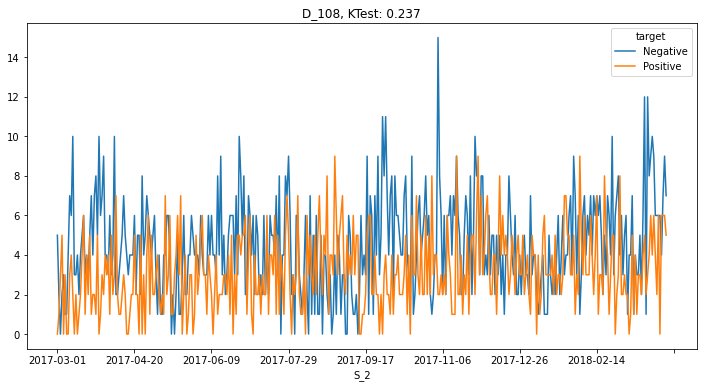

D_137


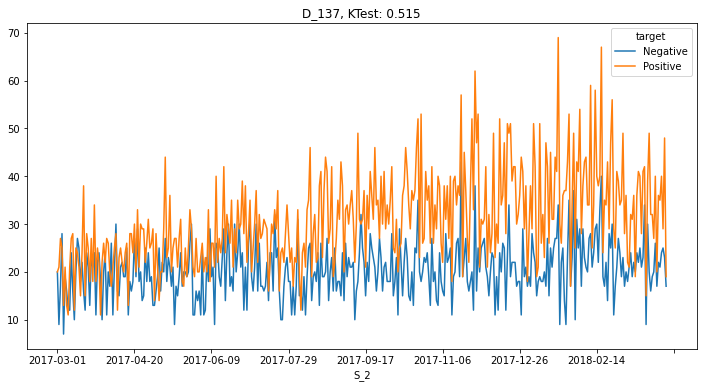

D_77


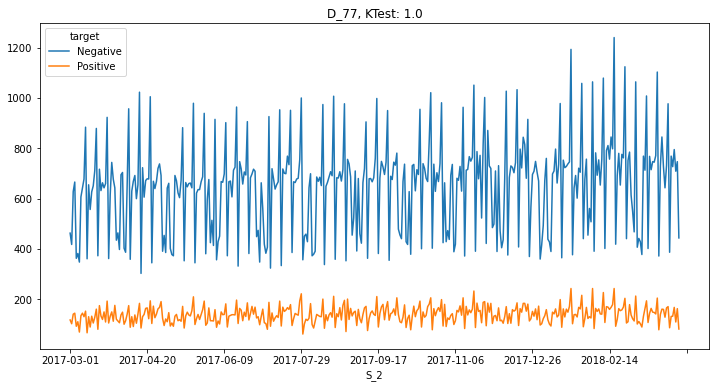

S_15


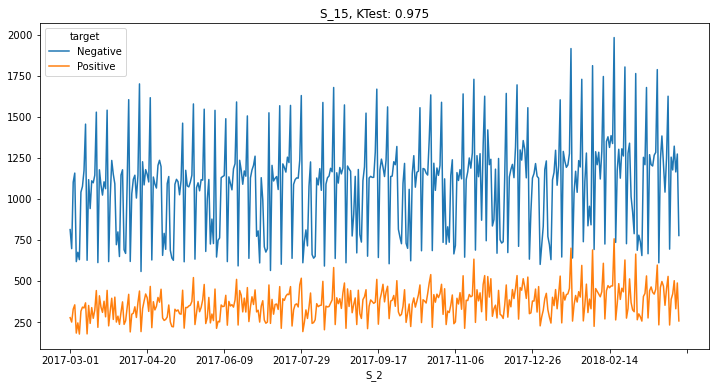

D_47


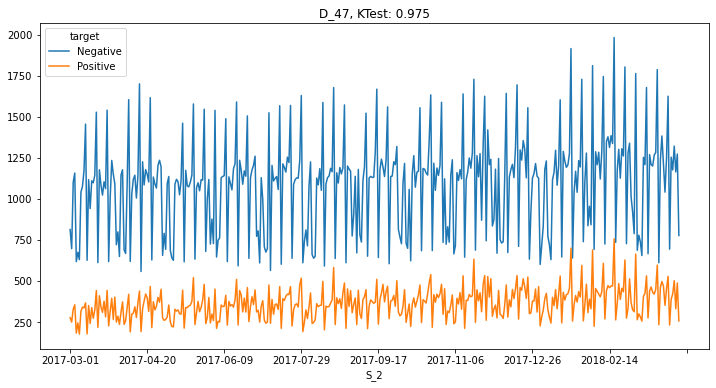

D_83


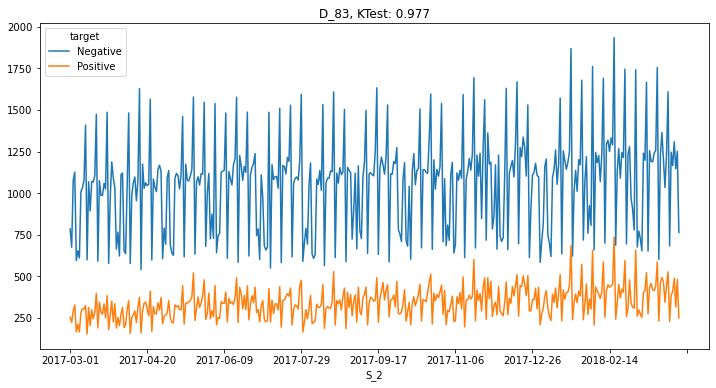

B_17


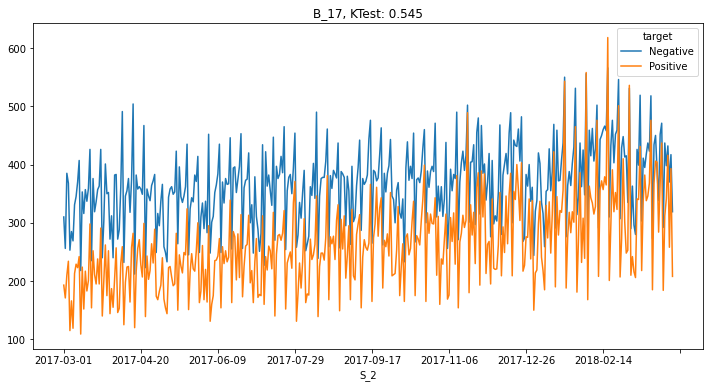

R_6


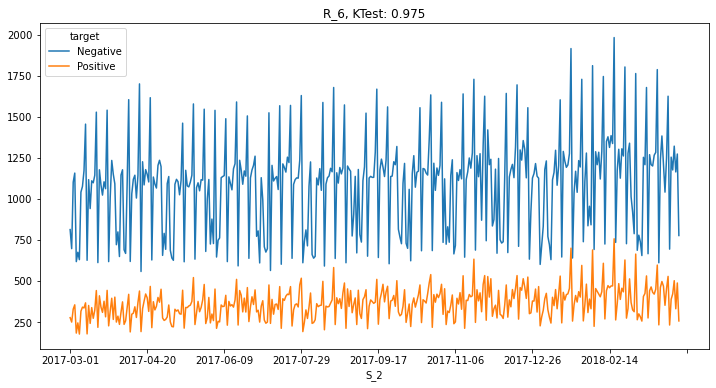

D_59


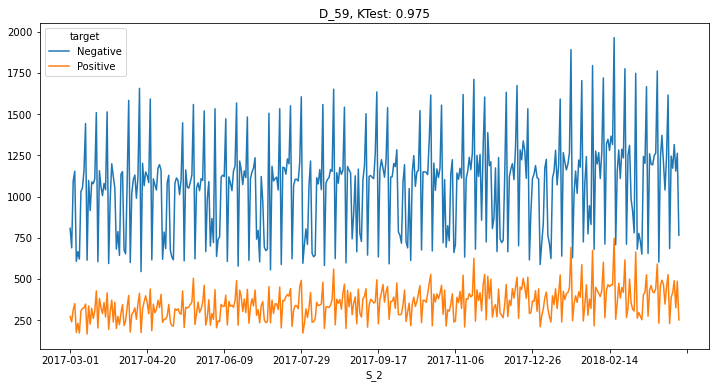

D_109


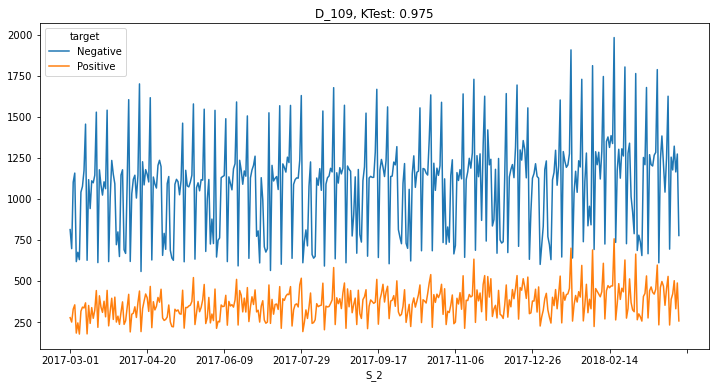

D_125


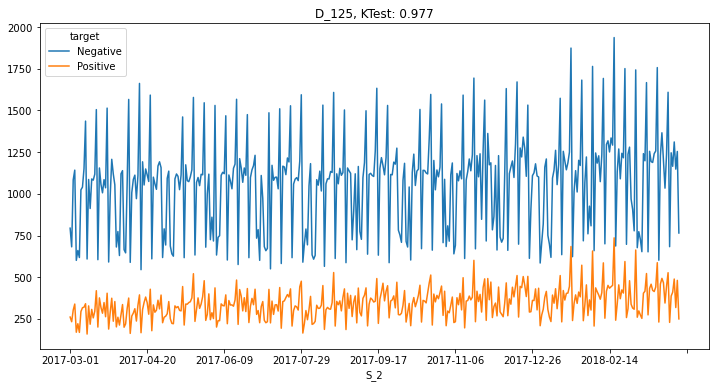

B_37


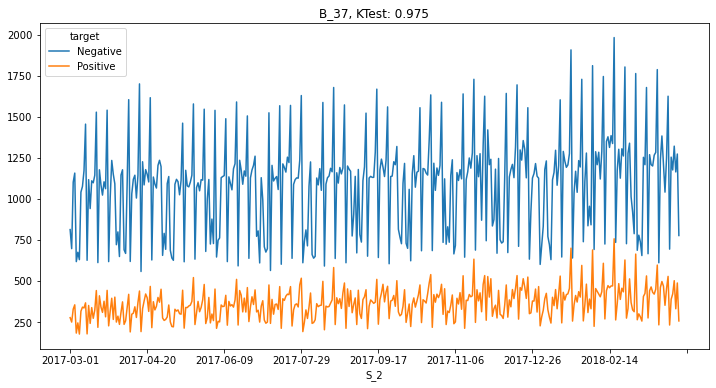

D_41


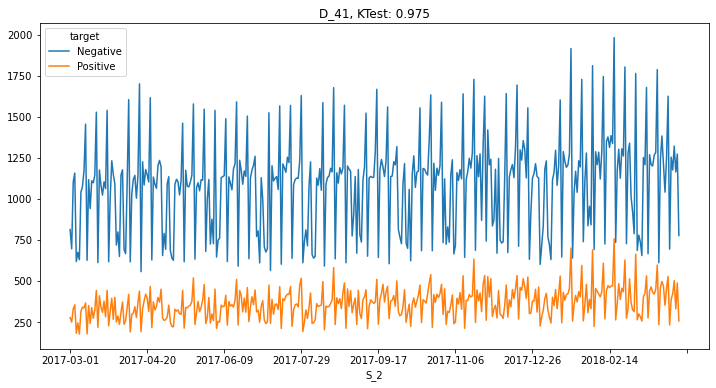

D_75


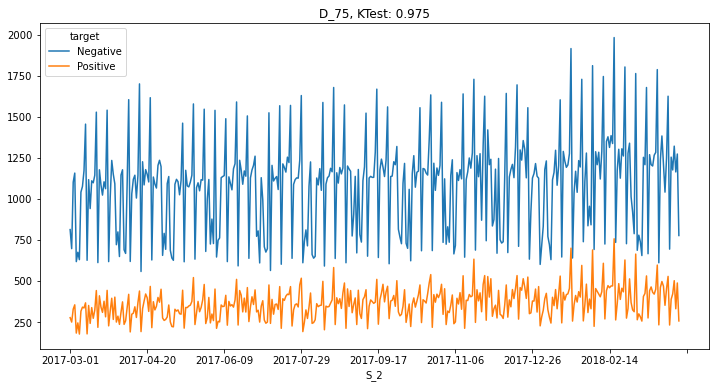

D_117


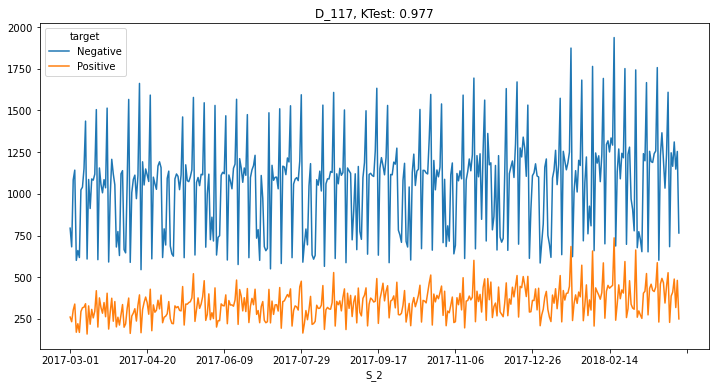

D_120


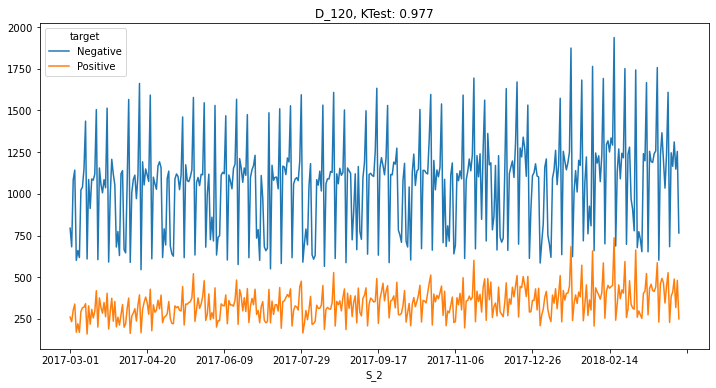

B_38


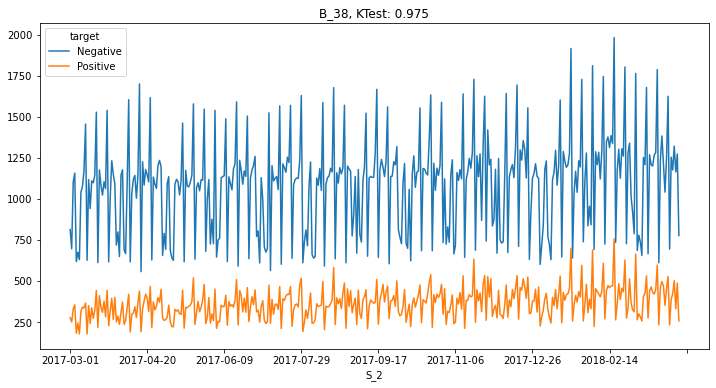

R_11


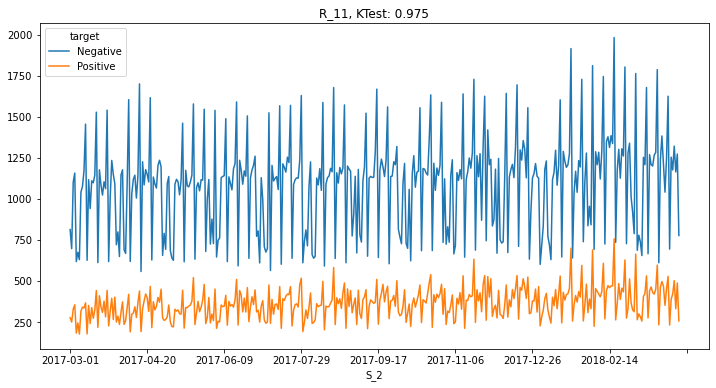

D_116


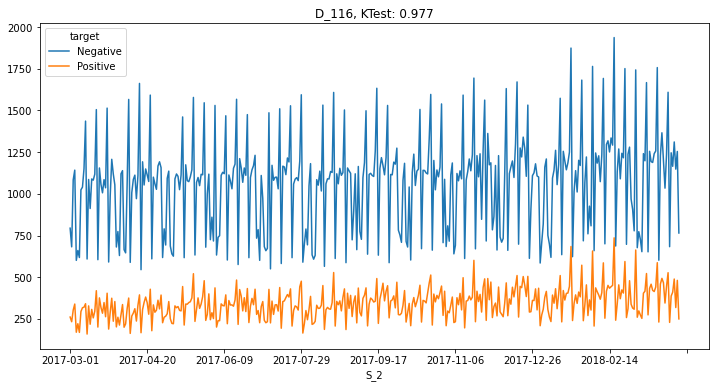

B_28


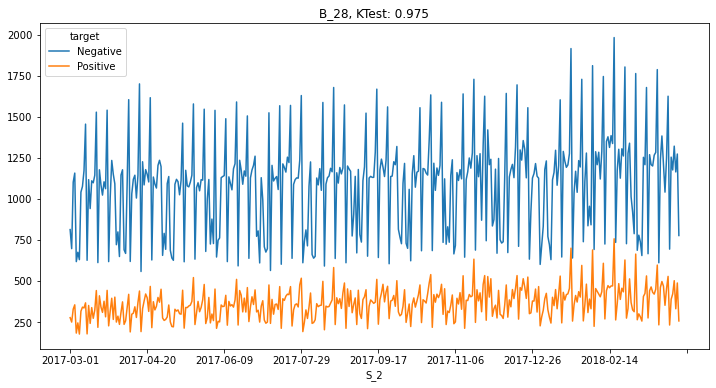

D_81


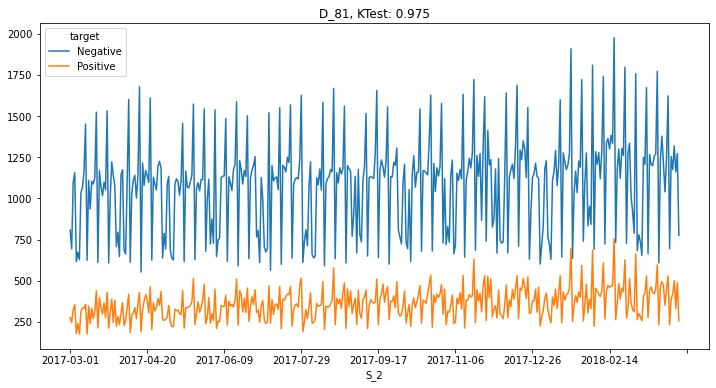

D_79


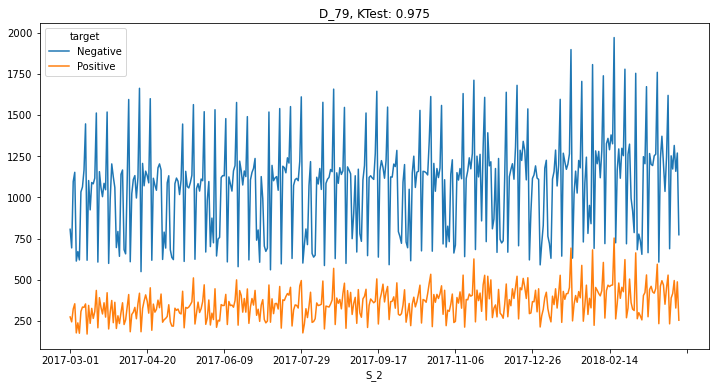

D_44


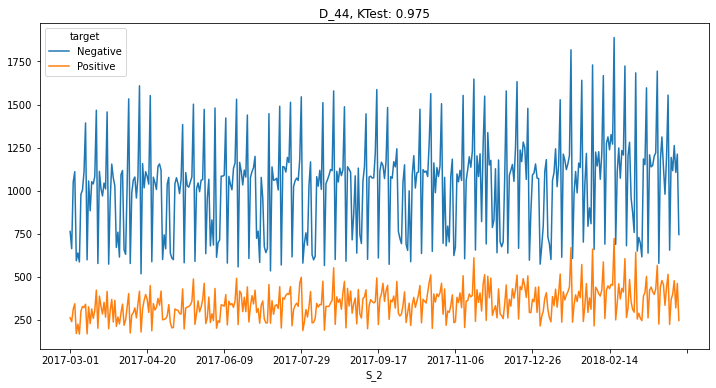

D_105


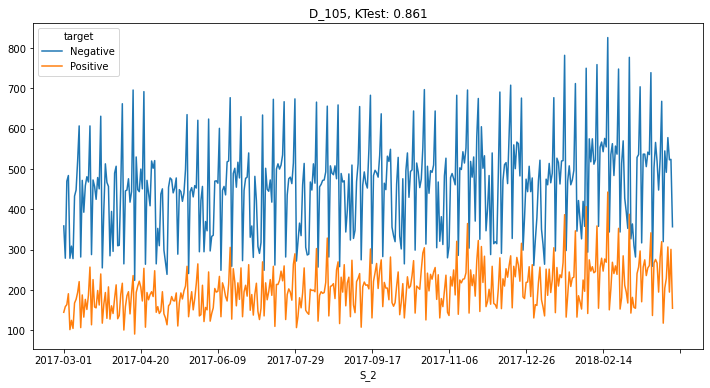

D_93


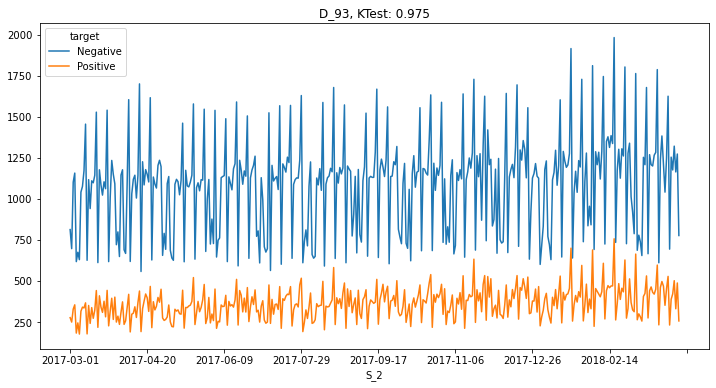

D_104


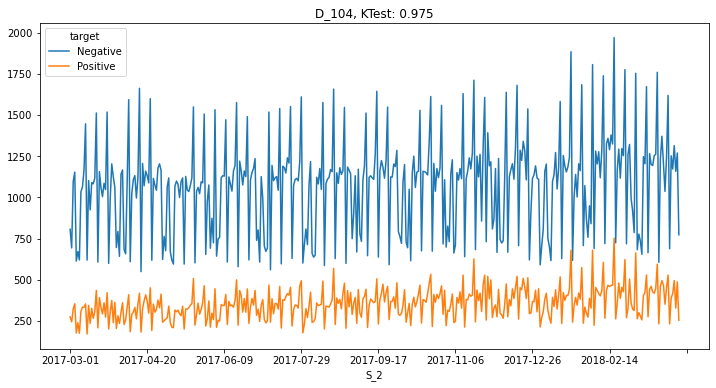

R_12


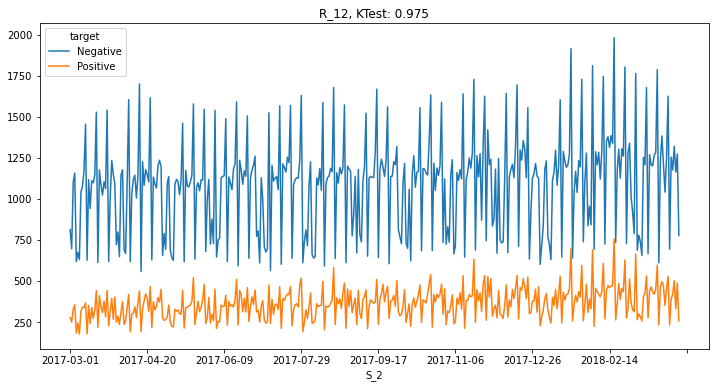

D_74


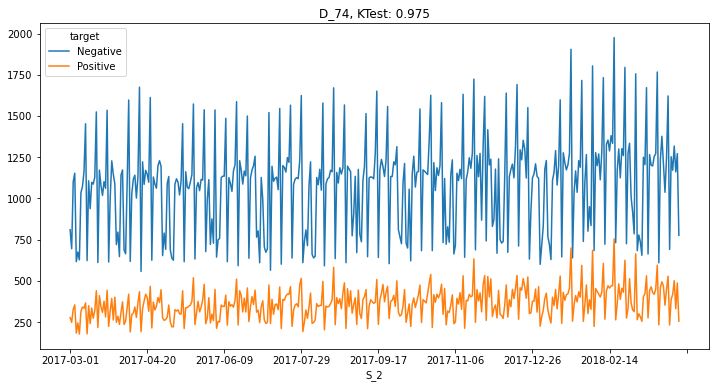

S_18


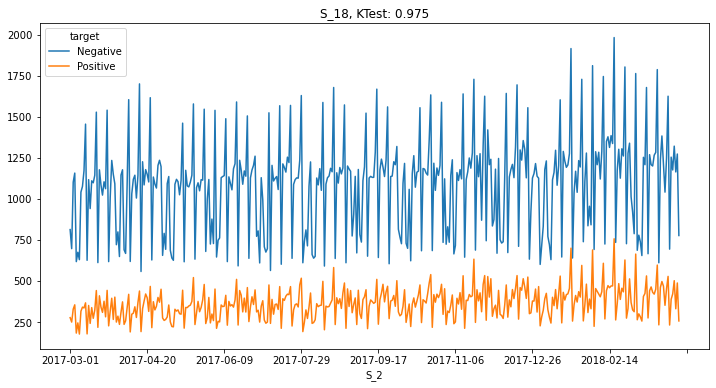

D_69


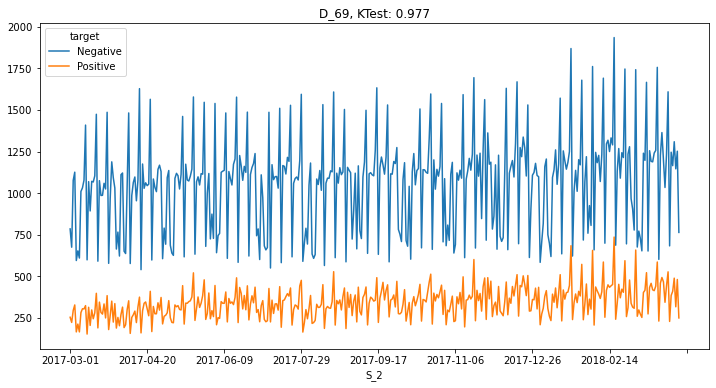

B_13


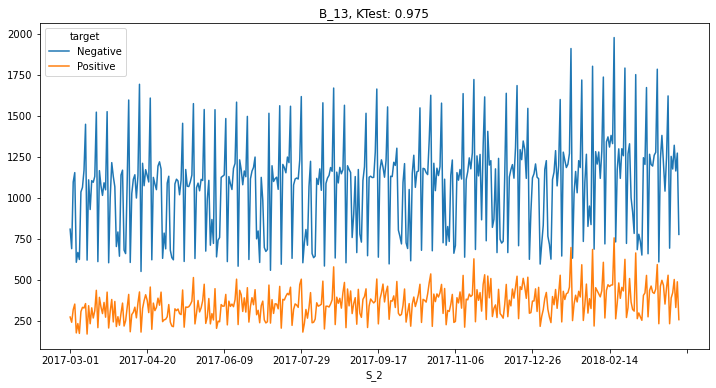

D_80


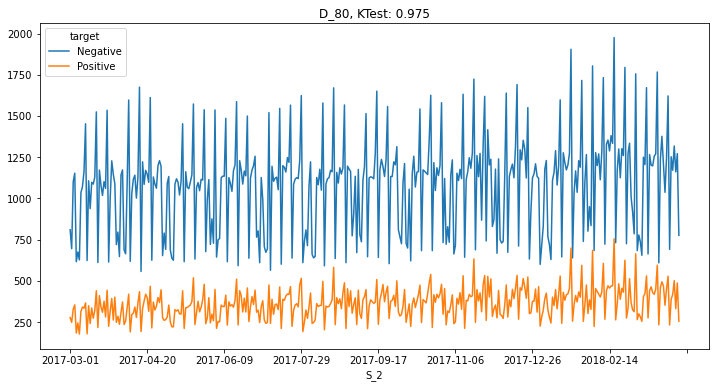

S_26


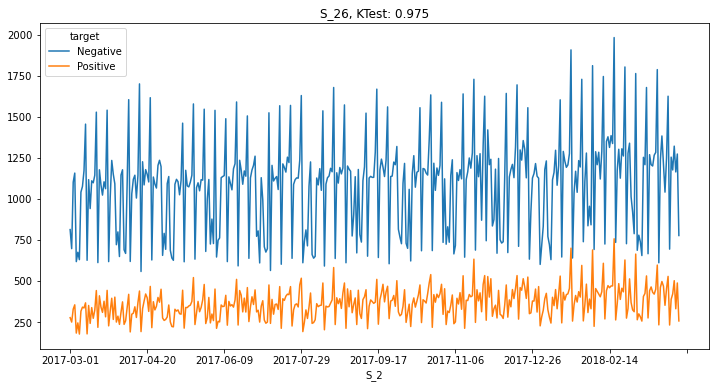

P_3


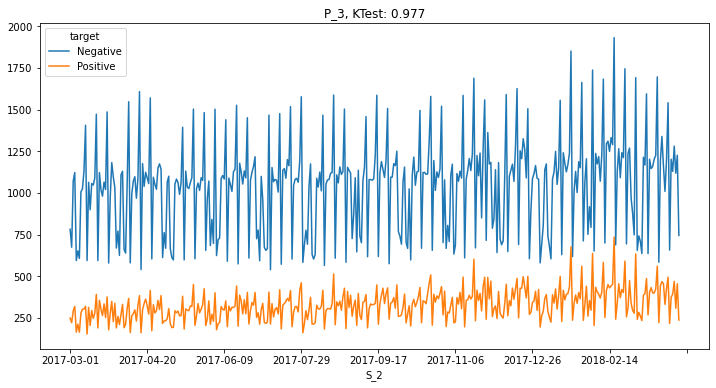

S_17


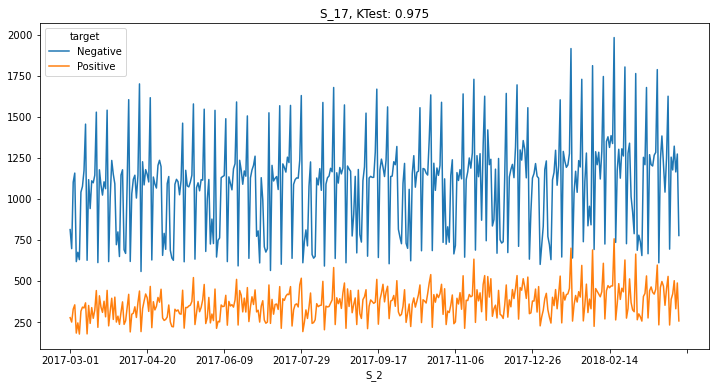

B_8


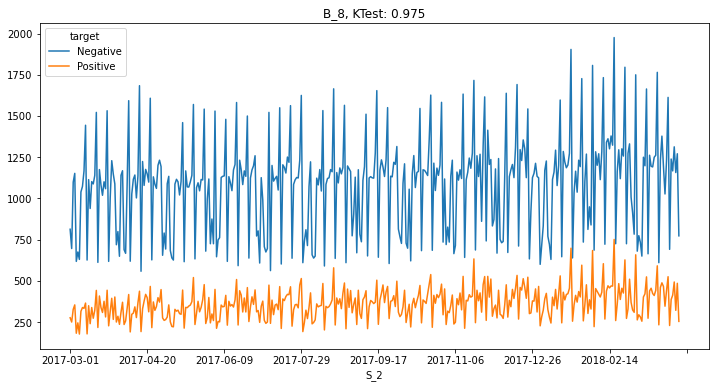

B_3


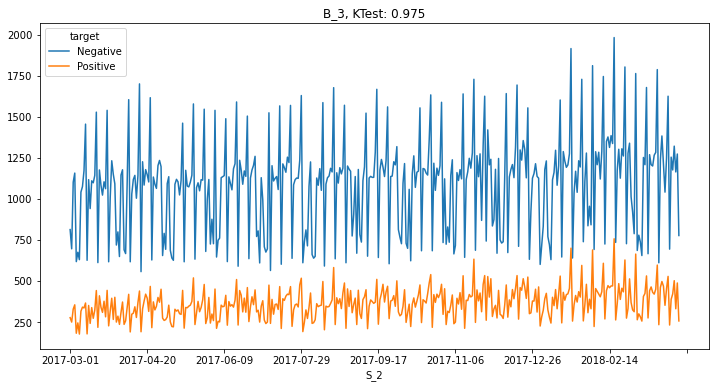

D_48


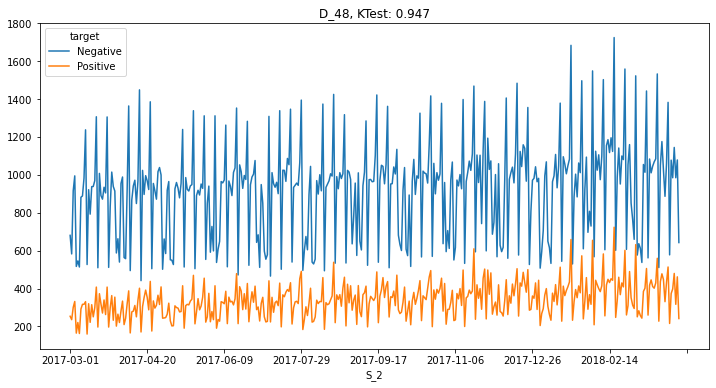

B_10


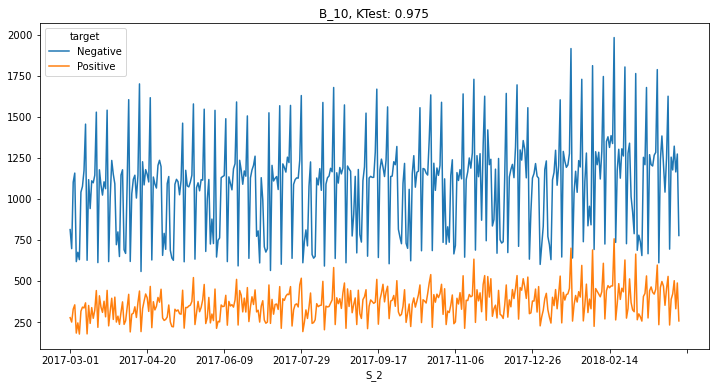

R_28


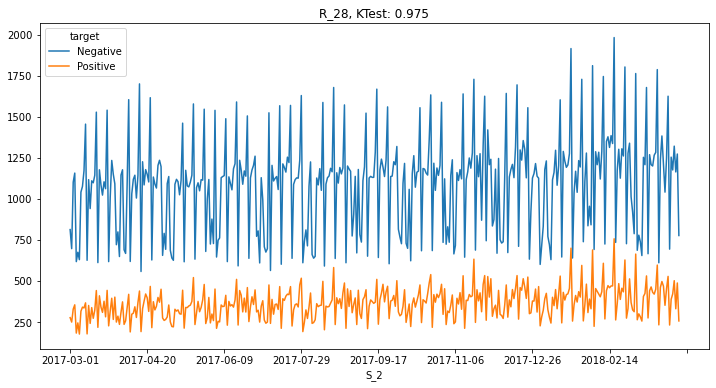

D_111


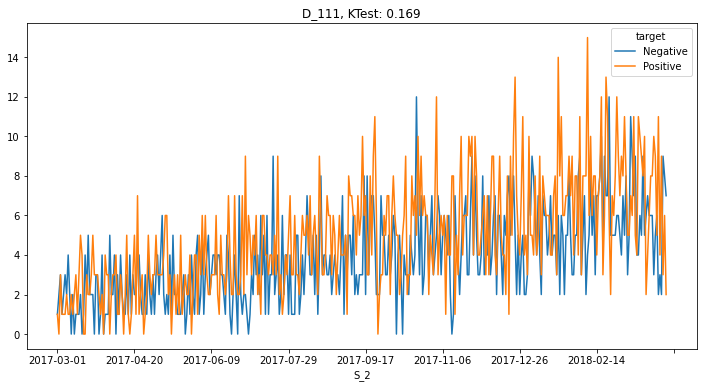

S_25


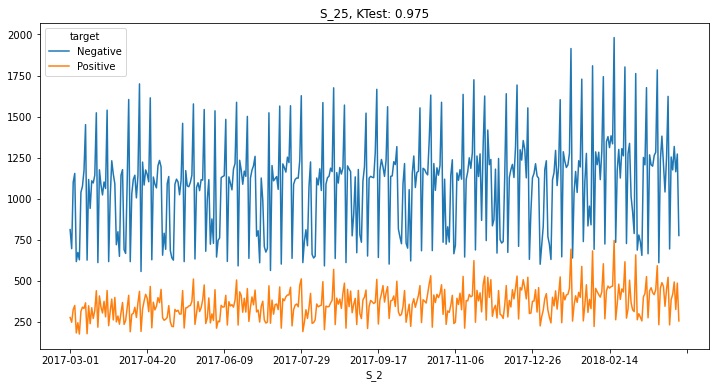

D_56


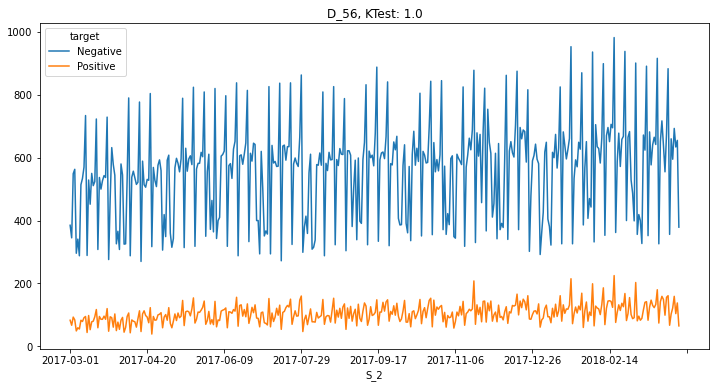

D_91


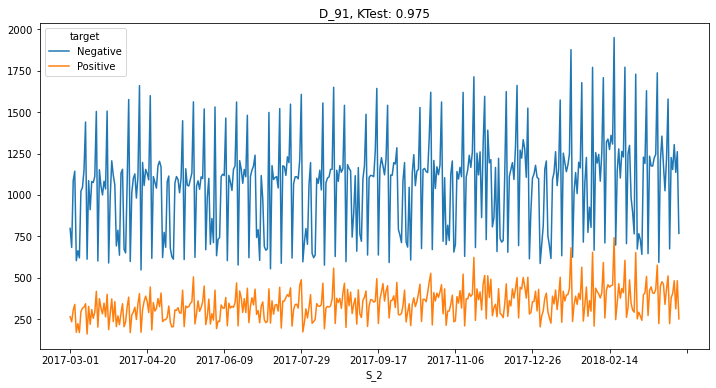

D_87


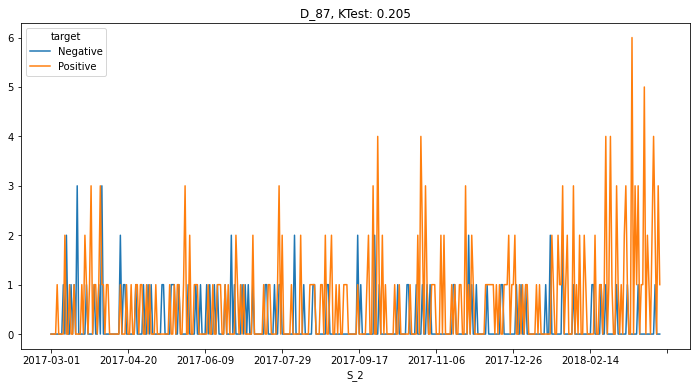

S_20


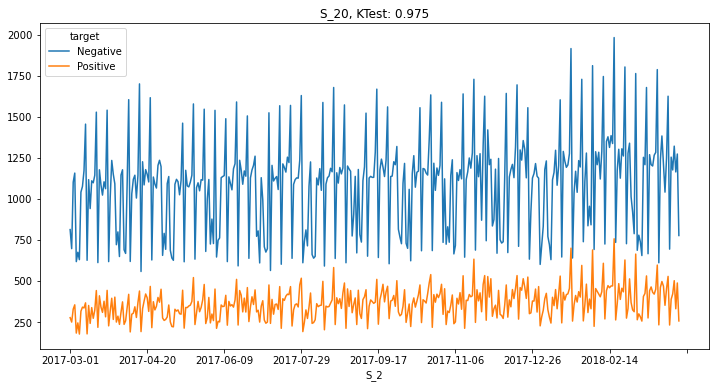

B_29


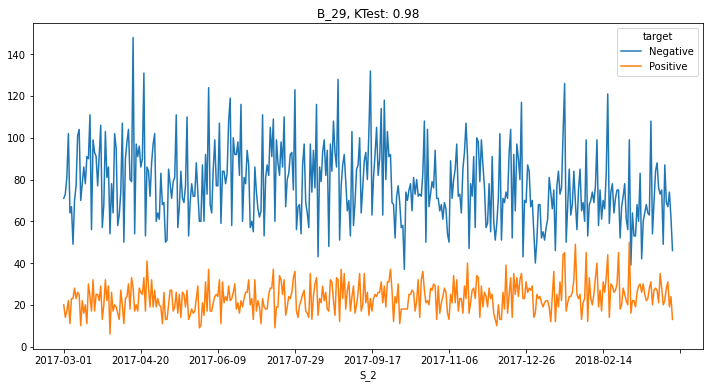

B_36


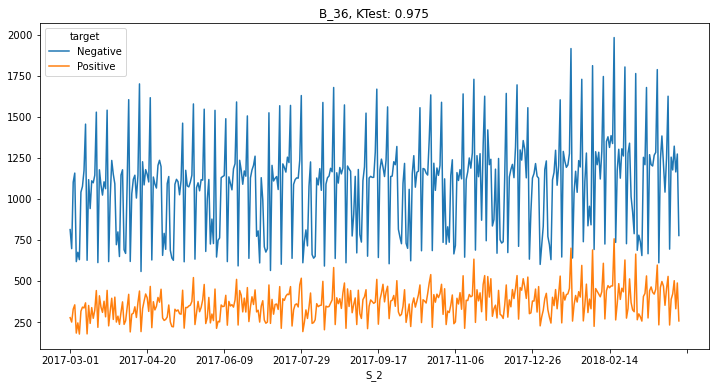

D_119


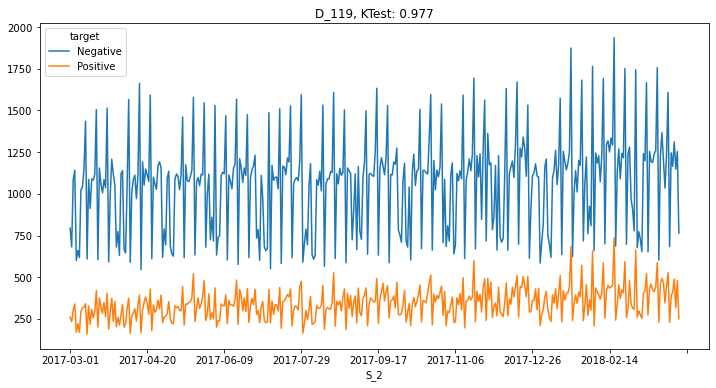

B_1


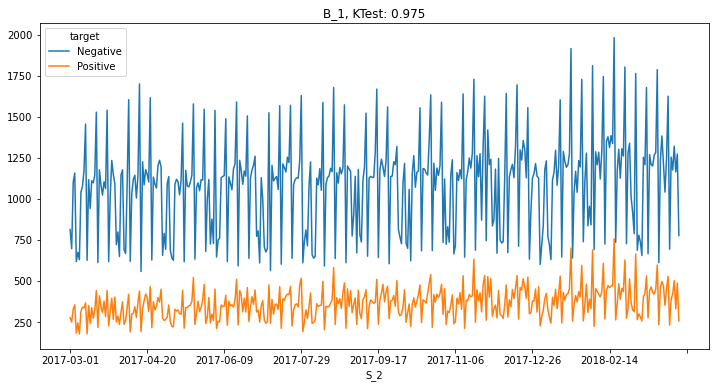

B_6


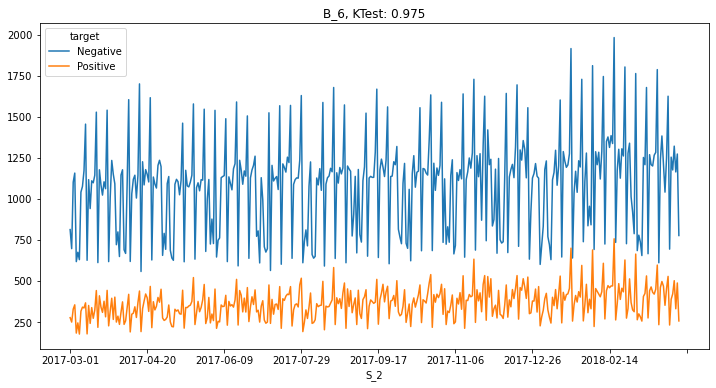

R_18


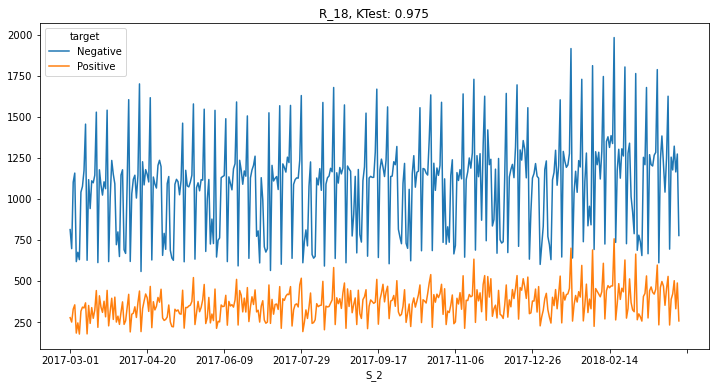

B_42


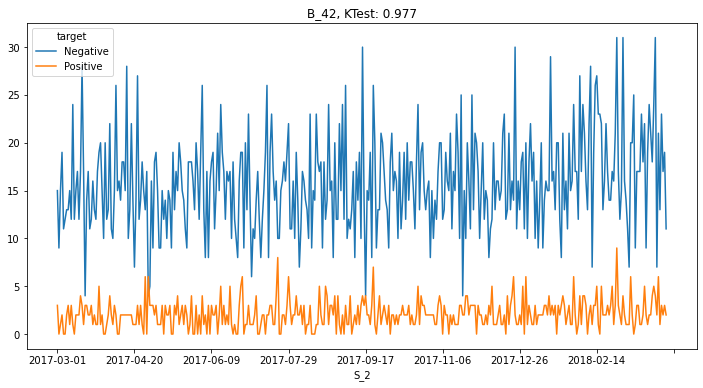

R_24


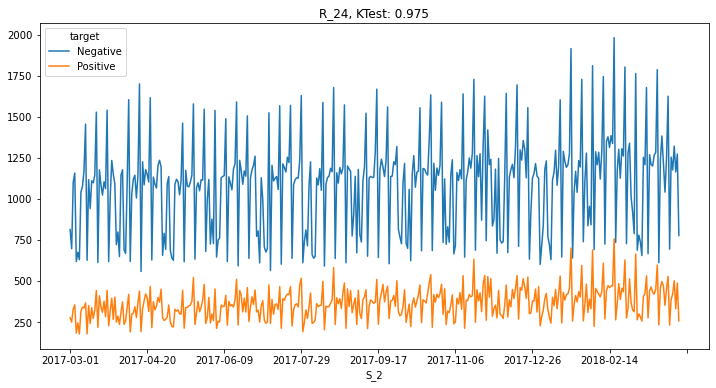

B_23


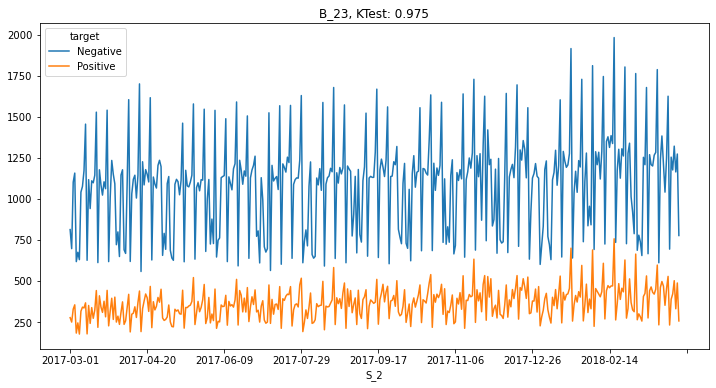

D_114


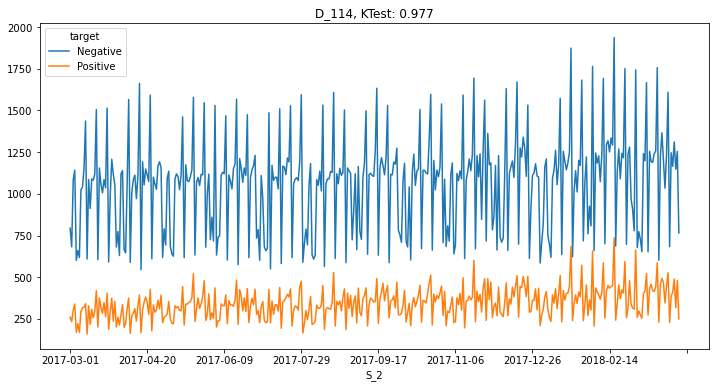

D_140


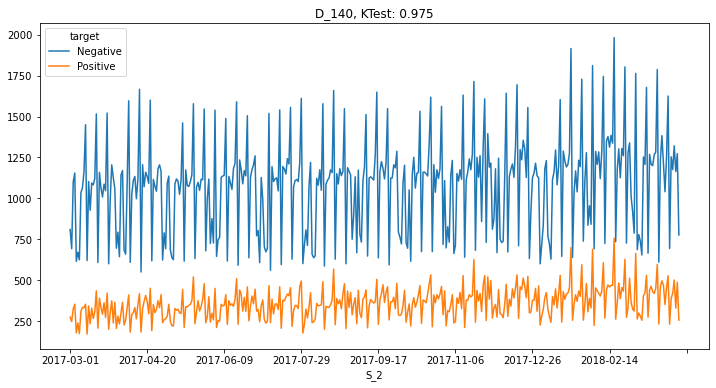

D_115


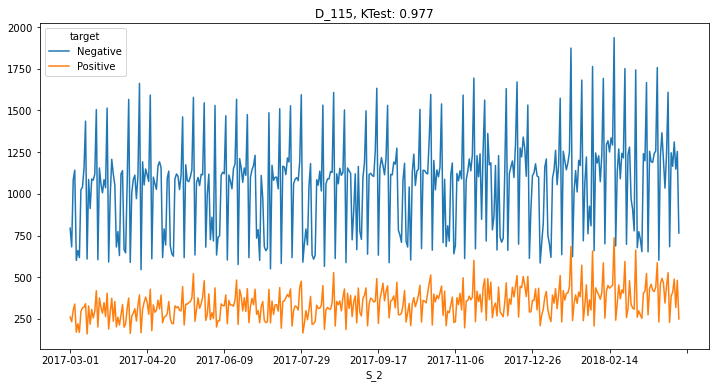

D_122


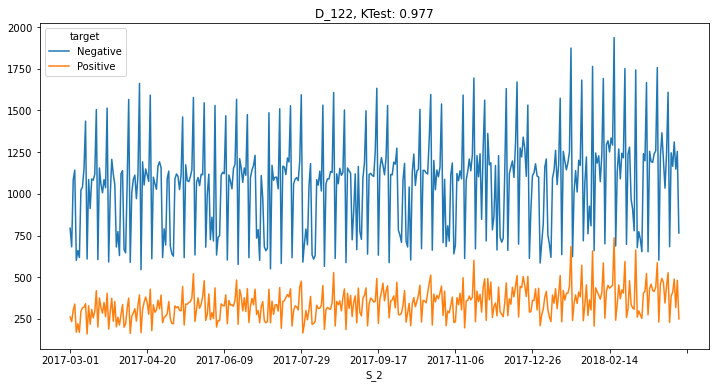

D_46


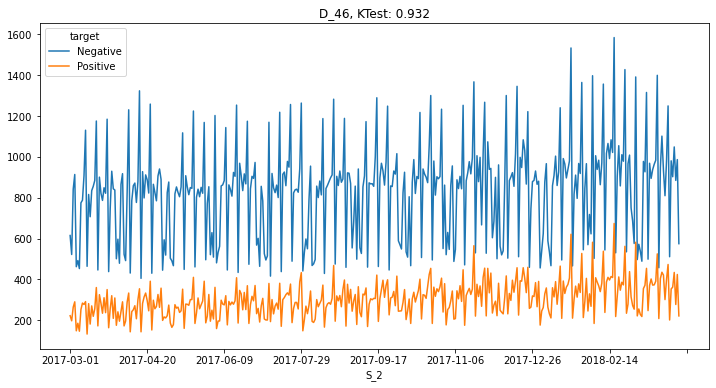

B_5


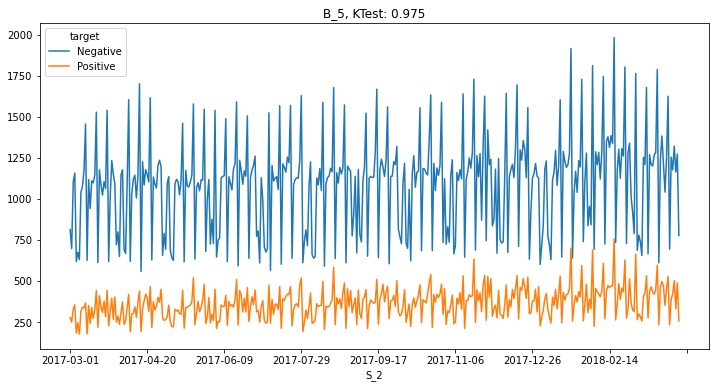

D_113


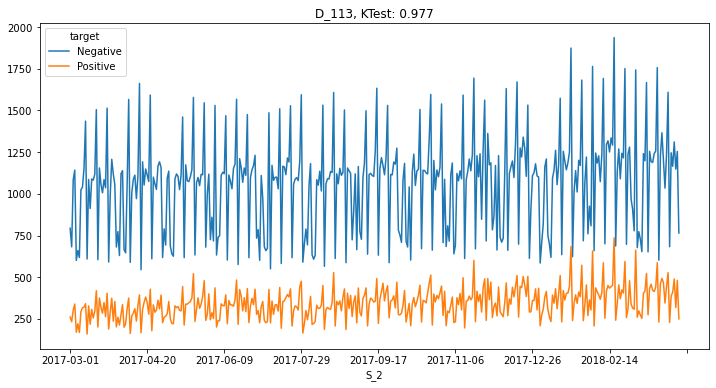

S_3


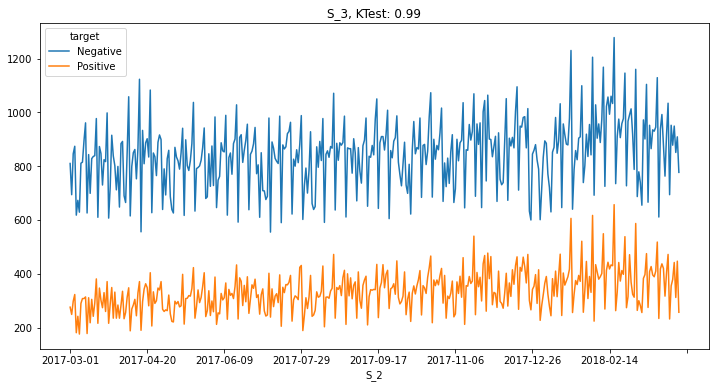

D_138


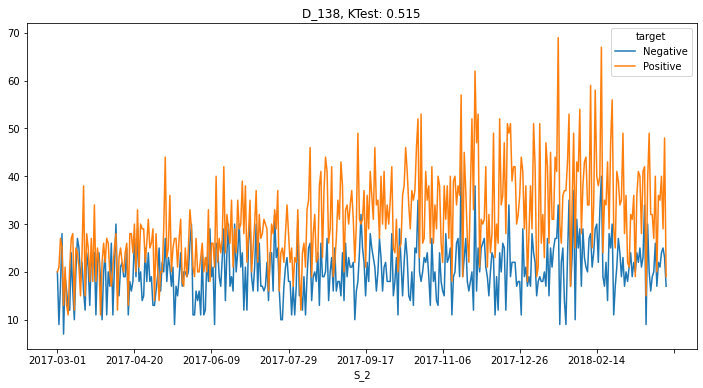

B_39


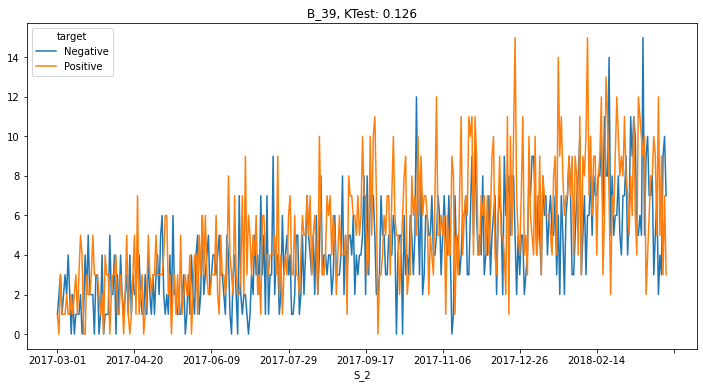

D_96


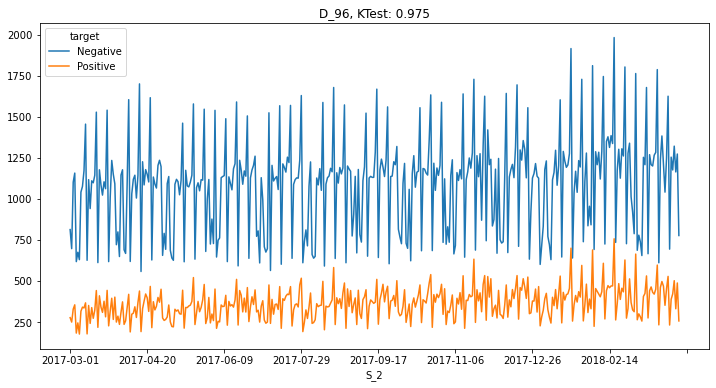

D_70


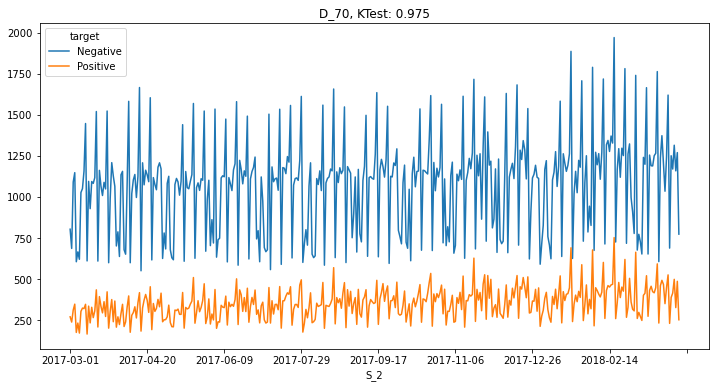

D_45


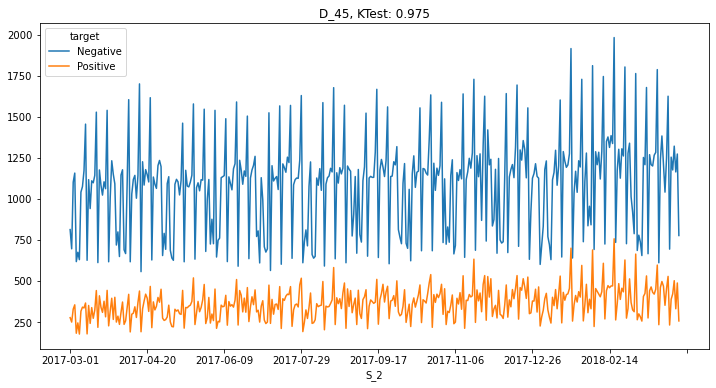

D_84


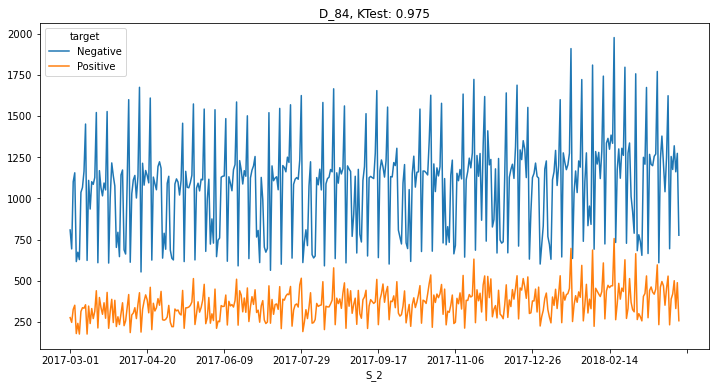

P_4


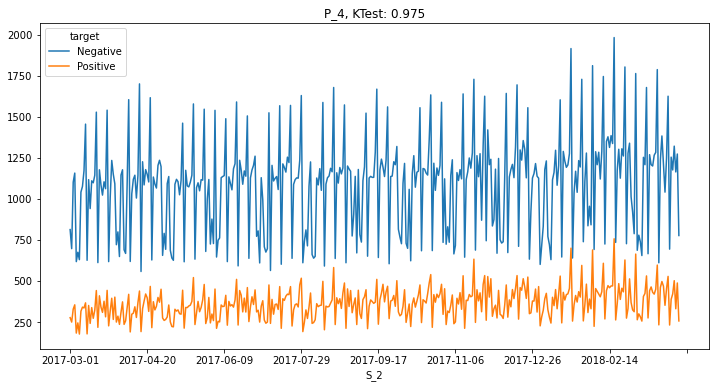

S_23


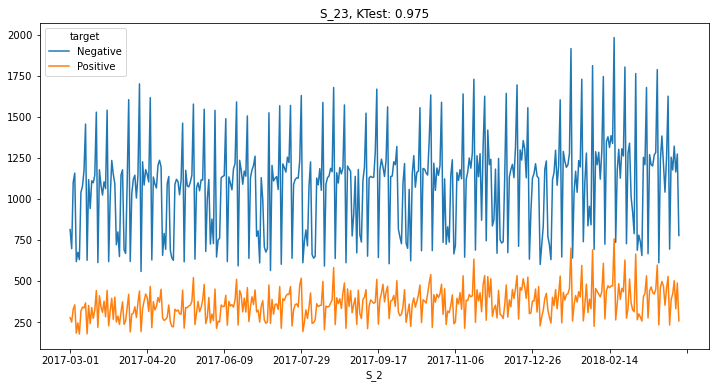

D_50


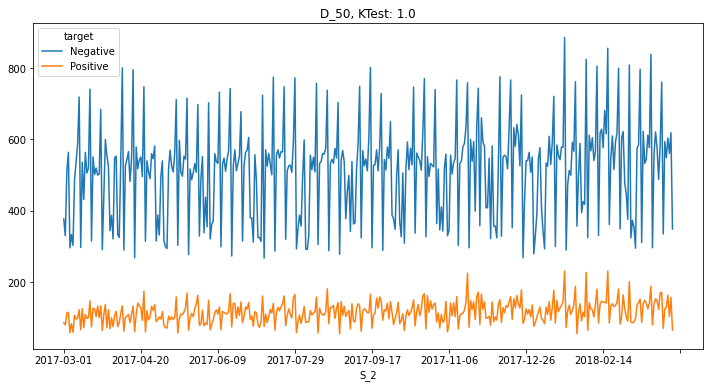

R_23


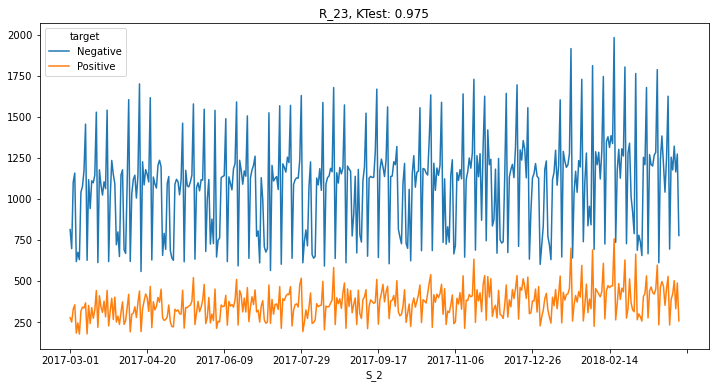

D_131


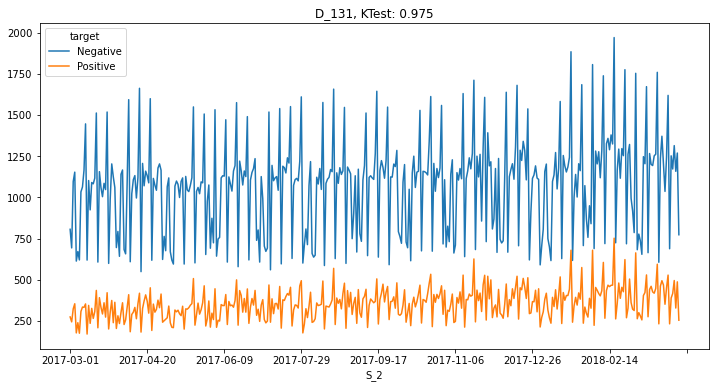

D_132


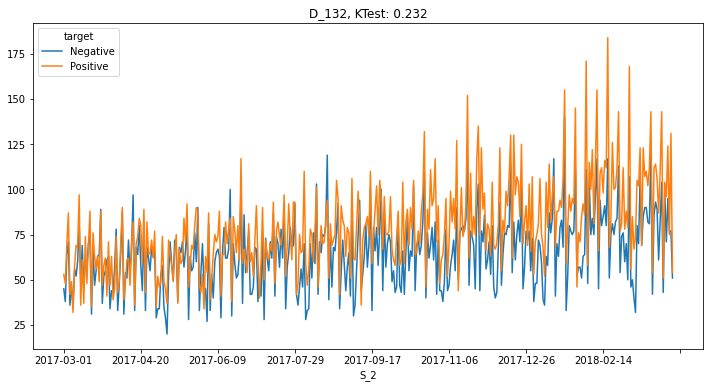

R_22


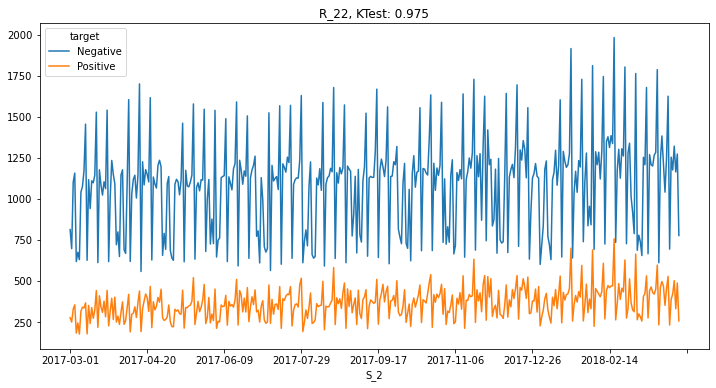

S_19


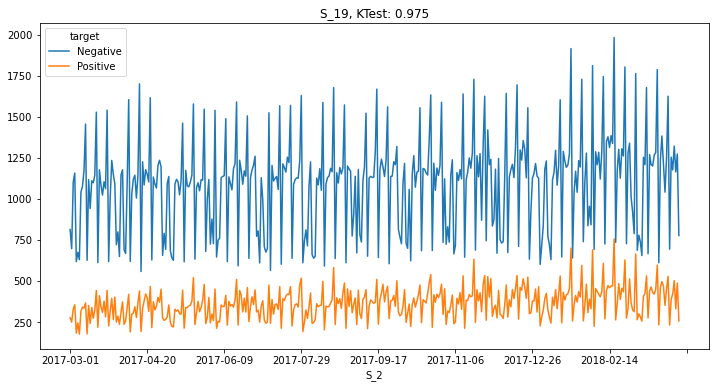

D_133


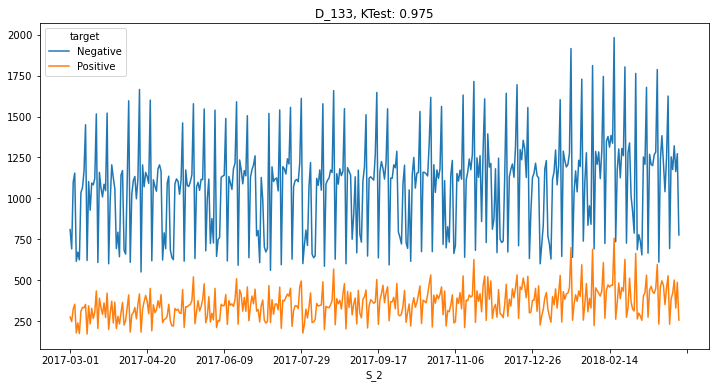

S_27


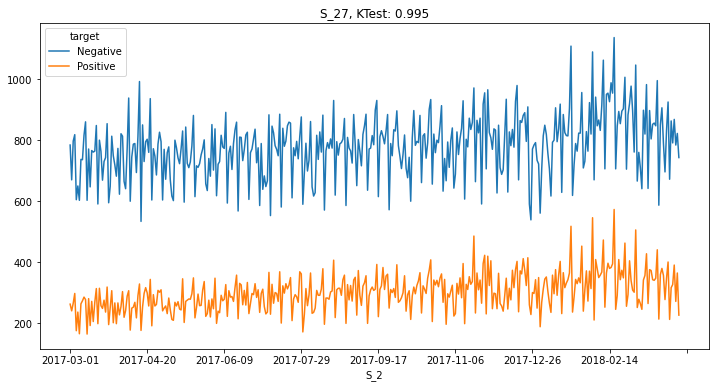

D_73


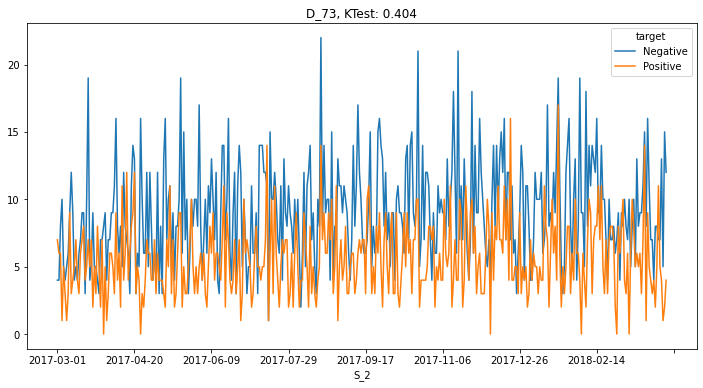

S_9


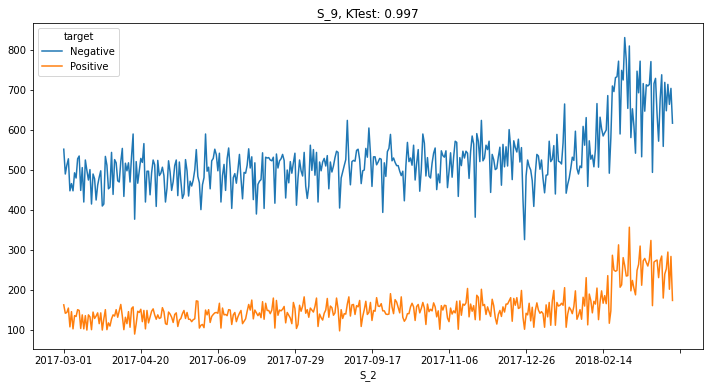

R_16


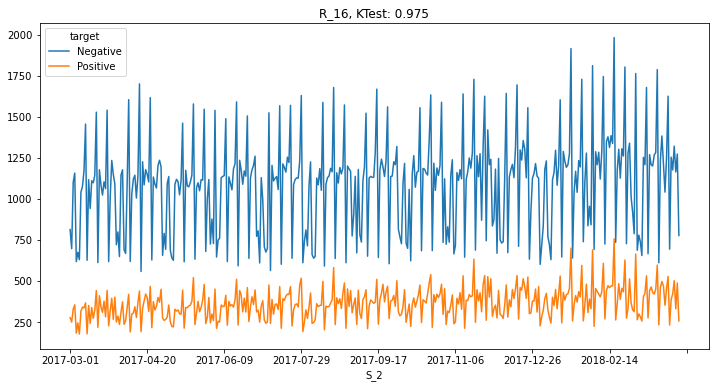

B_18


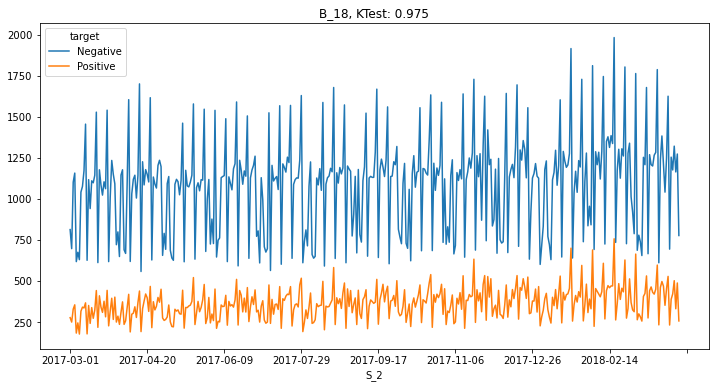

D_134


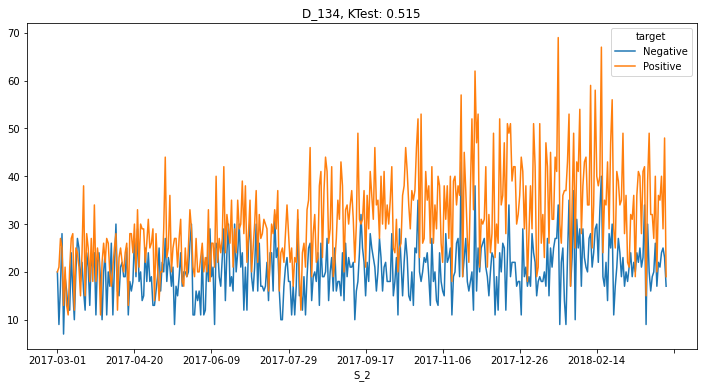

S_6


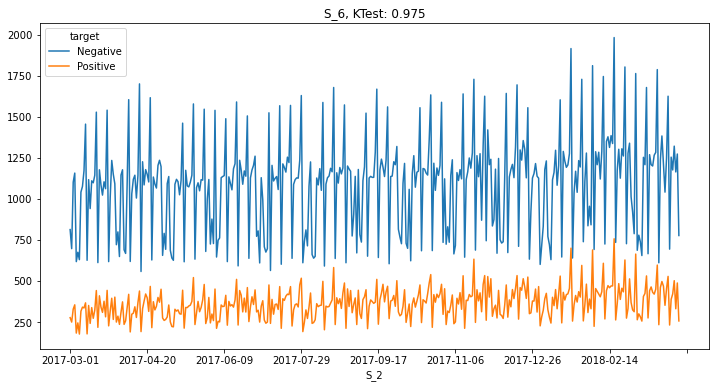

D_143


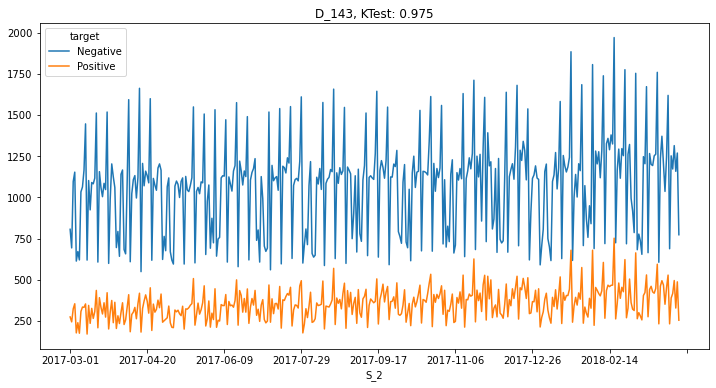

D_144


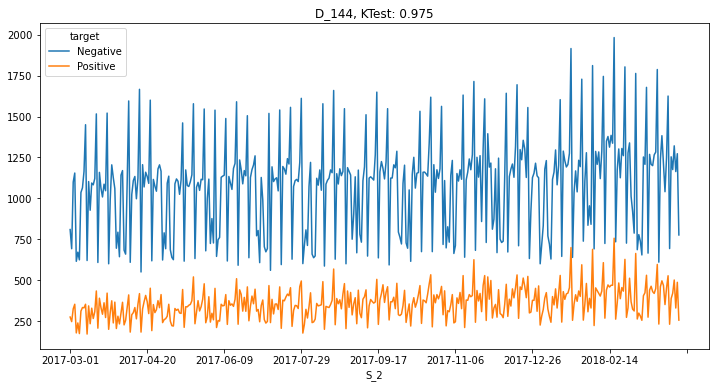

S_8


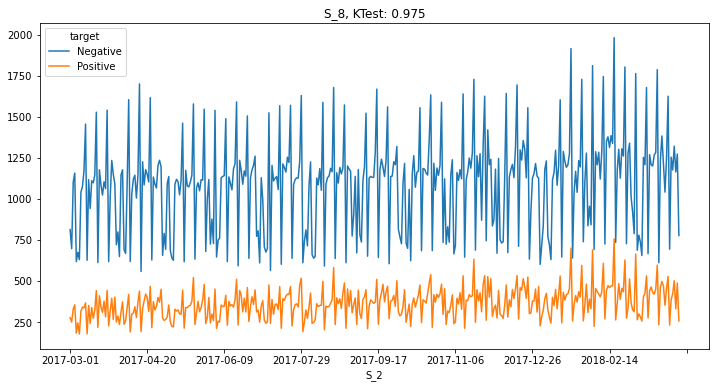

R_27


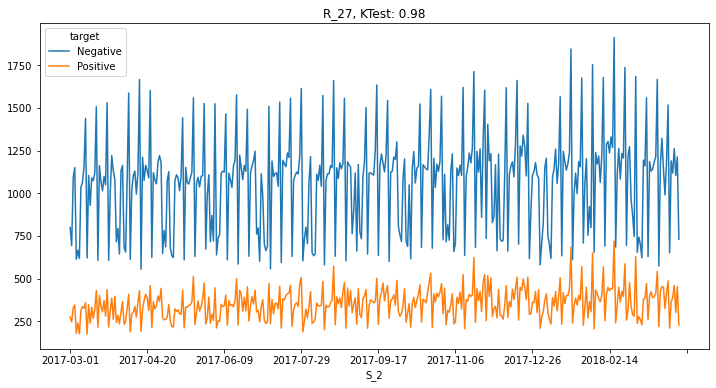

D_118


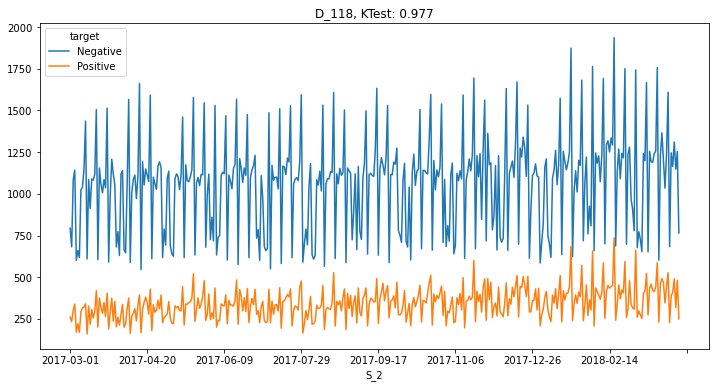

D_68


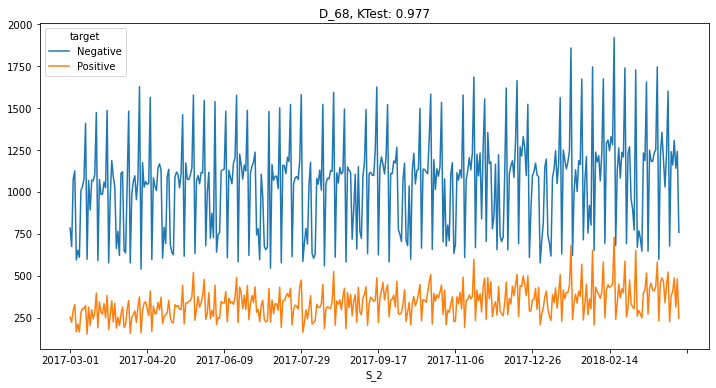

D_52


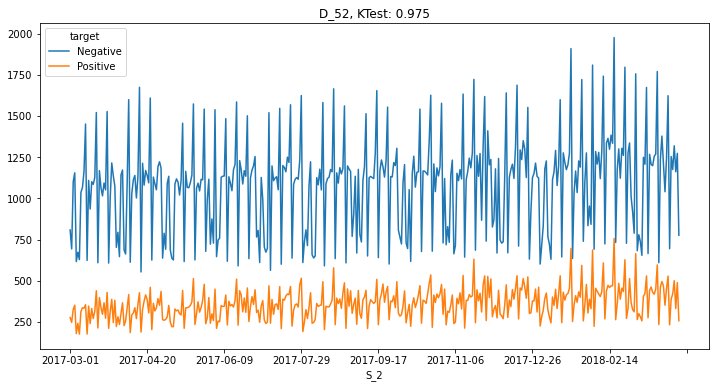

D_55


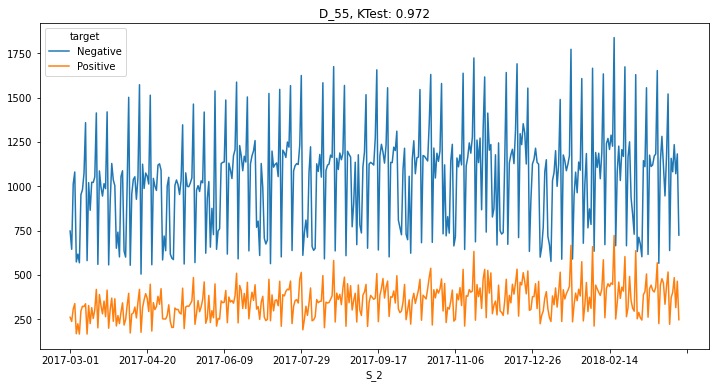

S_24


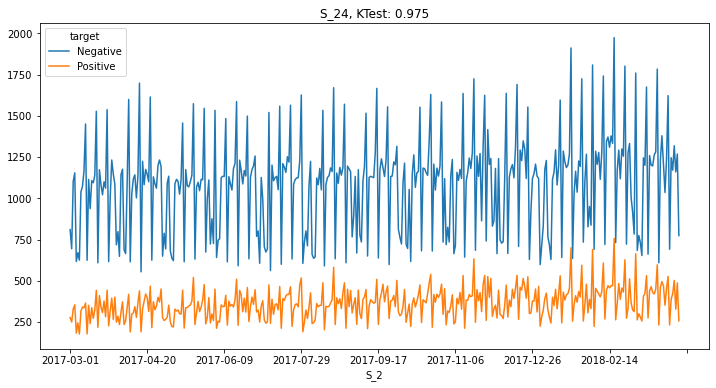

D_130


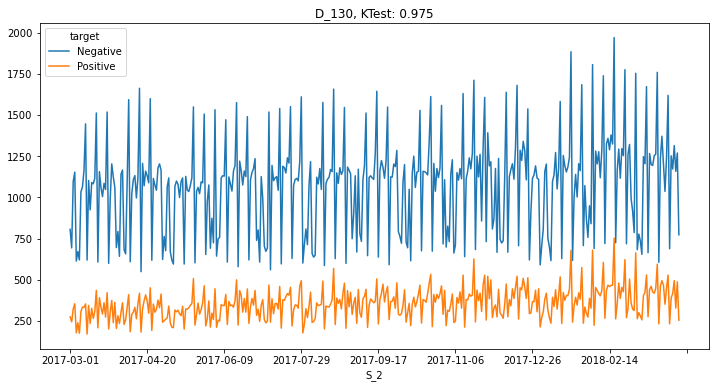

D_62


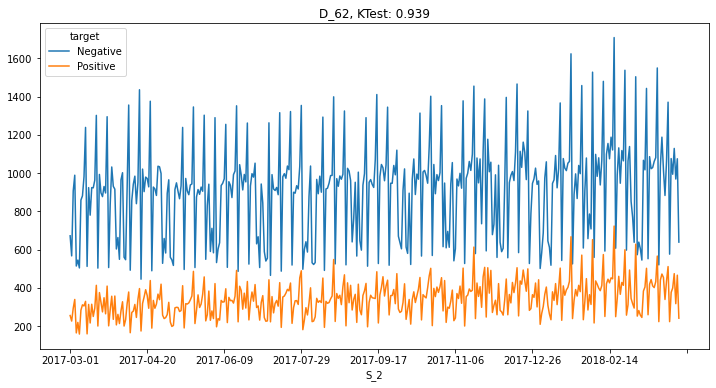

R_14


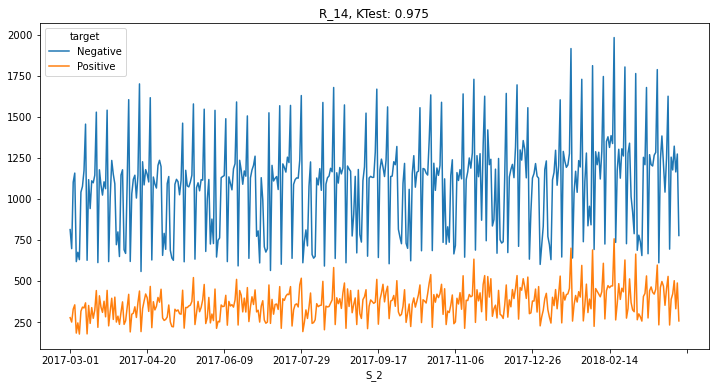

D_76


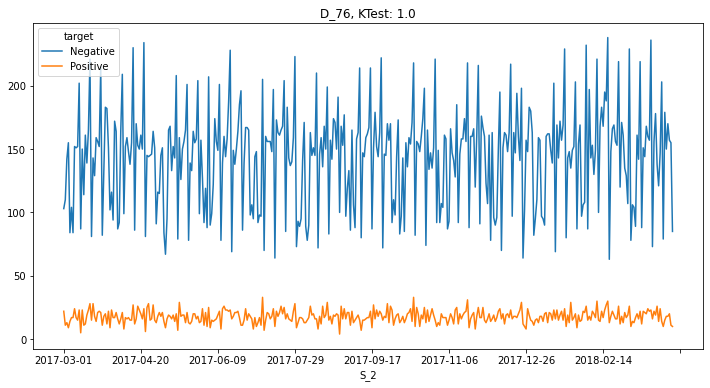

P_2


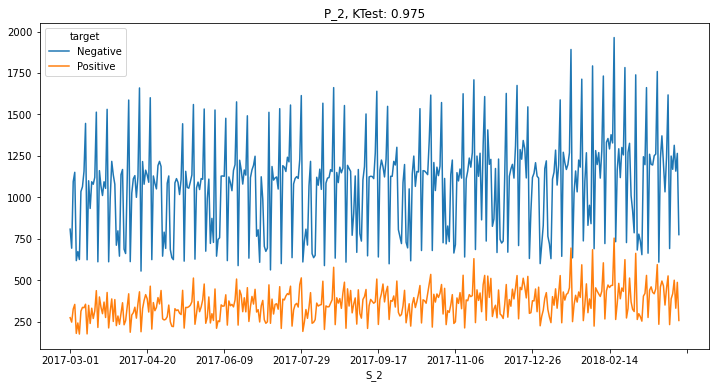

B_15


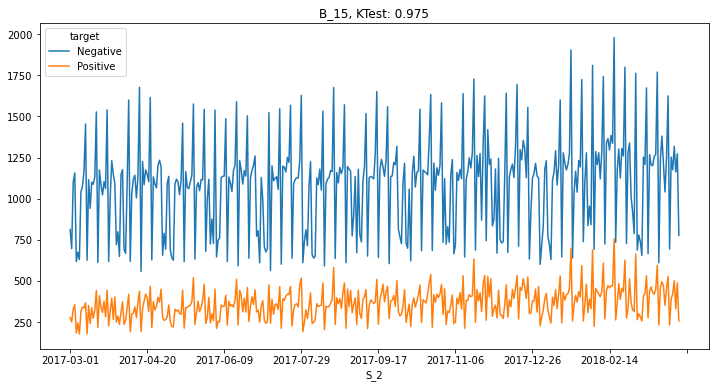

B_33


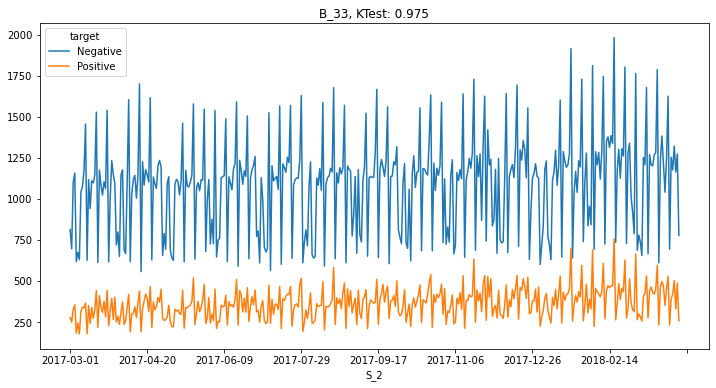

D_53


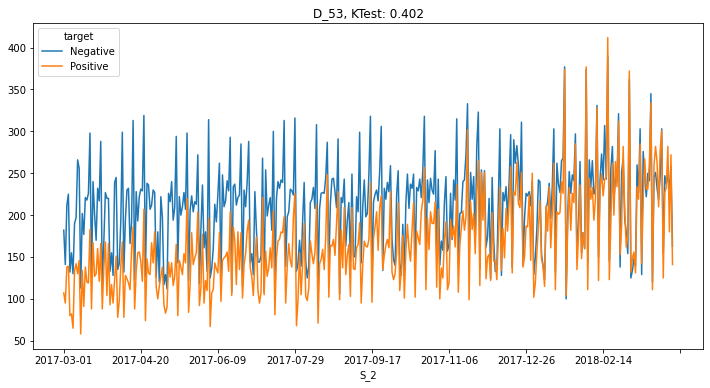

R_3


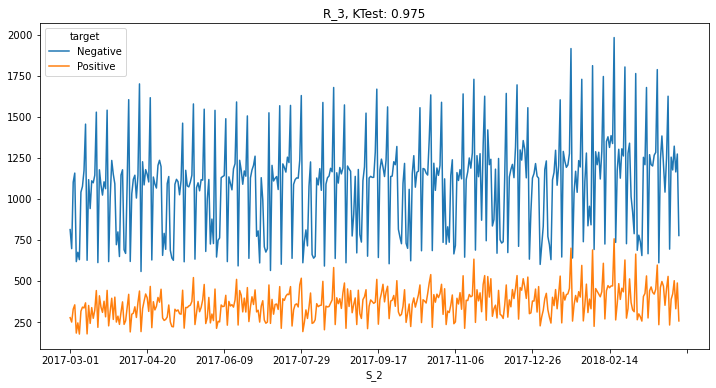

R_4


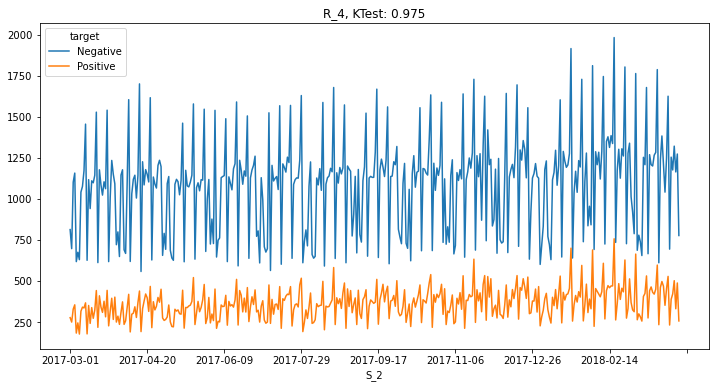

D_127


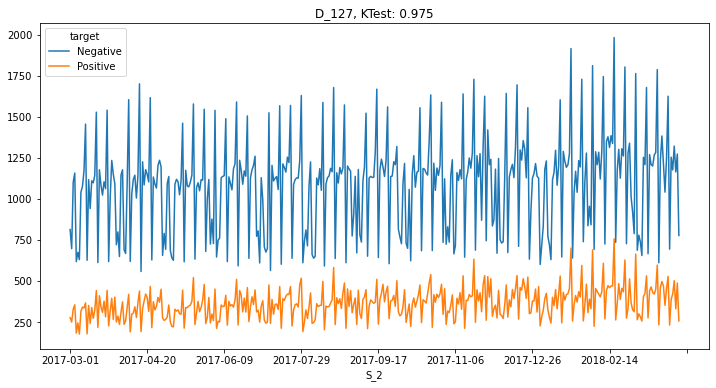

D_124


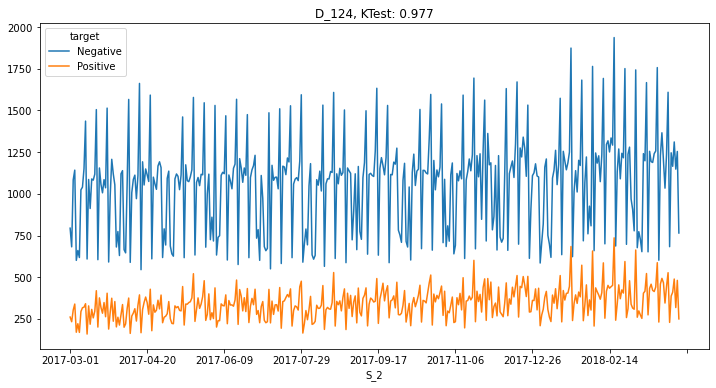

R_7


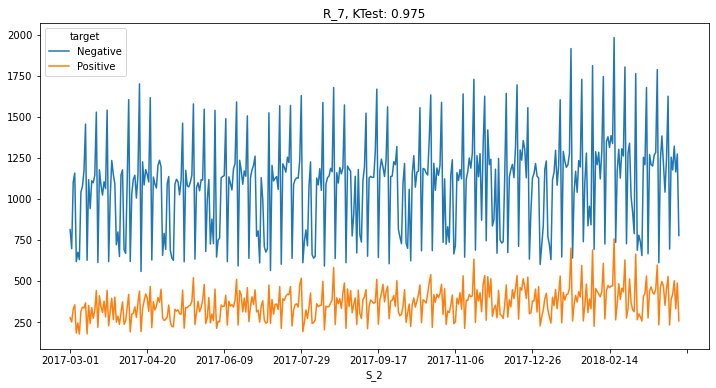

In [11]:
for feature_name in feature_names:
    print(feature_name)
    dt = daily_values_count[feature_name].rename(columns={0:'Negative', 1:'Positive'})
    ks_statistics = np.round(ks_2samp(dt.Positive, dt.Negative).statistic, 3)
    dt.plot(title=f'{feature_name}, KTest: {ks_statistics}', figsize=(12,6))
    plt.show()

In [13]:
list(set([col[0] for col in daily_values_mean.columns]))
#daily_values_mean.columns

['D_111',
 'D_84',
 'B_39',
 'B_9',
 'D_118',
 'D_81',
 'D_103',
 'D_126',
 'D_145',
 'R_2',
 'B_40',
 'D_70',
 'D_71',
 'B_2',
 'D_125',
 'D_112',
 'D_136',
 'D_114',
 'D_102',
 'S_13',
 'D_54',
 'D_87',
 'D_106',
 'D_140',
 'S_5',
 'S_24',
 'B_6',
 'D_56',
 'D_39',
 'D_82',
 'R_19',
 'R_24',
 'S_20',
 'D_131',
 'B_31',
 'D_109',
 'S_9',
 'D_94',
 'R_11',
 'D_116',
 'D_92',
 'P_2',
 'D_122',
 'B_33',
 'D_132',
 'R_20',
 'rank_per_user',
 'D_68',
 'D_88',
 'B_41',
 'D_83',
 'S_25',
 'D_69',
 'D_73',
 'D_130',
 'D_75',
 'D_47',
 'D_50',
 'D_66',
 'D_46',
 'D_53',
 'B_42',
 'D_135',
 'D_76',
 'S_26',
 'R_25',
 'D_123',
 'D_65',
 'B_1',
 'D_62',
 'S_17',
 'B_25',
 'R_10',
 'B_3',
 'D_104',
 'B_24',
 'B_8',
 'B_16',
 'D_120',
 'R_16',
 'S_27',
 'R_8',
 'D_60',
 'R_18',
 'B_19',
 'S_3',
 'B_11',
 'R_12',
 'R_21',
 'B_17',
 'S_16',
 'R_1',
 'B_21',
 'B_38',
 'S_15',
 'R_3',
 'D_78',
 'D_121',
 'B_27',
 'D_128',
 'D_48',
 'D_137',
 'D_143',
 'D_119',
 'R_5',
 'D_138',
 'S_6',
 'D_89',
 'D_141

## Relation between features and target valiables

In [24]:
corr_df = train_df.corr()

<AxesSubplot:>

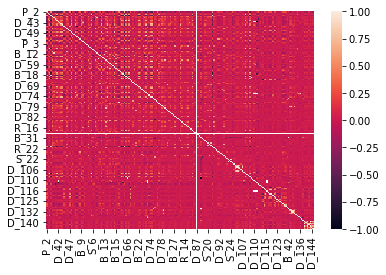

In [25]:
sns.heatmap(corr_df)

# Feature Engineering

## Adding average values of each day

In [41]:
mean_vals_feat_train =train_df.groupby('S_2').mean()
col_mean_val_feats_train = [col+'_mean_dt' for col in mean_vals_feat_train.columns]
mean_vals_feat_train.columns = col_mean_val_feats_train
mean_vals_feat_train = mean_vals_feat_train.reset_index()

NameError: name 'train_df' is not defined

In [32]:
mean_vals_feat_test =test_df.groupby('S_2').mean()
col_mean_val_feats_test = [col+'_mean_dt' for col in mean_vals_feat_test.columns]
mean_vals_feat_test.columns = col_mean_val_feats_test
mean_vals_feat_test = mean_vals_feat_test.reset_index()

In [33]:
mean_vals_feat_test

,S_2,P_2_mean_dt,D_39_mean_dt,B_1_mean_dt,B_2_mean_dt,R_1_mean_dt,S_3_mean_dt,D_41_mean_dt,B_3_mean_dt,D_42_mean_dt,...,D_137_mean_dt,D_138_mean_dt,D_139_mean_dt,D_140_mean_dt,D_141_mean_dt,D_142_mean_dt,D_143_mean_dt,D_144_mean_dt,D_145_mean_dt,rank_per_user_mean_dt
0,2018-04-01,0.650205,0.219875,0.127929,0.683356,0.061748,0.219382,0.038925,0.119094,0.217937,...,0.006196,0.224634,0.140727,0.032547,0.129345,0.397014,0.140825,0.035117,0.049883,12.993103
1,2018-04-02,0.664540,0.231148,0.142853,0.650142,0.059954,0.210028,0.052047,0.137469,0.166653,...,0.040174,0.125577,0.227191,0.034662,0.208383,0.396622,0.227181,0.064588,0.089997,12.994059
2,2018-04-03,0.687432,0.145316,0.109132,0.663048,0.051904,0.199860,0.032921,0.112617,0.169640,...,0.005266,0.124271,0.156184,0.028832,0.143420,0.436316,0.156034,0.044833,0.058873,12.988176
3,2018-04-04,0.659730,0.140519,0.116774,0.627117,0.057883,0.217260,0.050700,0.131826,0.204690,...,0.004435,0.182280,0.179683,0.027361,0.165833,0.403520,0.179755,0.050242,0.063271,12.949669
4,2018-04-05,0.661189,0.195888,0.146700,0.621396,0.059690,0.212709,0.035541,0.143789,0.210176,...,0.004586,0.157730,0.206787,0.018061,0.188808,0.371148,0.206762,0.055495,0.064979,12.984848
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
574,2019-10-27,0.672209,0.261130,0.122493,0.659253,0.099428,0.204286,0.085325,0.140409,0.137508,...,0.004569,0.098476,0.196328,0.032899,0.179321,0.359830,0.196284,0.048723,0.072908,1.000000
575,2019-10-28,0.648516,0.252024,0.119464,0.610167,0.104649,0.206463,0.119715,0.150424,0.148516,...,0.005895,0.106059,0.189626,0.030018,0.175399,0.401313,0.189516,0.058843,0.062068,1.000000
576,2019-10-29,0.666147,0.224831,0.129855,0.611186,0.093995,0.220223,0.094017,0.152781,0.135682,...,0.054439,0.205916,0.166981,0.021580,0.155717,0.449806,0.166787,0.059014,0.056303,1.000000
577,2019-10-30,0.637106,0.206709,0.119420,0.604296,0.114823,0.227113,0.081153,0.144446,0.132623,...,0.004817,0.100794,0.165992,0.020672,0.154155,0.462925,0.165770,0.051116,0.063791,1.000000


## Adding first and average values of each feature

In [14]:
first_feats_train = \
train_merged_df.sort_values(by=['customer_ID','S_2'], ascending=True).drop_duplicates('customer_ID',keep='first')\
.drop(columns=['S_2','target'])

first_feats_train.columns = \
['first_'+col if col != 'customer_ID' else col for col in first_feats_train.columns]

In [15]:
mean_feats_train = \
train_merged_df.groupby('customer_ID').mean().reset_index()\
.drop(columns=['target'])

mean_feats_train.columns = \
['mean'+col if col != 'customer_ID' else col for col in mean_feats_train.columns]

In [16]:
first_feats_test = \
test_df.sort_values(by=['customer_ID','S_2'], ascending=True).drop_duplicates('customer_ID',keep='first')\
.drop(columns=['S_2'])

first_feats_test.columns = \
['first_'+col if col != 'customer_ID' else col for col in first_feats_test.columns]

In [17]:
mean_feats_test = \
test_df.groupby('customer_ID').mean().reset_index()

mean_feats_test.columns = \
['mean'+col if col != 'customer_ID' else col for col in mean_feats_test.columns]

# Build very basic model to predict

In [18]:
#一日分のデータだけをピックアップして、予測を実施する
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, auc, confusion_matrix, roc_auc_score

In [6]:
train_merged_df['S_2'].value_counts()

2018-02-17    2739
2018-01-20    2615
2018-02-03    2500
2018-02-24    2431
2018-03-03    2427
              ... 
2017-03-12     804
2017-07-30     803
2017-03-05     801
2017-08-13     794
2017-04-16     750
Name: S_2, Length: 396, dtype: int64

In [14]:
train_df.groupby('customer_ID').count().describe()

,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_42,...,D_136,D_137,D_138,D_139,D_140,D_141,D_142,D_143,D_144,D_145
count,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,...,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000,47617.000000
mean,12.056954,11.956297,12.056954,12.056954,12.052586,12.056954,9.815255,12.052586,12.052586,1.758028,...,0.427095,0.427095,0.427095,11.839994,11.968352,11.839994,2.074007,11.839994,11.967932,11.839994
std,2.595333,2.779224,2.595333,2.595333,2.603020,2.595333,4.797018,2.603020,2.603020,3.514658,...,1.702080,1.702080,1.702080,2.859501,2.704293,2.859501,4.564100,2.859501,2.704614,2.859501
min,1.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,7.000000,13.000000,13.000000,0.000000,...,0.000000,0.000000,0.000000,13.000000,13.000000,13.000000,0.000000,13.000000,13.000000,13.000000
50%,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,0.000000,...,0.000000,0.000000,0.000000,13.000000,13.000000,13.000000,0.000000,13.000000,13.000000,13.000000
75%,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,1.000000,...,0.000000,0.000000,0.000000,13.000000,13.000000,13.000000,0.000000,13.000000,13.000000,13.000000
max,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,...,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000


In [61]:
train_merged_df.query('rank_per_user == 1')['S_2'].unique()

array(['2018-03-13', '2018-03-25', '2018-03-12', '2018-03-29',
       '2018-03-30', '2018-03-19', '2018-03-23', '2018-03-01',
       '2018-03-16', '2018-03-10', '2018-03-26', '2018-03-28',
       '2018-03-21', '2018-03-27', '2018-03-22', '2018-03-11',
       '2018-03-17', '2018-03-08', '2018-03-02', '2018-03-09',
       '2018-03-24', '2018-03-03', '2018-03-05', '2018-03-15',
       '2018-03-04', '2018-03-07', '2018-03-06', '2018-03-14',
       '2018-03-20', '2018-03-18', '2018-03-31'], dtype=object)

In [19]:
train_merged_last_df = \
train_merged_df.query('rank_per_user == 1').copy()
# train_merged_df.copy()

test_last_df = \
test_df.query('rank_per_user == 1').copy()
# test_df.copy()

In [20]:
train_merged_last_df = train_merged_last_df\
.merge(first_feats_train, on='customer_ID', how='inner')\
.merge(mean_feats_train, on='customer_ID', how='inner')

test_last_df = test_last_df\
.merge(first_feats_test, on='customer_ID', how='inner')\
.merge(mean_feats_test, on='customer_ID', how='inner')

In [97]:
#merging original features to train data and test data
# 精度が下がったので、特徴量から除外
# train_merged_last_df = \
# train_merged_last_df.merge(mean_vals_feat_train, on='S_2', how='inner')

# test_last_df = \
# test_last_df.merge(mean_vals_feat_test, on='S_2', how='inner')

In [98]:
[col for col in train_merged_last_df.columns if 'S_2' in col]

['S_2',
 'S_20',
 'S_22',
 'S_23',
 'S_24',
 'S_25',
 'S_26',
 'S_27',
 'first_S_20',
 'first_S_22',
 'first_S_23',
 'first_S_24',
 'first_S_25',
 'first_S_26',
 'first_S_27',
 'meanS_20',
 'meanS_22',
 'meanS_23',
 'meanS_24',
 'meanS_25',
 'meanS_26',
 'meanS_27']

In [21]:
train_merged_last_df = \
train_merged_last_df.reset_index()

test_last_df = \
test_last_df.reset_index()

In [22]:
le = LabelEncoder()

In [48]:
test_last_df.columns

Index(['index', 'customer_ID', 'S_2', 'P_2', 'D_39', 'B_1', 'B_2', 'R_1',
       'S_3', 'D_41',
       ...
       'meanD_137', 'meanD_138', 'meanD_139', 'meanD_140', 'meanD_141',
       'meanD_142', 'meanD_143', 'meanD_144', 'meanD_145',
       'meanrank_per_user'],
      dtype='object', length=568)

In [23]:
#Label Encoding
label_cols = ['D_63', 'D_64', 'first_D_63', 'first_D_64']
for col in label_cols:
    le = LabelEncoder()
    le.fit(train_merged_last_df[col])
    train_merged_last_df[col] = le.transform(train_merged_last_df[col])
    test_last_df[col] = le.transform(test_last_df[col])

In [24]:
X = train_merged_last_df.drop(columns=['index', 'customer_ID', 'S_2', 'rank_per_user', 'target'])
y = train_merged_last_df['target']

In [25]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3, random_state=10)

In [26]:
X_test = test_last_df.drop(columns=['index', 'customer_ID', 'S_2', 'rank_per_user'])

In [53]:
X.columns[239]

'first_D_63'

In [126]:
X.iloc[:, 239]

0        2
1        1
2        1
3        1
4        1
        ..
47612    2
47613    1
47614    0
47615    1
47616    1
Name: first_D_63, Length: 47617, dtype: int64

In [27]:
model = clf()
model.fit(X_train, y_train)

Learning rate set to 0.121157
0:	learn: 0.5574569	total: 171ms	remaining: 2m 50s
1:	learn: 0.4707301	total: 289ms	remaining: 2m 24s
2:	learn: 0.4069813	total: 413ms	remaining: 2m 17s
3:	learn: 0.3646320	total: 520ms	remaining: 2m 9s
4:	learn: 0.3382128	total: 618ms	remaining: 2m 2s
5:	learn: 0.3182597	total: 715ms	remaining: 1m 58s
6:	learn: 0.3009899	total: 828ms	remaining: 1m 57s
7:	learn: 0.2896654	total: 960ms	remaining: 1m 59s
8:	learn: 0.2813261	total: 1.06s	remaining: 1m 56s
9:	learn: 0.2727962	total: 1.18s	remaining: 1m 56s
10:	learn: 0.2680634	total: 1.28s	remaining: 1m 55s
11:	learn: 0.2641493	total: 1.37s	remaining: 1m 52s
12:	learn: 0.2597519	total: 1.48s	remaining: 1m 52s
13:	learn: 0.2559823	total: 1.6s	remaining: 1m 53s
14:	learn: 0.2533340	total: 1.72s	remaining: 1m 53s
15:	learn: 0.2514619	total: 1.84s	remaining: 1m 53s
16:	learn: 0.2494030	total: 1.97s	remaining: 1m 53s
17:	learn: 0.2476787	total: 2.08s	remaining: 1m 53s
18:	learn: 0.2458563	total: 2.2s	remaining: 1m 

In [28]:
#
predict = model.predict(X_val)
predict_prob = model.predict_proba(X_val)

In [29]:
accuracy_score(y_val, predict)

0.9029155831892732

In [30]:
confusion_matrix(y_val, predict)

array([[95315,  6561],
       [ 6805, 28993]])

In [31]:
roc_auc_score(y_val, predict_prob[:, 1])

0.960875325614748

In [132]:
model.plot_tree(tree_idx=0)

ModuleNotFoundError: No module named 'graphviz'

In [62]:
model.feature_importances_

array([8.04336656e+00, 2.70010627e+00, 8.61469082e-01, 1.21022879e+00,
       1.43687014e+00, 1.48464757e+00, 1.31093598e+00, 1.22429222e+00,
       1.00873813e+00, 2.09958900e+00, 1.49952534e+00, 1.77645514e+00,
       2.24108514e+00, 1.20235372e+00, 1.04910487e+00, 1.13814145e+00,
       1.42209475e+00, 1.85277053e+00, 5.86440061e-01, 7.34710443e-01,
       1.22321229e+00, 4.91123424e-01, 1.12958796e+00, 6.76645123e-01,
       1.47438310e+00, 1.28094820e+00, 8.12377626e-01, 5.46612546e-01,
       4.04604149e-01, 6.88646089e-01, 5.13042375e-01, 2.06087917e+00,
       2.26642301e-01, 5.69810721e-01, 4.62924463e-01, 1.04955878e+00,
       3.27435236e-01, 5.33638812e-01, 7.89164649e-01, 7.75624853e-01,
       4.18735314e-01, 2.51938983e-01, 4.98444238e-01, 3.76514558e-01,
       5.39983228e-01, 5.23307910e-01, 3.44247493e-01, 3.70111055e-01,
       3.95218941e-01, 7.49321327e-01, 9.17421460e-01, 7.93290555e-02,
       1.51951038e-01, 5.28143689e-01, 3.66440634e-01, 5.04049451e-01,
      

In [34]:
train_merged_last_df.dtypes[train_merged_last_df.dtypes == 'object']

D_63    object
D_64    object
dtype: object

### Plotting feature importance

Text(0.5, 1.0, 'Feature Importance')

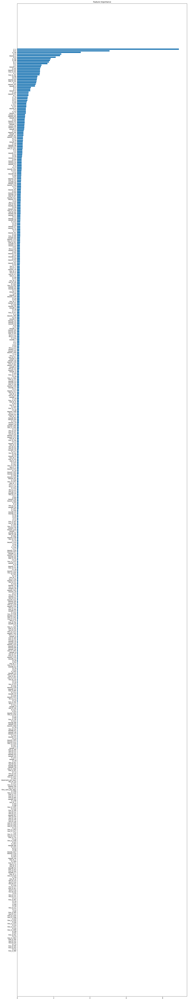

In [32]:
feature_importances = model.feature_importances_
sorted_index = np.argsort(feature_importances)
fig = plt.figure(figsize=(20, 120))
plt.barh(range(len(sorted_index)), feature_importances[sorted_index], align='center')
plt.yticks(range(len(sorted_index)), np.array(X_test.columns)[sorted_index])
plt.title('Feature Importance')

# SHAP value

,index,customer_ID,S_2,P_2,D_39,B_1,B_2,R_1,S_3,D_41,...,meanD_137,meanD_138,meanD_139,meanD_140,meanD_141,meanD_142,meanD_143,meanD_144,meanD_145,meanrank_per_user
0,0,00000469ba478561f23a92a868bd366de6f6527a684c9a...,2019-10-12,0.568930,4,0.010779,1.009347,0.000000,0.149413,0.0,...,-1.0,-1.0,-0.111111,0.0,0.000000,NaN,-0.111111,0.005730,-0.111111,5.0
1,1,00001bf2e77ff879fab36aa4fac689b9ba411dae63ae39...,2019-04-15,0.841177,4,0.016562,1.009245,0.000000,0.112195,0.0,...,-1.0,-1.0,0.000000,0.0,0.000000,NaN,0.000000,0.005329,0.000000,7.0
2,2,0000210045da4f81e5f122c6bde5c2a617d03eef67f82c...,2019-10-16,0.697522,0,0.001484,0.810072,0.000000,0.166165,0.0,...,-1.0,-1.0,1.000000,0.0,0.887847,0.128100,1.000000,0.387283,1.000000,7.0
3,3,00003b41e58ede33b8daf61ab56d9952f17c9ad1c3976c...,2019-04-22,0.513186,11,0.149511,0.205678,0.000000,0.181200,0.0,...,-1.0,-1.0,1.000000,0.0,0.909851,0.233945,1.000000,0.439592,2.000000,7.0
4,4,00004b22eaeeeb0ec976890c1d9bfc14fd9427e98c4ee9...,2019-10-22,0.254478,26,0.563603,0.038021,0.503154,0.168317,0.0,...,-1.0,-1.0,0.000000,0.0,0.000000,NaN,0.000000,0.004425,0.000000,7.0


In [33]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

KeyboardInterrupt: 

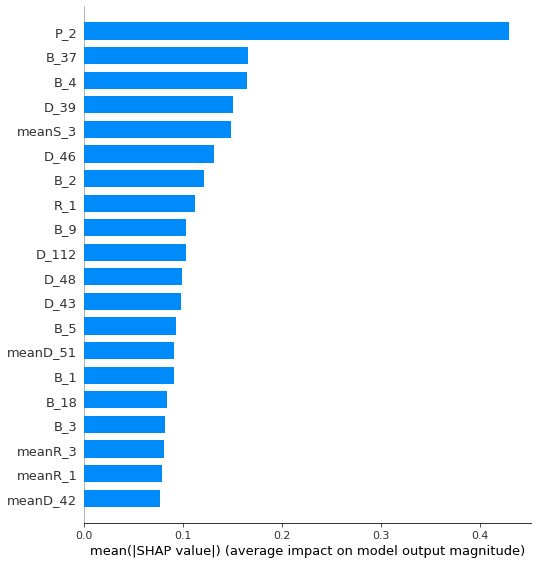

In [136]:
shap.summary_plot(shap_values, X_test, plot_type='bar')

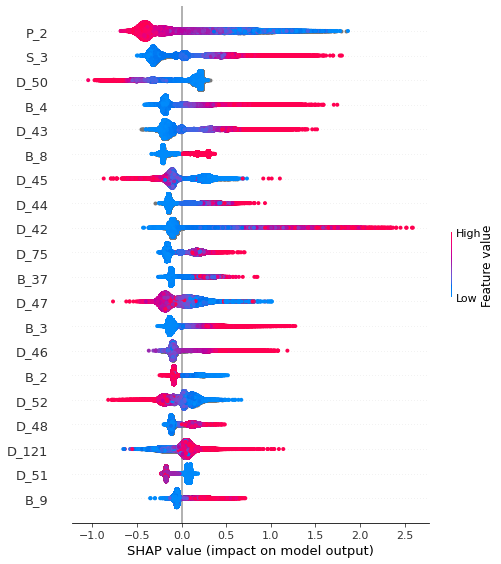

In [83]:
shap.summary_plot(shap_values, X_test, plot_type='dot')

# Cross Validation

In [137]:
from sklearn.model_selection import StratifiedKFold
kfold = StratifiedKFold(n_splits=10).split(X_train, y_train)
scores = []

for k, (train, test) in enumerate(kfold):
    model.fit(X_train.iloc[train], y_train.iloc[train])
    score = model.score(X_train.iloc[test], y_train.iloc[test])
    scores.append(score)
    print(f'Fold:{k+1}, Class dist:{np.bincount(y_train.iloc[train])}, {score}')

Learning rate set to 0.04402
0:	learn: 0.6399118	total: 31ms	remaining: 30.9s
1:	learn: 0.5945956	total: 57.7ms	remaining: 28.8s
2:	learn: 0.5587054	total: 95.1ms	remaining: 31.6s
3:	learn: 0.5237303	total: 120ms	remaining: 30s
4:	learn: 0.4922026	total: 151ms	remaining: 30.1s
5:	learn: 0.4677239	total: 183ms	remaining: 30.3s
6:	learn: 0.4485152	total: 211ms	remaining: 29.9s
7:	learn: 0.4297520	total: 245ms	remaining: 30.4s
8:	learn: 0.4101464	total: 278ms	remaining: 30.7s
9:	learn: 0.3950412	total: 319ms	remaining: 31.6s
10:	learn: 0.3827652	total: 346ms	remaining: 31.1s
11:	learn: 0.3699091	total: 380ms	remaining: 31.2s
12:	learn: 0.3590588	total: 413ms	remaining: 31.4s
13:	learn: 0.3506710	total: 446ms	remaining: 31.4s
14:	learn: 0.3423271	total: 478ms	remaining: 31.4s
15:	learn: 0.3353525	total: 518ms	remaining: 31.8s
16:	learn: 0.3286273	total: 544ms	remaining: 31.5s
17:	learn: 0.3208395	total: 574ms	remaining: 31.3s
18:	learn: 0.3157721	total: 604ms	remaining: 31.2s
19:	learn: 0.

# Parameter Tuning

In [ ]:
# 

# Submit

In [34]:
y_submit_pred = model.predict(X_test)

In [35]:
y_submit_pred

array([0, 0, 0, ..., 0, 0, 0])

In [36]:
submit_df = test_last_df[['customer_ID']].copy()

In [37]:
submit_df['prediction'] = y_submit_pred

In [38]:
submit_df.to_csv('20220621_amex_01.csv', index=False)

In [72]:
sample_submission_df['customer_ID'].nunique()

924621

In [73]:
test_df['customer_ID'].nunique()

45343

In [74]:
train_df['customer_ID'].nunique()

47617

In [39]:
submit_df

,customer_ID,prediction
0,00000469ba478561f23a92a868bd366de6f6527a684c9a...,0
1,00001bf2e77ff879fab36aa4fac689b9ba411dae63ae39...,0
2,0000210045da4f81e5f122c6bde5c2a617d03eef67f82c...,0
3,00003b41e58ede33b8daf61ab56d9952f17c9ad1c3976c...,0
4,00004b22eaeeeb0ec976890c1d9bfc14fd9427e98c4ee9...,1
...,...,...
924616,ffff952c631f2c911b8a2a8ca56ea6e656309a83d2f64c...,0
924617,ffffcf5df59e5e0bba2a5ac4578a34e2b5aa64a1546cd3...,1
924618,ffffd61f098cc056dbd7d2a21380c4804bbfe60856f475...,0
924619,ffffddef1fc3643ea179c93245b68dca0f36941cd83977...,0
